In [1]:
import matplotlib.pyplot as plt
from monolayer_tracking.segmented_comprehension import Image, Stack
import numpy as np
import cv2
from tqdm.notebook import tqdm
from scipy import ndimage
from monolayer_tracking import preprocessing
import pandas as pd

plt.style.use('dark_background')

# ML FUCCI thresholding

In [14]:
from natsort import natsorted
from glob import glob
files=natsorted(glob('F:/my_data/Segmentation/20240311 FUCCI halo sorted col_glass high_density/segmented/FUCCI-stage_*/'))

In [2]:
stack=Stack('F:/my_data/Segmentation/20240322 FUCCI halo sort1 col_glass colonies/segmented', progress_bar=tqdm)

  0%|          | 0/116 [00:00<?, ?it/s]

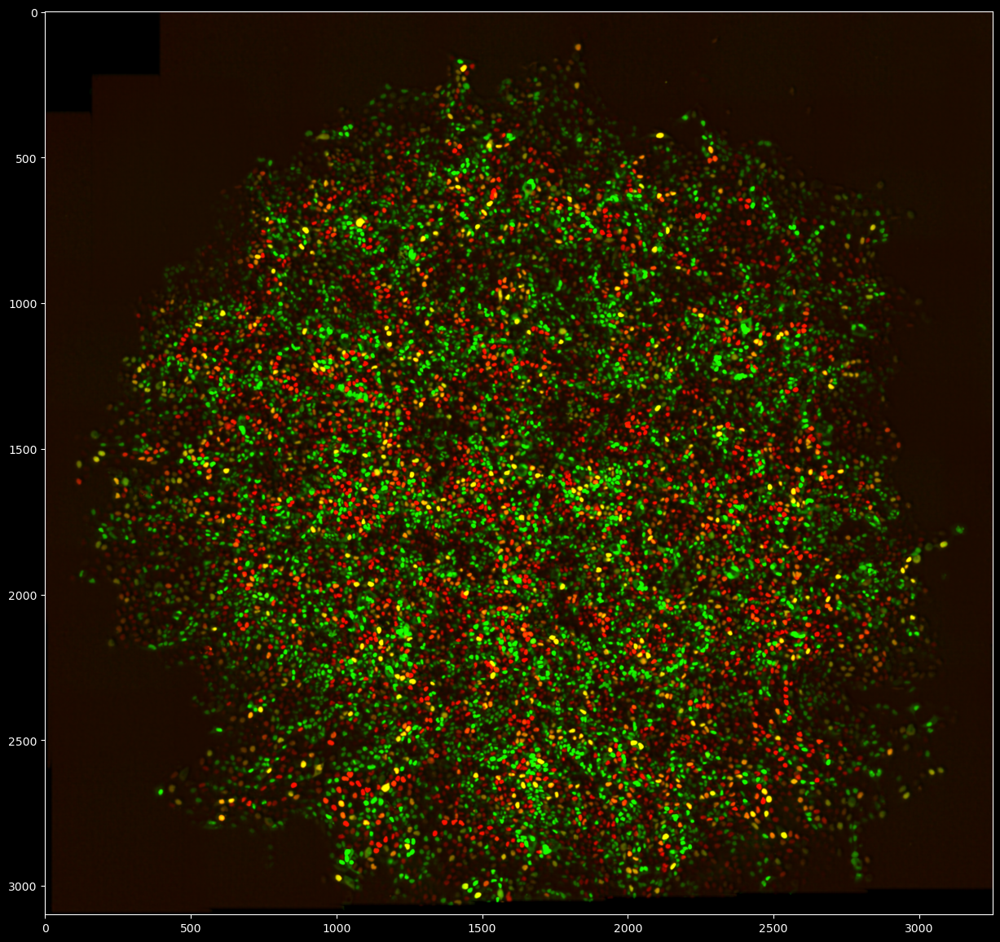

In [5]:
frame_number=100
plt.figure(figsize=(15,15))
color_FUCCI=np.stack([stack.frames[frame_number].FUCCI[0], stack.frames[frame_number].FUCCI[1], np.zeros_like(stack.frames[frame_number].FUCCI[0])], axis=-1)
plt.imshow(color_FUCCI)

In [38]:
def measure_FUCCI(self, percent_threshold=0.15, red_fluor_threshold=0.2, green_fluor_threshold=0.2, threshold_offset=0, noise_score=None):
    """
    Measure the FUCCI (Fluorescence Ubiquitination Cell Cycle Indicator) levels in cells.

    Args:
        use_masks (bool): If True, use masks for measurements.
        percent_threshold (float): Threshold for percentage comparison.
        red_fluor_threshold (float): Threshold for red fluorescence.
        green_fluor_threshold (float): Threshold for green fluorescence.

    Returns:
        tuple: Red fluorescence percentages, Green fluorescence percentages.
    """
    # Ensure FUCCI data is available
    if not hasattr(self, 'FUCCI'):  # Check if FUCCI data exists
        raise AttributeError('use FUCCI_preprocess.ipynb to generate FUCCI data first')
    nuclear_size_threshold=np.median(self.cell_areas(scaled=False))*percent_threshold
    red, green = self.FUCCI
    
    # threshold fluorescence levels
    red_fluor_threshold=preprocessing.get_fluor_threshold(red, nuclear_size_threshold, noise_score=noise_score)+threshold_offset
    green_fluor_threshold=preprocessing.get_fluor_threshold(green, nuclear_size_threshold, noise_score=noise_score)+threshold_offset
    thresholded_green=green>green_fluor_threshold
    thresholded_red=red>red_fluor_threshold
    thresholded_orange=thresholded_red&thresholded_green

    fluor_percentages=np.stack([preprocessing.fluorescent_percentages(self, thresholded_green),
                                preprocessing.fluorescent_percentages(self, thresholded_red),
                                preprocessing.fluorescent_percentages(self, thresholded_orange)], axis=1)

    fluor_nuclei=fluor_percentages>percent_threshold
    fluor_nuclei[fluor_nuclei[:,2], :2]=0 # wherever cells are orange, turn off red and green

    red_or_green=fluor_nuclei[:,0]&fluor_nuclei[:,1]
    fluor_nuclei[red_or_green, np.argmin(fluor_percentages[red_or_green,:2], axis=1)]=0 # if not orange, pick red or green based on which has a higher percentage
    cc_stage_number=np.argmax(fluor_nuclei, axis=1)+1 # G1->1, S->2, G2->3
    cc_stage_number[np.sum(fluor_nuclei, axis=1)==0]=0 # no signal->0
    for cell, cycle_stage in zip(self.cells, cc_stage_number):
        cell.cycle_stage=cycle_stage
    return cc_stage_number

In [10]:
import importlib
preprocessing=importlib.reload(preprocessing)

In [43]:
from matplotlib.patches import Polygon
from matplotlib.collections import PatchCollection
import matplotlib.patheffects as patheffects

def FUCCI_overlay(frame, imshow=True, ax=None, show_denoised=True, show_labels=False, alpha=0.2):
    if not ax: ax=plt.gca()
    if imshow:
        if show_denoised:
            color_FUCCI=np.stack([frame.FUCCI[0], frame.FUCCI[1], np.zeros(frame.masks.shape, dtype=int)], axis=-1)
        else:
            if not hasattr(frame, 'img'):
                frame.load_img()
            color_FUCCI=np.stack([frame.img[...,0], frame.img[...,1], np.zeros(frame.masks.shape, dtype=int)], axis=-1)
            color_FUCCI=preprocessing.normalize(color_FUCCI)
        plt.imshow(color_FUCCI)
    else:
        plt.xlim(0,frame.masks.shape[1])
        plt.ylim(frame.masks.shape[0],0)

    if show_labels:
        frame.get_centroids()

    cell_overlays=[]
    colors={0:'none', 1:'lime', 2:'r', 3:'orange'}
    for cell in frame.cells:
        
        cell_overlays.append(Polygon(cell.outline, ec='white', fc=colors[cell.cycle_stage], linewidth=1, alpha=alpha))

        if show_labels:
            particle_label=plt.text(cell.centroid[1],cell.centroid[0],s=cell.n, color='white', fontsize=6)
            particle_label.set_path_effects([patheffects.Stroke(linewidth=1, foreground=colors[cell.cycle_stage]),patheffects.Normal()])

    ax.add_artist(PatchCollection(cell_overlays, match_original=True))
    plt.axis('off')

In [55]:
frame=stack.frames[0]
measure_FUCCI(frame, percent_threshold=0.15, noise_score=0.01, threshold_offset=-35)

32 33


array([0, 0, 0, ..., 2, 3, 0], dtype=int64)

In [57]:
for frame in tqdm(stack.frames):
    measure_FUCCI(frame, percent_threshold=0.15, noise_score=0.01, threshold_offset=-35)

  0%|          | 0/116 [00:00<?, ?it/s]

37 38
31 35
34 40
32 38
28 40
32 39
31 34
32 39
32 39
31 35
36 36
33 30
28 30
31 28
30 35
30 36
32 36
30 34
26 30
27 34
24 31
28 34
24 29
24 32
30 36
24 28
25 36
28 35
28 32
27 30
22 33
24 33
27 33
29 34
32 34
31 36
30 28
24 34
27 33
27 29
26 31
25 30
21 30
25 30
22 27
21 25
27 30
20 29
25 28
27 32
26 32
24 28
21 27
23 24
23 31
24 28
24 28
24 33
19 29
17 27
13 33
19 29
18 24
18 32
22 30
23 28
19 29
18 26
21 29
19 30
24 28
21 30
25 32
24 28
22 28
21 28
21 33
18 29
19 30
20 29
17 31
18 30
19 29
20 31
19 26
21 31
20 28
19 29
20 29
19 28
16 28
19 29
15 32
14 31
17 32
17 32
14 31
15 30
16 28
19 30
14 31
17 32
14 32
14 30
15 31
13 30
14 27
20 31
20 29
15 30
14 28
13 29
18 30
20 27
18 28
22 29


(2000.0, 1000.0)

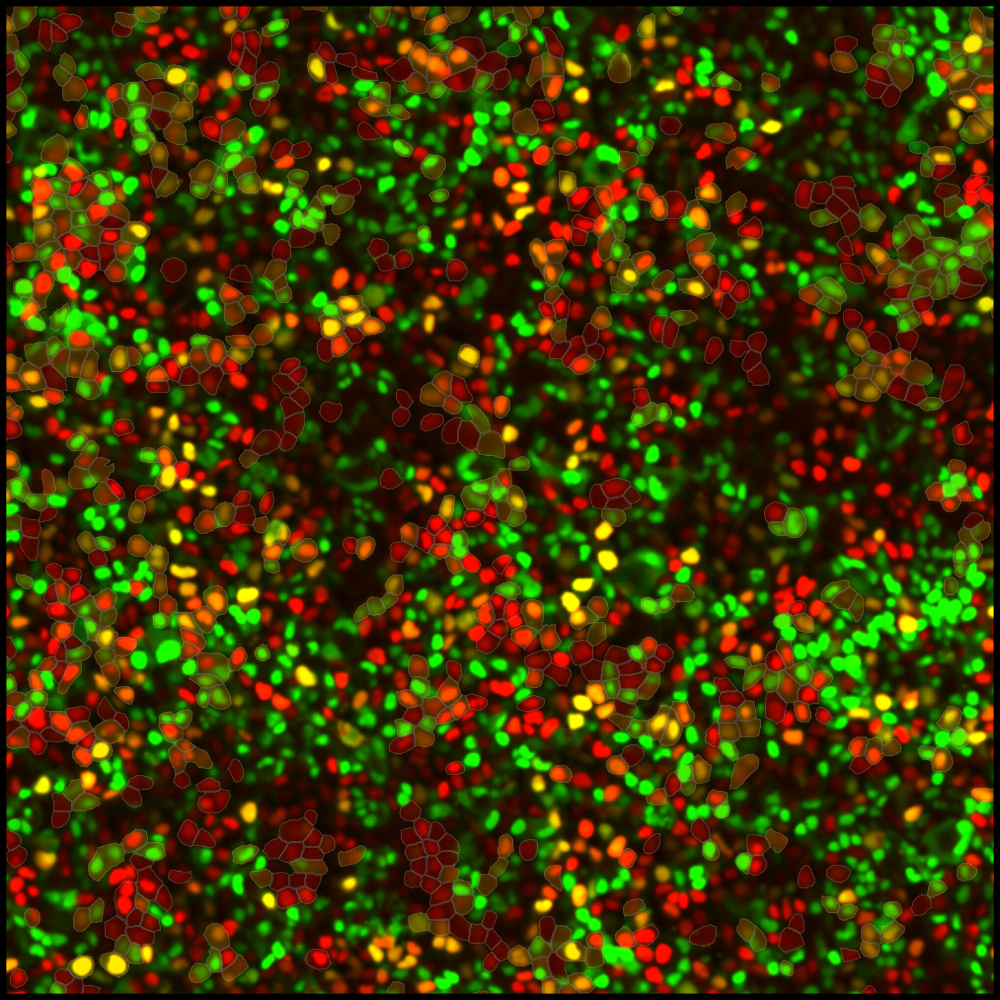

In [58]:
plt.figure(figsize=(20,20))
FUCCI_overlay(frame)
plt.xlim(1000,2000)
plt.ylim(2000,1000)

In [18]:
nuclear_size_threshold=np.median(frame.cell_areas(scaled=False))*0.15
nuclear_size_threshold

66.14999999999999

In [24]:
preprocessing.get_fluor_threshold(frame.FUCCI[1], nuclear_size_threshold, noise_score=0)

73

In [29]:
def nuclear_threshold_loss(threshold, img, size_threshold, noise_score=0.02):
    labels, n_features=ndimage.label(img>threshold)
    n_nuclei=np.sum(np.unique(labels, return_counts=True)[1][1:]>size_threshold)
    return -(n_nuclei-noise_score*n_features)

In [31]:
scores=[nuclear_threshold_loss(threshold, frame.FUCCI[1], nuclear_size_threshold, noise_score=0) for threshold in tqdm(np.arange(0, 255, 1))]

  0%|          | 0/255 [00:00<?, ?it/s]

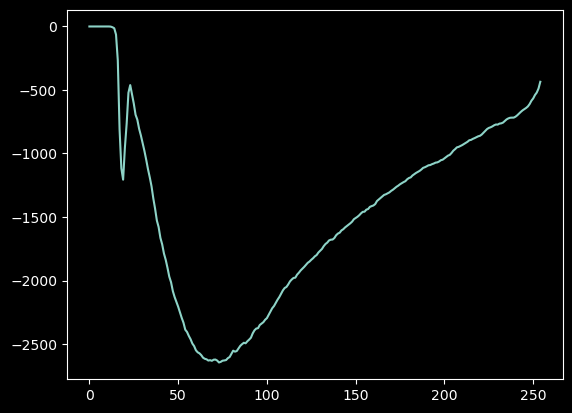

In [32]:
plt.plot(scores)

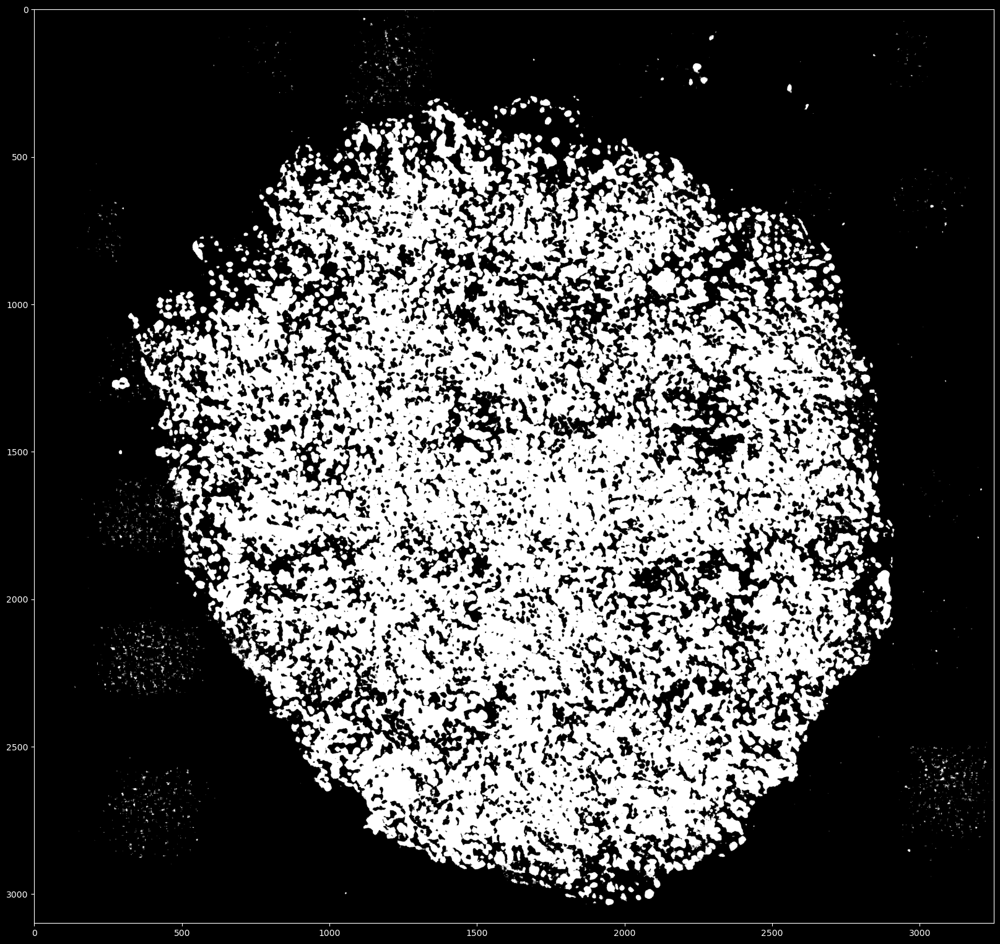

In [28]:
plt.figure(figsize=(20,20))
plt.imshow(frame.FUCCI[1]>23, cmap='gray')

# Linking over time (actual determination of cell cycle stage)

allowed moves are green->red, red->orange.

In [2]:
from natsort import natsorted
from glob import glob

files=natsorted(glob(r'F:\my_data\Segmentation\20240311 FUCCI halo sorted col_glass high_density\segmented\*'))
FUCCI_dataset=[Stack(file) for file in tqdm(files)]

  0%|          | 0/20 [00:00<?, ?it/s]

In [3]:
for stack in FUCCI_dataset:
    stack.frames=stack.frames[:293]

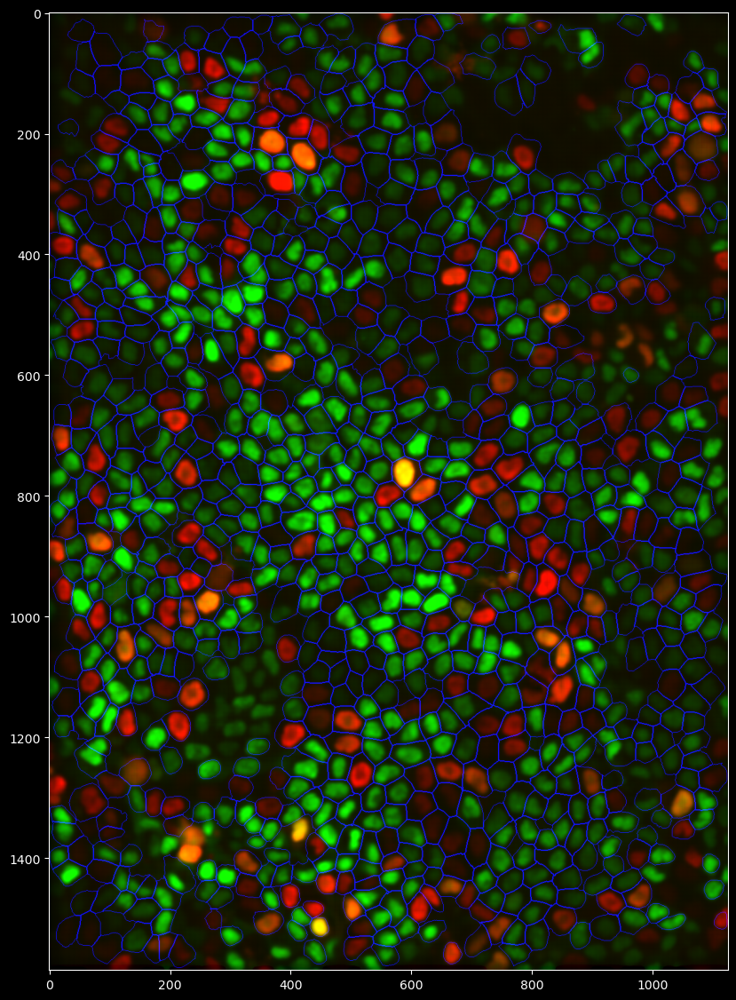

In [19]:
frame=stack.frames[200]
color_FUCCI=np.array([frame.FUCCI[0], frame.FUCCI[1], frame.outlines.todense()!=0]).transpose(1,2,0)

plt.figure(figsize=(10,14))
plt.imshow(preprocessing.normalize(color_FUCCI, np.quantile(0.01,0.99)))

In [59]:
def impute_fill(cell_cycle, limit=6):
    cell_cycle=cell_cycle.replace(0,np.nan).ffill(limit=limit)
    cell_cycle=cell_cycle.bfill(limit=limit).fillna(0).astype(int)
    return cell_cycle

def smooth_small_flickers(cell_cycle):
    oneHot_cc=pd.get_dummies(cell_cycle)
    smoothed_cc=np.nansum([oneHot_cc.shift(-1), oneHot_cc, oneHot_cc.shift(1)], axis=0)/3
    smoothed_cc[[0,-1]]*=3/2
    cell_cycle=oneHot_cc.columns[np.argmax(smoothed_cc, axis=1)]
    return pd.Series(cell_cycle)

def get_transitions(cell_cycle):
    is_transition=[True,*(np.diff(cell_cycle)!=0)]
    stages=cell_cycle.reset_index(drop=True)[is_transition]
    stage_lengths=cell_cycle.groupby(np.cumsum(is_transition)).size()
    return stages, stage_lengths

def correct_mother_G2(cell_cycle):
    stages, stage_lengths=get_transitions(cell_cycle)
    if np.array_equal(stages[-2:], [3,2]):
        last_stage_length=stage_lengths.iloc[-1]
        if last_stage_length<=6: # if it's red for longer than an hour, probably not a mitosis thing
            cell_cycle[-last_stage_length:]=3 # correct to G2
    return cell_cycle

def correct_daughter_G1(cell_cycle):
    stages, stage_lengths=get_transitions(cell_cycle.replace(2,3)) # get transitions, with S and G2 grouped into one stage
    if np.array_equal(stages[:2], [3,1]): # check for transitions from S/G2 -> G1 immediately after cell shows up
        first_stage_length=stage_lengths.iloc[0]
        if first_stage_length>=4: # if it's red for longer than an hour, probably not a mitosis thing
            cell_cycle[:first_stage_length]=1 # correct to G2
    return cell_cycle

def subsequence(seq, subseq):
    '''Returns list of indices where the subsequence is found in the sequence (indexed first element). If not found, returns an empty list.'''
    seq_length=len(seq)
    subseq_length=len(subseq)
    return np.array([x for x in range(seq_length-subseq_length+1) if np.array_equal(seq[x:x+len(subseq)], subseq)])
    
def remove_sandwich_flicker(cell_cycle, transition):
    corrected=False
    stages, stage_lengths=get_transitions(cell_cycle)
    flickers=subsequence(stages, transition)

    for flicker in flickers:
        outer_length=stage_lengths.iloc[[flicker,flicker+2]].sum()
        inner_length=stage_lengths.iloc[flicker+1]
        if outer_length>inner_length:
            false_start, false_end=stages.index[flicker+1:flicker+3]
            cell_cycle[false_start:false_end]=transition[-1] # correct to outer value
            corrected=True

    if corrected: # made a correction, should check if there's something new that can be fixed
        cell_cycle=remove_sandwich_flicker(cell_cycle, transition)

    return cell_cycle

# find FUCCI info that doesn't make sense over time
def get_problematic_IDs(trajectories):
    problematic_IDs=[]
    for particle_ID, cc_stage in trajectories.groupby('particle')['cell_cycle']:
        cc_transitions=np.diff(cc_stage)
        if np.any(~((cc_transitions==0)|(cc_transitions==1))): # a transition that's not G1->S or S->G2
            problematic_IDs.append(particle_ID)

    return(problematic_IDs)

def fetch_cell_cycle(frame):
    return get_cell_attr(frame, 'cycle_stage')

def write_cell_cycle(frame, cell_cycle_stages):
    set_cell_attr(frame, 'cycle_stage', cell_cycle_stages)

def get_interpretable_FUCCI(stack, zero_remainder=True, impute_zeros=True):
    t=stack.track_centroids(filter_stubs=False).sort_values(['frame', 'cell_number'])
    t['cell_cycle']=np.concatenate([fetch_cell_cycle(frame) for frame in stack.frames])

    for ID in get_problematic_IDs(t): 
        cell_cycle=t.loc[t.particle==ID,'cell_cycle'].copy()

        if impute_zeros:
            # simple fix: extend existing data into any zero regions
            cell_cycle=impute_fill(cell_cycle, limit=6)
        
        # simple fix: smooth single-frame flickers by neighbor values
        cell_cycle=smooth_small_flickers(cell_cycle)

        # manual check: if a cell briefly goes red after G2 and then vanishes, it's just a byproduct of changes before mitosis
        cell_cycle=correct_mother_G2(cell_cycle)

        # manual check: similarly, if a cell starts out orange or red and then goes green, it's just vestigial fluorescence from mitosis.
        cell_cycle=correct_daughter_G1(cell_cycle)
        
        # manual check: if a cell goes from one phase to another and back, it's probably spurious (especially if out of temporal order).
        # the order of these checks matters (especially 3,2,3 then 2,3,2) because lots of cells will flicker and which check goes first determines who wins. Sorted by descending observed frequency
        cell_cycle=remove_sandwich_flicker(cell_cycle, [1,3,1]) # G1 jumps to G2
        cell_cycle=remove_sandwich_flicker(cell_cycle, [3,2,3]) # G2 back to S. This happens all the time because green creeps into red
        cell_cycle=remove_sandwich_flicker(cell_cycle, [1,3,2]) # G1 to S *through* G2. This is also likely because red replaces green
        cell_cycle=remove_sandwich_flicker(cell_cycle, [1,0,2]) # G1 to S through NS. This is also likely because red replaces green

        cell_cycle=remove_sandwich_flicker(cell_cycle, [2,3,2])

        t.loc[t.particle==ID,'cell_cycle']=np.array(cell_cycle)

    if zero_remainder:
        for ID in get_problematic_IDs(t):
            t.loc[t.particle==ID,'cell_cycle']=0 # remove any FUCCI data that still doesn't make sense

    for frame_number, cell_cycle_stages in t.groupby('frame')['cell_cycle']:
        write_cell_cycle(stack.frames[frame_number], cell_cycle_stages)

    stack.tracked_centroids['cell_cycle']=t['cell_cycle'] # also export cell cycle info to tracking
        
    return t


def get_cell_attr(self, attributes):
    ret=[]
    for cell in self.cells:
        if isinstance(attributes, str):
            try:
                ret.append(getattr(cell, attributes))
            except AttributeError:
                raise AttributeError(f'Cell {cell.n} does not have attribute {attributes}')
        else:
            cell_attrs=[]
            for attribute in attributes:
                try:
                    cell_attrs.append(getattr(cell, attribute))
                except AttributeError:
                    raise AttributeError(f'Cell {cell.n} does not have attribute {attribute}')
            ret.append(cell_attrs)
    return ret

def set_cell_attr(self, attributes, values):
    for cell, value in zip(self.cells, values):
        if isinstance(attributes, str):
            setattr(cell, attributes, value)
        else:
            for attribute, val in zip(attributes, value):
                setattr(cell, attribute, val)

In [37]:
for stack in tqdm(FUCCI_dataset):
    for frame in tqdm(stack.frames, leave=False):
        measure_FUCCI(frame)

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/293 [00:00<?, ?it/s]

  0%|          | 0/293 [00:00<?, ?it/s]

  0%|          | 0/293 [00:00<?, ?it/s]

  0%|          | 0/293 [00:00<?, ?it/s]

  0%|          | 0/293 [00:00<?, ?it/s]

  0%|          | 0/293 [00:00<?, ?it/s]

  0%|          | 0/293 [00:00<?, ?it/s]

  0%|          | 0/293 [00:00<?, ?it/s]

  0%|          | 0/293 [00:00<?, ?it/s]

  0%|          | 0/293 [00:00<?, ?it/s]

  0%|          | 0/293 [00:00<?, ?it/s]

  0%|          | 0/293 [00:00<?, ?it/s]

  0%|          | 0/293 [00:00<?, ?it/s]

  0%|          | 0/293 [00:00<?, ?it/s]

  0%|          | 0/293 [00:00<?, ?it/s]

  0%|          | 0/293 [00:00<?, ?it/s]

  0%|          | 0/293 [00:00<?, ?it/s]

  0%|          | 0/293 [00:00<?, ?it/s]

  0%|          | 0/293 [00:00<?, ?it/s]

  0%|          | 0/293 [00:00<?, ?it/s]

In [61]:
get_interpretable_FUCCI(stack)

,cell_number,y,x,frame,particle,cell_cycle
0,0,124.573661,824.484375,0,0,0
4,1,294.616228,1637.780702,0,4,0
5,2,324.413991,1390.813073,0,5,0
6,3,343.106557,1627.214605,0,6,1
7,4,335.992157,1368.924706,0,7,3
...,...,...,...,...,...,...
828971,7225,3017.725223,2047.824686,115,71477,2
828972,7226,3027.727437,1521.661274,115,63765,0
828947,7227,3033.532785,1674.803976,115,72739,3
821747,7228,3036.707371,2021.862967,115,68536,3


In [60]:
for stack in tqdm(FUCCI_dataset):
    get_interpretable_FUCCI(stack)

NameError: name 'FUCCI_dataset' is not defined

In [20]:
problematic_particles=[]
problematic_IDs=[]
for particle_number in tqdm(np.unique(t.particle)):
    particle=stack.get_particle(particle_number)
    cell_cycle=[]
    for cell_frame in particle:
        cell_cycle.append([cell_frame.green, cell_frame.red, cell_frame.orange])
    cell_cycle=np.argmax(cell_cycle, axis=1)
    if not np.all(cell_cycle[1:]>=cell_cycle[:-1]):
        problematic_particles.append(particle)
        problematic_IDs.append(particle_number)

#317: real S->G2
#1820: flickering G1 (looks like G2)
#1630: G1 -> S through G2

NameError: name 't' is not defined

In [500]:
cell_cycle=[]
frames=[]

for cell_frame in problematic_particles[0]:
    #print(cell_frame.frame, cell_frame.n)
    frames.append(cell_frame.frame)
    cell_cycle.append([cell_frame.green, cell_frame.red, cell_frame.orange])

cell_cycle=np.array(cell_cycle)
cell_cycle_stage=np.argmax(cell_cycle, axis=1)
problematic_frames=np.where(cell_cycle_stage[1:]<cell_cycle_stage[:-1])[0]+1 # this only catches the moment of faulty transition. Want a comparison to the rolling maximum?

In [509]:
for cell in stack.get_particle(stack.frames[58].cells[629]):
    print(cell.frame, cell.n)

28 606
29 587
30 608
31 597
32 599
33 599
34 590
35 611
36 613
37 617
38 630
39 608
41 624
42 622
43 636
44 634
45 627
46 644
47 619
48 627
50 629
51 633
52 608
53 625
54 619
55 628
56 623
57 632
58 629
59 621
60 623
61 634
62 630
63 621
64 610
65 624
68 624
69 631
70 643
72 645
74 640
75 644
76 642


In [512]:
stack.frames[59].cells[621].green

True

In [507]:
np.sum(problematic_IDs==1898)

0

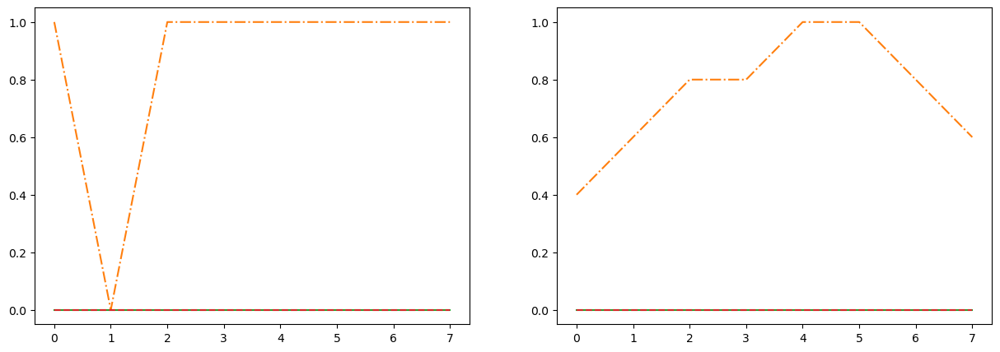

In [501]:
from scipy.signal import convolve2d
fig, axes = plt.subplots(1,2, figsize=(15,5))
kernel_width=5
smoothed=convolve2d(cell_cycle, np.ones((kernel_width,1))/kernel_width, mode='same')

axes[0].plot(cell_cycle.T[0], color='C2')
axes[0].plot(cell_cycle.T[1], '-.', color='C1')
axes[0].plot(cell_cycle.T[2], '--', color='C3')

axes[1].plot(smoothed.T[0], color='C2')
axes[1].plot(smoothed.T[1], '-.', color='C1')
axes[1].plot(smoothed.T[2], '--', color='C3')

In [484]:
for cell in problematic_particles[1]:
    print(cell.frame, cell.n)

0 23
1 27
2 25
3 25
4 28
5 28
6 29
7 26
8 25
9 29
10 31
11 28
12 32
13 31
14 29
15 27
16 29
17 28
18 26
19 26
20 26
21 26
22 26
23 24
24 19
25 19
26 13
27 18
28 12
29 8
30 5
31 4
32 6
33 6
34 5


In [482]:
import pandas as pd
pd.concat(stack.mitoses).index.get_level_values(0)

Int64Index([ 373, 1140, 1142,   66, 1252, 1259,  453, 1554, 1555,  334, 1669,
            1670,  423, 1673, 1674, 1260, 1764, 1767,  237, 1841, 1842, 1634,
            1835, 1836,  541, 1897, 1900, 1741, 1895, 1896, 1847, 2017, 2018,
             426, 2362, 2364, 2187, 2983, 2984, 2574, 2991, 2992,  666, 3422,
            3423],
           dtype='int64', name='particle')

In [479]:
stack.get_mitoses()

[                cell_number           y           x
 particle frame                                     
 373      4              448  771.663807  706.404161
 1140     5              426  765.047877  727.105157
 1142     5              438  774.942571  688.995366,
                 cell_number           y           x
 particle frame                                     
 66       7               64  131.799237  113.665749
 1252     8               41   83.815880  117.604329
 1259     8              118  195.047516  107.146795,
                 cell_number           y           x
 particle frame                                     
 453      17             531  873.977616  893.789988
 1554     18             535  872.899964  909.805580
 1555     18             536  878.196579  880.099389,
                 cell_number           y           x
 particle frame                                     
 334      21             415  698.327894  982.583767
 1669     22             412  681.619474  9

In [367]:
from scipy.signal import convolve2d

kernel_width=7
smoothed=convolve2d(cell_cycle, np.ones((kernel_width,1))/kernel_width, mode='same')

In [361]:
print(cell_cycle.argmax(axis=1))
print(smoothed.argmax(axis=1))

[0 0 2 0 2 0 0 0 0 0 0 0 0 0 2 2 2 2 2 2 2 2 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 0 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1]
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 2 2 2 2 2 2 2 2 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1]


In [365]:
t[t.particle==317]

,cell_number,y,x,frame,particle
317,358,655.766085,585.939477,0,317
1287,377,654.377014,585.015974,1,317
2185,378,655.957636,585.490152,2,317
3169,379,654.707903,585.464011,3,317
4161,377,653.601243,584.957552,4,317
5170,365,652.805492,584.004846,5,317
6157,379,653.284540,582.235747,6,317
7149,368,650.938382,583.449635,7,317
8167,375,649.815768,583.501272,8,317
9170,374,649.238066,581.691089,9,317


In [395]:
stack.name

'F:/my_data/Segmentation/20240215 FUCCI halo col_glass test/segmented/FUCCI-stage_1//'

In [405]:
import preprocessing
frame=stack.frames[65]
red, green=frame.FUCCI
cell_mask=frame.masks==1

In [408]:
import importlib

preprocessing=importlib.reload(preprocessing)

In [464]:
self=frame
percent_threshold=0.15
red_fluor_threshold=0.2
green_fluor_threshold=0.2
masks=None

red=preprocessing.normalize_FUCCI_fluorescence(self.FUCCI[0], masks)
green=preprocessing.normalize_FUCCI_fluorescence(self.FUCCI[1], masks)

red_percentages=preprocessing.color_threshold(self, red, red_fluor_threshold)
green_percentages=preprocessing.color_threshold(self, green, green_fluor_threshold)

for cell, red_percentage, green_percentage in zip(self.cells, red_percentages, green_percentages):
    cell.red=red_percentage>percent_threshold
    cell.green=green_percentage>percent_threshold
    if cell.red and cell.green: # check if G2, or spurious fluorescence
        mask=self.masks==cell.n+1
        red_mask=red[mask]>red_fluor_threshold
        green_mask=green[mask]>green_fluor_threshold
        colocalized_percentage=np.sum(red_mask&green_mask)/red_mask.size
        if colocalized_percentage>percent_threshold:
            print(cell.n, colocalized_percentage)
            cell.orange=True
            cell.red=False
            cell.green=False
        else: # decided it's not G2, so pick red or green depending on which occupies more space
            cell.orange=False
            if red_percentage<green_percentage:
                cell.red=False
            else:
                cell.green=False
    else:
        cell.orange=False

50 0.574926542605289
85 0.4178361249434133
124 0.350113550340651
130 0.5096807953950812
150 0.28903903903903905
157 0.26229508196721313
158 0.3839718185821224
171 0.21023302938196556
172 0.37570394207562346
176 0.1897565071368598
196 0.4885799404170804
203 0.22257857601026299
213 0.15388471177944862
223 0.15675057208237986
268 0.3674723473986071
323 0.4108303249097473
329 0.4542294322132097
335 0.5686798503474078
350 0.3256985799358681
367 0.49808429118773945
376 0.425626515763945
395 0.25232678386763185
435 0.621853898096992
439 0.4661259541984733
462 0.45174752217005737
484 0.33815480844409695
485 0.3635844748858447
493 0.2992266508030934
529 0.40698068451372416
555 0.2081159420289855
596 0.4838135894699395
605 0.3494704992435703
648 0.3509789702683104
653 0.22484541877459246
661 0.2721153846153846
697 0.5301062573789846
735 0.3962752198654941
744 0.45244351024697843
749 0.6171465968586387
765 0.4614420062695925
776 0.44583096993760635
794 0.4689655172413793
817 0.44193548387096776
8

In [418]:
frame.cells[57].orange

False

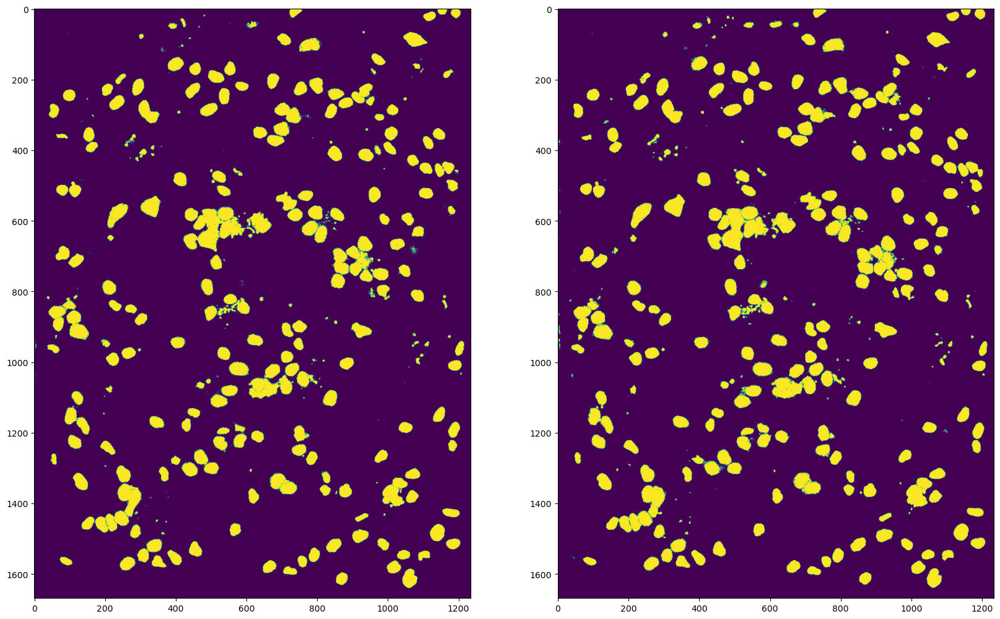

In [384]:
fig, axes = plt.subplots(1,2, figsize=(20,14))
red_normalized66=preprocessing.normalize_FUCCI_fluorescence(red)
axes[0].imshow(red_normalized65>0.2)
axes[1].imshow(red_normalized66>0.2)

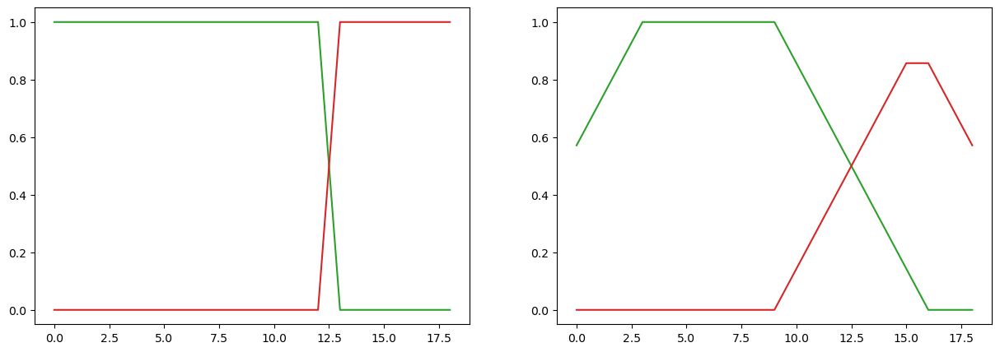

In [369]:
fig, axes=plt.subplots(1,2, figsize=(15,5))
axes[0].plot(cell_cycle.T[1], color='C2')
axes[0].plot(cell_cycle.T[2], color='C3')
axes[1].plot(smoothed.T[1], color='C2')
axes[1].plot(smoothed.T[2], color='C3')

[array([0., 1., 0.]),
 array([0., 1., 0.]),
 array([0., 1., 0.]),
 array([0., 1., 0.])]

In [266]:
cell_cycle[-6:]

array([[False, False,  True],
       [False, False,  True],
       [False,  True, False],
       [False,  True, False],
       [False,  True, False],
       [False,  True, False]])

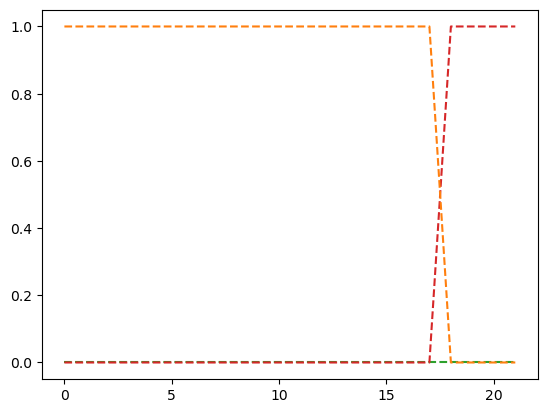

In [251]:
for cycle_stage, color in zip(cell_cycle.T, ['C2','C3','C1']):
    plt.plot(frames, cycle_stage, '--', color=color)

# FUCCI Analysis

In [2]:
from natsort import natsorted
from glob import glob

In [294]:
files=natsorted(glob('F:/my_data/Segmentation/20240215 FUCCI halo col_glass test/segmented/FUCCI-stage_*/'))

In [295]:
FUCCI_dataset_dense=[Stack(stack_path) for stack_path in tqdm(files)]

  0%|          | 0/10 [00:00<?, ?it/s]

In [19]:
densities=[[frame.mean_density() for frame in stack.frames] for stack in tqdm(FUCCI_dataset)]

  0%|          | 0/28 [00:00<?, ?it/s]

<ErrorbarContainer object of 3 artists>

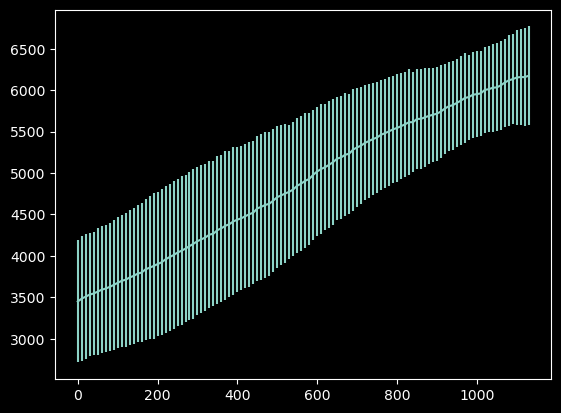

In [20]:
plt.errorbar(x=np.arange(len(FUCCI_dataset[0].frames))*10, y=np.array(densities).mean(axis=0), yerr=np.array(densities).std(axis=0))

In [617]:
areas=[[stack.frames[n].cell_areas(scaled=True) for stack in FUCCI_dataset] for n in tqdm(np.arange(len(FUCCI_dataset[0].frames)))]

  0%|          | 0/134 [00:00<?, ?it/s]

In [296]:
cell_areas=[[cell.get_area()*stack.frames[n].scale**2 for stack in FUCCI_dataset_dense for cell in stack.frames[n].cells] for n in tqdm(np.arange(len(FUCCI_dataset_dense[0].frames)))]

  0%|          | 0/134 [00:00<?, ?it/s]

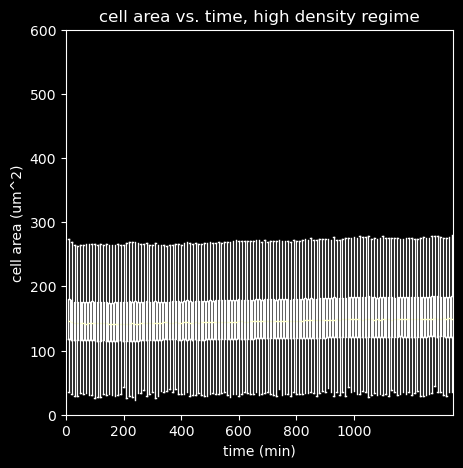

In [299]:
#frame_areas=[np.concatenate(frame_area) for frame_area in areas]
plt.figure(figsize=(5,5))
plt.boxplot(cell_areas, showfliers=False)
plt.xticks([0,20,40,60,80,100], [0,200,400,600,800,1000])
plt.xlabel('time (min)')
plt.ylabel('cell area (um^2)')
plt.ylim(0,600)

plt.title('cell area vs. time, high density regime')
plt.savefig('plots/24-3-8 Kirschner-Basan Meeting/20240215 area_vs_time.jpg', dpi=300)
plt.show()

In [151]:
FUCCI_dataset=[Stack(stack_path) for stack_path in tqdm(files)]

  0%|          | 0/20 [00:00<?, ?it/s]

In [157]:
FUCCI_dataset[8:]=[Stack(stack_path) for stack_path in tqdm(files[8:])]

  0%|          | 0/12 [00:00<?, ?it/s]

In [163]:
FUCCI_dataset[11].frames[-1].FUCCI

array([[[ 0,  0,  0, ...,  0,  0,  0],
        [ 0,  0,  0, ...,  0,  0,  0],
        [16, 16, 16, ..., 12, 12, 12],
        ...,
        [ 6,  6,  6, ...,  0,  0,  0],
        [ 0,  0,  0, ...,  0,  0,  0],
        [ 0,  0,  0, ...,  0,  0,  0]],

       [[ 0,  0,  0, ...,  0,  0,  0],
        [ 0,  0,  0, ...,  0,  0,  0],
        [ 7,  7,  7, ...,  0,  0,  0],
        ...,
        [ 0,  0,  0, ...,  0,  0,  0],
        [ 0,  0,  0, ...,  0,  0,  0],
        [ 0,  0,  0, ...,  0,  0,  0]]], dtype=uint8)

In [160]:
FUCCI_dataset[9].frames[0].FUCCI

array([[[ 0,  0,  0, ...,  0,  0,  0],
        [ 0,  0,  0, ...,  0,  0,  0],
        [ 0,  0,  0, ...,  5,  5,  5],
        ...,
        [ 0,  0,  0, ...,  0,  0,  0],
        [ 0,  0,  0, ...,  0,  0,  0],
        [ 0,  0,  0, ...,  0,  0,  0]],

       [[ 0,  0,  0, ...,  0,  0,  0],
        [ 0,  0,  0, ...,  0,  0,  0],
        [10, 10, 10, ...,  2,  2,  2],
        ...,
        [11, 11, 11, ...,  0,  0,  0],
        [ 0,  0,  0, ...,  0,  0,  0],
        [ 0,  0,  0, ...,  0,  0,  0]]], dtype=uint8)

In [168]:
for stack in tqdm(FUCCI_dataset):
    print(stack.name)
    if not hasattr(stack.frames[-1].cells[-1], 'red'):
        for frame in tqdm(stack.frames, desc='frame', leave=False):
            measure_FUCCI(frame)

  0%|          | 0/20 [00:00<?, ?it/s]

F:/my_data/Segmentation/20240310 FUCCI halo sorted col_glass low_density/segmented\FUCCI-stage_1\/
F:/my_data/Segmentation/20240310 FUCCI halo sorted col_glass low_density/segmented\FUCCI-stage_2\/
F:/my_data/Segmentation/20240310 FUCCI halo sorted col_glass low_density/segmented\FUCCI-stage_3\/
F:/my_data/Segmentation/20240310 FUCCI halo sorted col_glass low_density/segmented\FUCCI-stage_4\/
F:/my_data/Segmentation/20240310 FUCCI halo sorted col_glass low_density/segmented\FUCCI-stage_5\/
F:/my_data/Segmentation/20240310 FUCCI halo sorted col_glass low_density/segmented\FUCCI-stage_6\/
F:/my_data/Segmentation/20240310 FUCCI halo sorted col_glass low_density/segmented\FUCCI-stage_7\/
F:/my_data/Segmentation/20240310 FUCCI halo sorted col_glass low_density/segmented\FUCCI-stage_8\/
F:/my_data/Segmentation/20240310 FUCCI halo sorted col_glass low_density/segmented\FUCCI-stage_9\/


frame:   0%|          | 0/122 [00:00<?, ?it/s]

F:/my_data/Segmentation/20240310 FUCCI halo sorted col_glass low_density/segmented\FUCCI-stage_10\/


frame:   0%|          | 0/122 [00:00<?, ?it/s]

F:/my_data/Segmentation/20240310 FUCCI halo sorted col_glass low_density/segmented\FUCCI-stage_11\/


frame:   0%|          | 0/122 [00:00<?, ?it/s]

F:/my_data/Segmentation/20240310 FUCCI halo sorted col_glass low_density/segmented\FUCCI-stage_12\/


frame:   0%|          | 0/122 [00:00<?, ?it/s]

F:/my_data/Segmentation/20240310 FUCCI halo sorted col_glass low_density/segmented\FUCCI-stage_13\/


frame:   0%|          | 0/122 [00:00<?, ?it/s]

F:/my_data/Segmentation/20240310 FUCCI halo sorted col_glass low_density/segmented\FUCCI-stage_14\/


frame:   0%|          | 0/122 [00:00<?, ?it/s]

F:/my_data/Segmentation/20240310 FUCCI halo sorted col_glass low_density/segmented\FUCCI-stage_15\/


frame:   0%|          | 0/122 [00:00<?, ?it/s]

F:/my_data/Segmentation/20240310 FUCCI halo sorted col_glass low_density/segmented\FUCCI-stage_16\/


frame:   0%|          | 0/122 [00:00<?, ?it/s]

F:/my_data/Segmentation/20240310 FUCCI halo sorted col_glass low_density/segmented\FUCCI-stage_17\/


frame:   0%|          | 0/122 [00:00<?, ?it/s]

F:/my_data/Segmentation/20240310 FUCCI halo sorted col_glass low_density/segmented\FUCCI-stage_18\/


frame:   0%|          | 0/122 [00:00<?, ?it/s]

F:/my_data/Segmentation/20240310 FUCCI halo sorted col_glass low_density/segmented\FUCCI-stage_19\/


frame:   0%|          | 0/122 [00:00<?, ?it/s]

F:/my_data/Segmentation/20240310 FUCCI halo sorted col_glass low_density/segmented\FUCCI-stage_20\/


frame:   0%|          | 0/122 [00:00<?, ?it/s]

In [49]:
np.array(fetch_cell_cycle(frame))

array([0, 0, 0, 0, 1, 1, 2, 2, 1, 0, 1, 0, 1, 0, 0, 1, 0, 2, 0, 0, 1, 0,
       1, 0, 1, 2, 2, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 0, 2,
       0, 1, 0, 1, 1, 0, 1, 0, 0, 2, 0, 1, 1, 0, 1, 2, 1, 1, 2, 1, 1, 0,
       1, 1, 1, 0, 1, 0, 2, 0, 1, 0, 2, 1, 1, 1, 0, 2, 1, 2, 1, 1, 1, 2,
       2, 0, 1, 0, 1, 1, 0, 1, 2, 0, 0, 0, 2, 1, 2, 1, 1, 0, 1, 1, 1, 2,
       1, 1, 0, 1, 1, 1, 0, 2, 1, 1, 2, 1, 1, 1, 2, 1, 1, 1, 1, 0, 0, 2,
       0, 2, 1, 1, 1, 1, 1, 2, 1, 1, 1, 2, 0, 0, 1, 1, 1, 1, 1, 2, 1, 1,
       1, 1, 2, 1, 2, 1, 1, 1, 2, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 3, 1,
       0, 1, 1, 1, 1, 1, 1, 2, 1, 2, 1, 1, 1, 0, 1, 2, 0, 0, 1, 1, 1, 1,
       2, 1, 1, 1, 1, 0, 1, 2, 2, 1, 1, 1, 3, 2, 1, 1, 1, 1, 2, 1, 1, 1,
       1, 1, 2, 1, 1, 1, 1, 2, 1, 0, 2, 0, 2, 1, 1, 1, 1, 1, 1, 0, 1, 1,
       0, 1, 1, 2, 1, 2, 3, 1, 1, 2, 3, 1, 0, 1, 0, 2, 1, 1, 1, 2, 1, 0,
       1, 1, 0, 0, 1, 1, 0, 0, 2, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 0,
       0, 1, 0, 0, 1, 1, 1, 1, 2, 1, 1, 0, 1, 0, 1,

In [9]:
# export cell-level FUCCI info
from pathlib import Path

for stack in tqdm([denoised_stack]):
    for frame in stack.frames:
        frame_FUCCI=np.array(frame.fetch_cell_cycle())
        FUCCI_path=Path(frame.name.replace('segmented', 'cell_FUCCI').replace('seg', 'FUCCI'))
        FUCCI_path.parent.mkdir(parents=True, exist_ok=True)
        np.save(FUCCI_path, frame_FUCCI)

  0%|          | 0/1 [00:00<?, ?it/s]

In [6]:
denoised_stack.load_img()

In [7]:
for frame in tqdm(denoised_stack.frames):
    frame.FUCCI=np.array([frame.img[...,0],frame.img[...,1]])
    frame.to_seg_npy()

  0%|          | 0/116 [00:00<?, ?it/s]

In [4]:
# load cell-level FUCCI info
from pathlib import Path

for stack in tqdm([denoised_stack]):
    for frame in stack.frames:
        FUCCI_path=Path(frame.name.replace('segmented', 'cell_FUCCI').replace('seg', 'FUCCI'))
        frame_FUCCI=np.load(FUCCI_path)
        frame.write_cell_cycle(frame_FUCCI)

  0%|          | 0/1 [00:00<?, ?it/s]

FileNotFoundError: [Errno 2] No such file or directory: 'F:\\my_data\\Segmentation\\20240322 FUCCI halo sort1 col_glass colonies\\cell_FUCCI-denoised\\cell_FUCCI-denoised-000_FUCCI.npy'

In [169]:
for stack in tqdm(FUCCI_dataset):
    get_interpretable_FUCCI(stack)

  0%|          | 0/20 [00:00<?, ?it/s]

## Different percent threshold for G2?

In [137]:
red_percentages, green_percentages=measure_FUCCI(frame)

In [277]:
import pandas as pd
cell_cycle_df=[]
for frame in tqdm(stack.frames[::10]):
    red_percentages, green_percentages=measure_FUCCI(frame)
    df=pd.DataFrame({'cell':frame.cells, 'green_percent':green_percentages, 'red_percent': red_percentages, 'stage':fetch_cell_cycle(frame), 'cell_number':[cell.n for cell in frame.cells]})
    df['frame']=frame.frame_number
    cell_cycle_df.append(df)
    
cell_cycle_df=pd.concat(cell_cycle_df)

  0%|          | 0/12 [00:00<?, ?it/s]

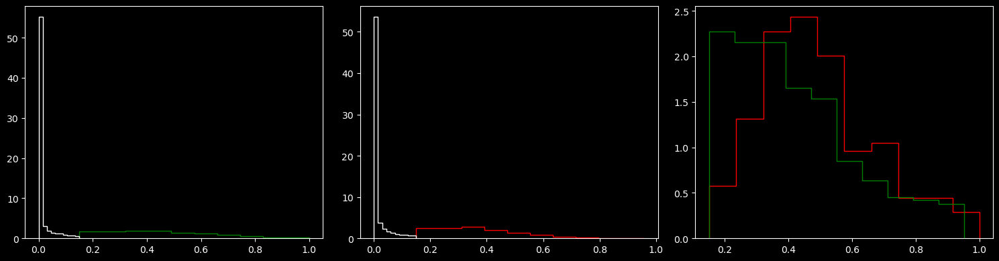

In [279]:
fig, axes=plt.subplots(1,3, figsize=(15,4))
axes[0].hist(cell_cycle_df[cell_cycle_df.stage==1]['green_percent'], density=True, histtype='step', color='green')
axes[0].hist(cell_cycle_df[cell_cycle_df.stage==0]['green_percent'], density=True, histtype='step', color='white')
axes[1].hist(cell_cycle_df[cell_cycle_df.stage==2]['red_percent'], density=True, histtype='step', color='red')
axes[1].hist(cell_cycle_df[cell_cycle_df.stage==0]['red_percent'], density=True, histtype='step', color='white')
axes[2].hist(cell_cycle_df[cell_cycle_df.stage==3]['red_percent'], density=True, histtype='step', color='red')
axes[2].hist(cell_cycle_df[cell_cycle_df.stage==3]['green_percent'], density=True, histtype='step', color='green')
fig.tight_layout()

In [283]:
low_red=np.where((cell_cycle_df.stage==3)&(cell_cycle_df.red_percent<0.22))
cell_cycle_df.iloc[low_red]

,cell,green_percent,red_percent,stage,cell_number,frame
583,<monolayer_tracking.segmented_comprehension.Ce...,0.262325,0.162259,3,583,0
176,<monolayer_tracking.segmented_comprehension.Ce...,0.257168,0.218766,3,176,10
290,<monolayer_tracking.segmented_comprehension.Ce...,0.248594,0.167196,3,290,10
318,<monolayer_tracking.segmented_comprehension.Ce...,0.228388,0.215282,3,318,10
562,<monolayer_tracking.segmented_comprehension.Ce...,0.169547,0.216735,3,562,20
710,<monolayer_tracking.segmented_comprehension.Ce...,0.186573,0.152225,3,710,30
753,<monolayer_tracking.segmented_comprehension.Ce...,0.332833,0.218684,3,753,40
806,<monolayer_tracking.segmented_comprehension.Ce...,0.185886,0.178141,3,806,40
797,<monolayer_tracking.segmented_comprehension.Ce...,0.437337,0.193632,3,797,50
673,<monolayer_tracking.segmented_comprehension.Ce...,0.578832,0.201460,3,673,60


In [508]:
def normalize(img, norm_quantile=(0.1,0.99)):
    img=img.astype(float)
    for img_channel in img.transpose(-1,0,1):
        if img_channel.max()==0:
            continue
        norm_range=np.quantile(img_channel,norm_quantile)
        img_channel[:]=np.clip(img_channel, a_min=norm_range[0], a_max=norm_range[1])
        img_channel-=img_channel.min()
        img_channel[:]=img_channel/img_channel.max()
    return img

In [261]:
dubious_cell=cell_cycle_df.iloc[low_red].iloc[5]
print(dubious_cell)

cell             <monolayer_tracking.segmented_comprehension.Ce...
green_percent                                             0.420791
red_percent                                               0.225769
stage                                                            3
cell_number                                                    188
frame                                                            0
Name: 188, dtype: object


In [273]:
frame=stack.frames[0]
nuclear_size_threshold=np.median(frame.cell_areas(scaled=False))*0.15
red, green = frame.FUCCI

# threshold fluorescence levels
red_fluor_threshold=get_fluor_threshold(red, nuclear_size_threshold)
green_fluor_threshold=get_fluor_threshold(green, nuclear_size_threshold)
red_percentages=preprocessing.color_threshold(frame, red, red_fluor_threshold)
green_percentages=preprocessing.color_threshold(frame, green, green_fluor_threshold)

In [263]:
green_percentages[188]

0.42079064

In [274]:
red_fluor_threshold

106.0

(600.0, 400.0)

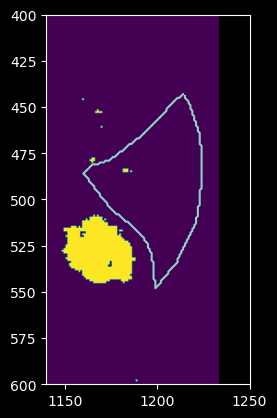

In [275]:
plt.imshow(red>red_fluor_threshold)
plt.plot(*dubious_cell['cell'].outline.T)

plt.xlim(1140, 1250)
plt.ylim(600, 400)

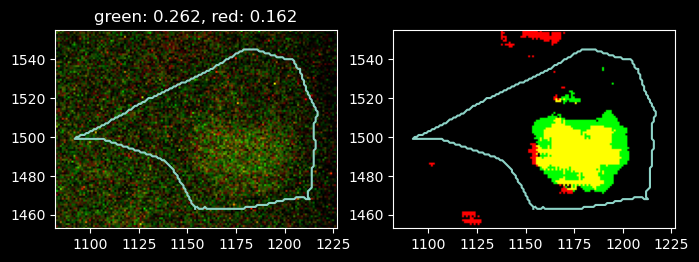

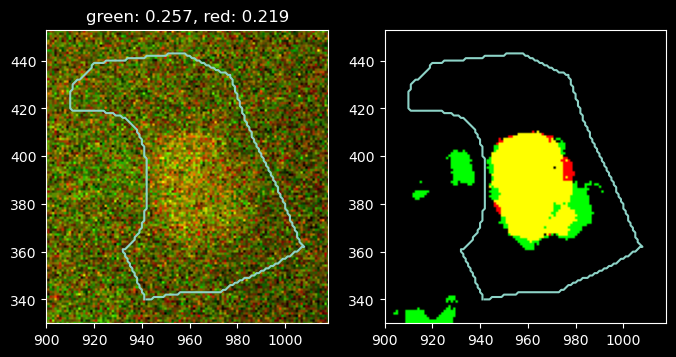

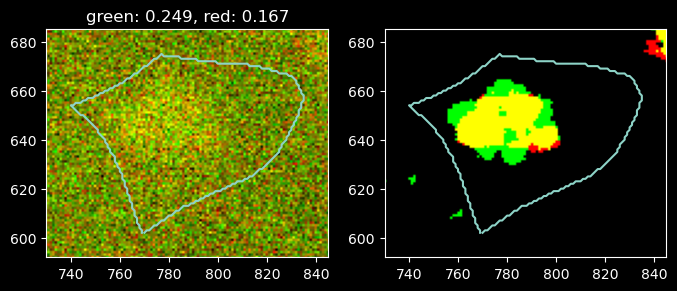

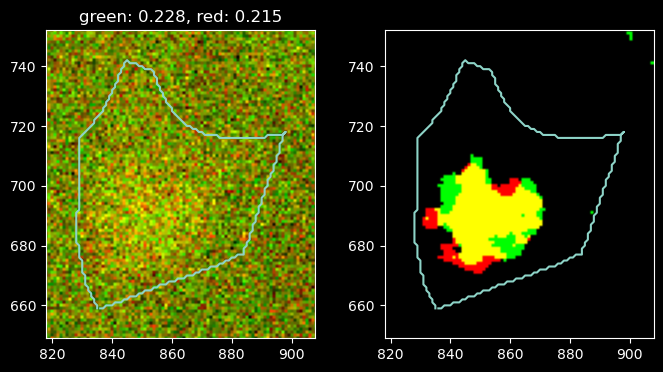

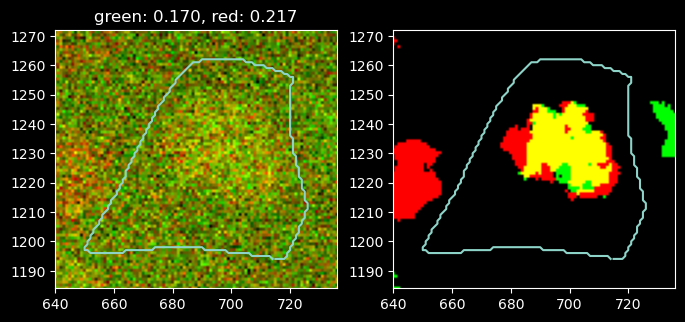

...

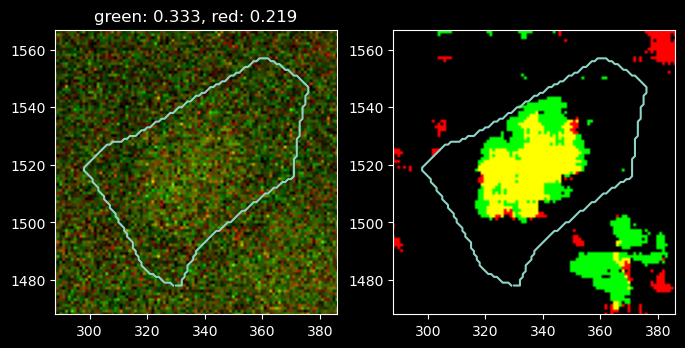

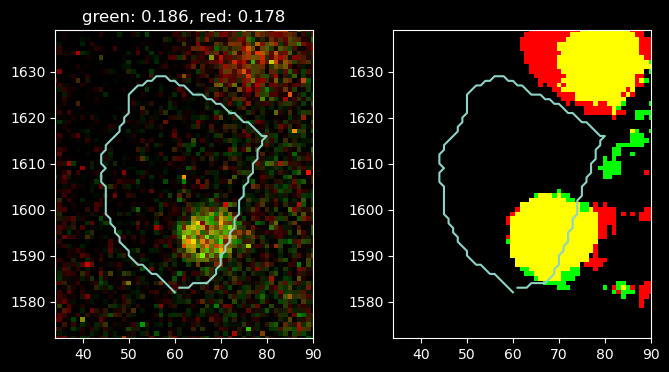

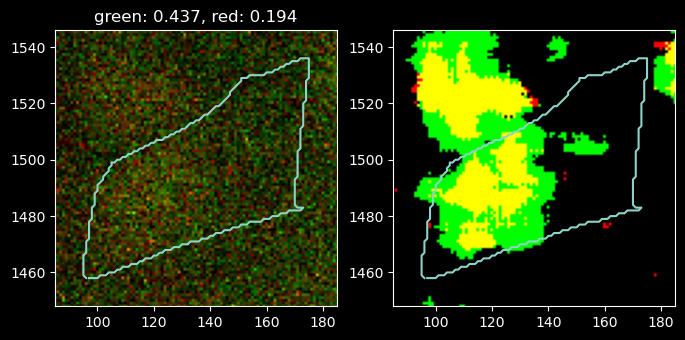

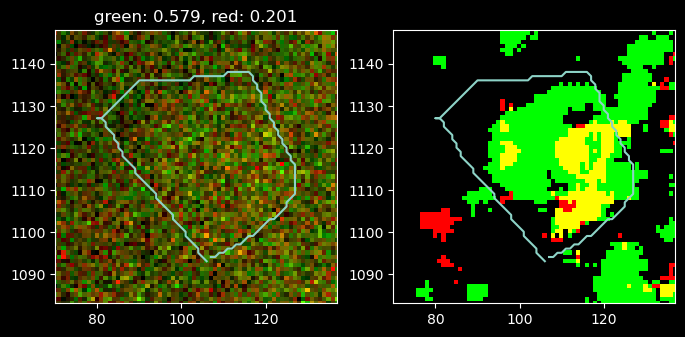

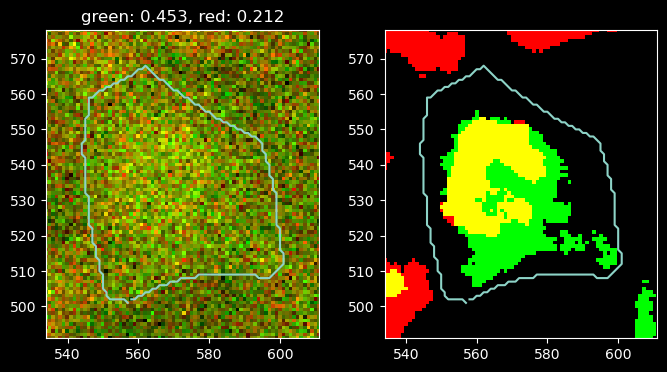

In [284]:
counter=0
for _, G2_candidate in cell_cycle_df.iloc[low_red].iterrows():
    frame=stack.frames[G2_candidate['frame']]
    if not hasattr(frame, 'img'):
        frame.load_img()
    axis_limits=np.array([G2_candidate['cell'].outline.min(axis=0)-10,G2_candidate['cell'].outline.max(axis=0)+10]).T
    img_FUCCI=np.stack([frame.img[...,0], frame.img[...,1], np.zeros(frame.masks.shape, dtype=int)], axis=-1)
    img_FUCCI=normalize(img_FUCCI)

    fig, axes=plt.subplots(1,2,figsize=(8,4))
    axes[0].imshow(img_FUCCI)
    axes[0].set_title(f'green: {G2_candidate.green_percent:.3f}, red: {G2_candidate.red_percent:.3f}')

    size_threshold=np.median(frame.cell_areas(scaled=False))*0.15
    red_fluor_threshold=get_fluor_threshold(frame.FUCCI[0], size_threshold)
    green_fluor_threshold=get_fluor_threshold(frame.FUCCI[1], size_threshold)
    
    color_FUCCI=np.stack([frame.FUCCI[0]>red_fluor_threshold, frame.FUCCI[1]>green_fluor_threshold, np.zeros(frame.masks.shape, dtype=int)], axis=-1)
    axes[1].imshow(color_FUCCI*255)

    for ax in axes:
        ax.plot(*G2_candidate['cell'].outline.T)
        ax.set_xlim(axis_limits[0])
        ax.set_ylim(axis_limits[1])
    
    plt.show()
    counter+=1
    if counter>10:
        break

## Show overlay

In [5]:
stack=Stack(r'F:\my_data\Segmentation\20240311 FUCCI halo sorted col_glass high_density\segmented_denoise_test\FUCCI-stage_1/')
len(stack.frames)

132

In [28]:
from monolayer_tracking.plot_tools import FUCCI_overlay

In [ ]:
help(FUCCI_overlay)

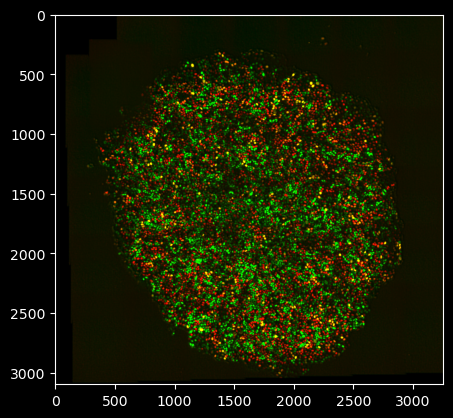

In [4]:
frame=stack.frames[5]
color_FUCCI=np.stack([frame.FUCCI[0], frame.FUCCI[1], np.zeros(frame.masks.shape, dtype=int)], axis=-1)

plt.imshow(color_FUCCI)

In [11]:
from monolayer_tracking import plot_tools

plot_tools.demo_seg(stack, output_path='F:/my_data/Segmentation/20240322 FUCCI halo sort1 col_glass colonies/demo_seg/', highlight_mitoses=False, polygon_ax=False, figsize=10)

  0%|          | 0/116 [00:00<?, ?it/s]

In [2]:
denoised_stack=Stack(r'F:\my_data\Segmentation\20240322 FUCCI halo sort1 col_glass colonies\segmented-denoised/', progress_bar=tqdm)

  0%|          | 0/116 [00:00<?, ?it/s]

In [13]:
plot_tools.demo_seg(denoised_stack, output_path='F:/my_data/Segmentation/20240322 FUCCI halo sort1 col_glass colonies/denoised_demo_seg/', highlight_mitoses=False, polygon_ax=False, figsize=10)

  0%|          | 0/116 [00:00<?, ?it/s]

In [8]:
from matplotlib.patches import Polygon
from matplotlib.collections import PatchCollection
import matplotlib.patheffects as patheffects

def FUCCI_overlay(frame, imshow=True, ax=None, show_denoised=True, show_labels=False, alpha=0.2):
    if not ax: ax=plt.gca()
    if imshow:
        if show_denoised:
            color_FUCCI=np.stack([frame.FUCCI[0], frame.FUCCI[1], np.zeros(frame.masks.shape, dtype=int)], axis=-1)
        else:
            if not hasattr(frame, 'img'):
                frame.load_img()
            color_FUCCI=np.stack([frame.img[...,0], frame.img[...,1], np.zeros(frame.masks.shape, dtype=int)], axis=-1)
            color_FUCCI=normalize(color_FUCCI)
        plt.imshow(color_FUCCI)
    else:
        plt.xlim(0,frame.masks.shape[1])
        plt.ylim(frame.masks.shape[0],0)

    if show_labels:
        frame.get_centroids()

    cell_overlays=[]
    colors={0:'none', 1:'lime', 2:'r', 3:'orange'}
    for cell in frame.cells:
        
        cell_overlays.append(Polygon(cell.outline, ec='white', fc=colors[cell.cycle_stage], linewidth=1, alpha=alpha))

        if show_labels:
            particle_label=plt.text(cell.centroid[1],cell.centroid[0],s=cell.n, color='white', fontsize=6)
            particle_label.set_path_effects([patheffects.Stroke(linewidth=1, foreground=color),patheffects.Normal()])

    ax.add_artist(PatchCollection(cell_overlays, match_original=True))
    plt.axis('off')

In [23]:
for frame in tqdm(denoised_stack.frames):
    frame.FUCCI=np.array([frame.img[...,0], frame.img[...,1]])

  0%|          | 0/116 [00:00<?, ?it/s]

In [31]:
help(frame.measure_FUCCI)

Help on method measure_FUCCI in module monolayer_tracking.segmented_comprehension:

measure_FUCCI(percent_threshold=0.15, red_fluor_threshold=0.2, green_fluor_threshold=0.2, threshold_offset=0, noise_score=None) method of monolayer_tracking.segmented_comprehension.Image instance
    Measure the FUCCI (Fluorescence Ubiquitination Cell Cycle Indicator) levels in cells.
    
    Args:
        use_masks (bool): If True, use masks for measurements.
        percent_threshold (float): Threshold for percentage comparison.
        red_fluor_threshold (float): Threshold for red fluorescence.
        green_fluor_threshold (float): Threshold for green fluorescence.
    
    Returns:
        tuple: Red fluorescence percentages, Green fluorescence percentages.



In [8]:
for frame in tqdm(denoised_stack.frames):
    frame.measure_FUCCI(threshold_offset=0, noise_score=0.01)

denoised_stack.get_interpretable_FUCCI()

  0%|          | 0/116 [00:00<?, ?it/s]

,cell_number,y,x,frame,particle,cell_cycle
0,0,98.129032,2293.987903,0,0,0
16,1,124.715618,824.102564,0,16,0
1,2,199.859510,2248.061630,0,1,2
2,3,235.523719,2269.562302,0,2,2
3,4,247.591304,2225.326087,0,3,0
...,...,...,...,...,...,...
1271250,10579,3048.473526,1445.484957,115,83725,3
1271251,10580,3044.938743,1520.208485,115,77703,1
1271252,10581,3048.358183,1565.474932,115,74749,1
1260690,10582,3047.556624,1863.010073,115,83077,0


(2000.0, 1000.0)

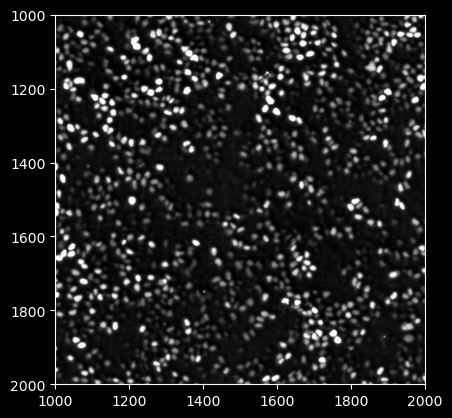

In [19]:
plt.figure(figsize=(10,10))
plt.imshow(denoised_stack.frames[0].img[...,0], cmap='gray')
plt.xlim(1000,2000)
plt.ylim(2000,1000)

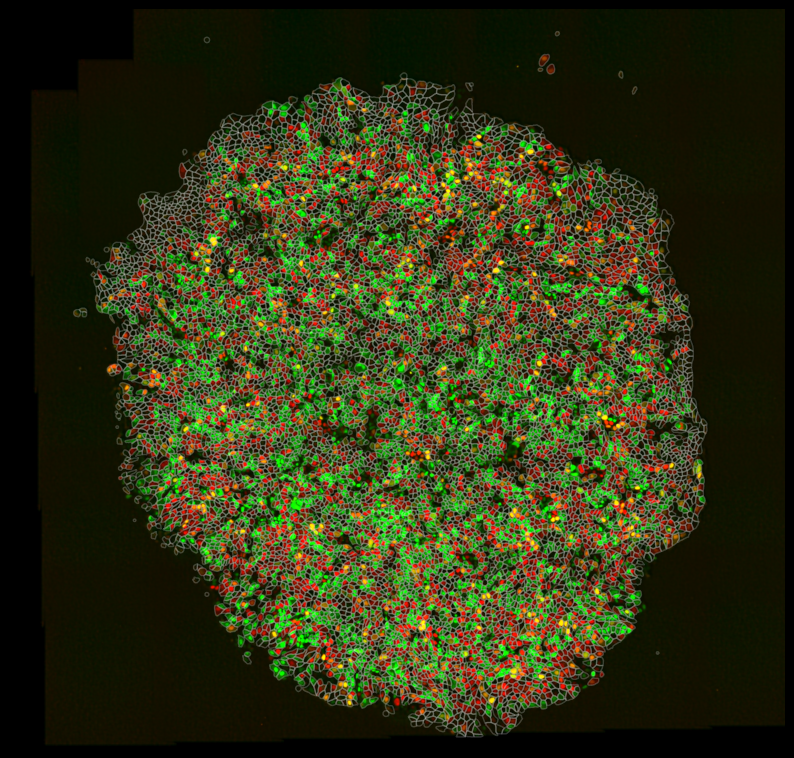

In [29]:
frame=denoised_stack.frames[10]
plt.figure(figsize=(10,14))
FUCCI_overlay(frame, imshow=True, alpha=0.2)
#plt.savefig('plots/24-3-8 Kirschner-Basan Meeting/FUCCI_overlay.jpg', dpi=300, bbox_inches='tight', pad_inches=0)

In [18]:
get_interpretable_FUCCI(stack)

,cell_number,y,x,frame,particle,cell_cycle
0,0,19.439506,67.401852,0,0,0
1,1,45.266422,242.660862,0,1,1
194,2,18.023402,1088.693969,0,194,0
3,3,50.868079,289.273876,0,3,2
4,4,40.092446,393.525092,0,4,1
...,...,...,...,...,...,...
74917,777,1546.770103,317.100927,97,2935,1
74918,778,1546.342751,872.281418,97,2774,1
74825,779,1547.238005,511.315027,97,3469,2
74186,780,1549.115161,582.237308,97,3770,1


In [38]:
for n, frame in enumerate(tqdm(denoised_stack.frames)):
    plt.figure(figsize=(20,20))
    FUCCI_overlay(frame, show_denoised=True, show_labels=False)
    plt.savefig(f'C:/Users/Andy/Desktop/FUCCI_plots/denoised_20240322/stage_1-{n}.tif', dpi=300, bbox_inches='tight', pad_inches=0)
    plt.close()

  0%|          | 0/116 [00:00<?, ?it/s]

## speed vs. cell cycle stage

In [50]:
for stack in tqdm(FUCCI_dataset):
    stack.get_velocities(filter_stubs=False)

100%|██████████| 7/7 [01:49<00:00, 15.61s/it]


In [52]:
stack.velocities.sort_values(['frame','cell_number'])

,cell_number,y,x,frame,particle,dx,dy,dt,v,theta
0,0,22.785475,581.665363,0,0,-0.273831,-0.351026,2.0,0.445200,-2.233277
1,1,31.343712,188.703596,0,1,0.908722,-3.245302,1.0,3.370128,-1.297777
104,2,24.833249,931.524291,0,104,NaN,NaN,NaN,NaN,NaN
3,3,45.077935,1003.700911,0,3,9.416239,8.342006,1.0,12.579929,0.724980
4,4,30.125379,539.953967,0,4,1.699813,1.053363,1.0,1.999735,0.554774
...,...,...,...,...,...,...,...,...,...,...
64685,859,1618.582051,1215.653592,113,3742,NaN,NaN,NaN,NaN,NaN
64686,860,1627.039954,747.146505,113,3433,NaN,NaN,NaN,NaN,NaN
64687,861,1619.062811,1074.737869,113,3812,NaN,NaN,NaN,NaN,NaN
63848,862,1628.613523,816.162594,113,3339,NaN,NaN,NaN,NaN,NaN


In [77]:
import pandas as pd
all_velocities=[]
for stack in tqdm(FUCCI_dataset):
    all_cell_stages=[]
    for frame in stack.frames:
        for cell in frame.cells:
            all_cell_stages.append([cell.green, cell.red, cell.orange])
    all_cell_stages=np.array(all_cell_stages)
    all_cell_stages=np.concatenate([all_cell_stages.T,[all_cell_stages.sum(axis=1)==0]]).T # add a column for NS
    stack.velocities['cell_cycle']=np.argmax(all_cell_stages, axis=1)
    all_velocities.append(stack.velocities)
all_velocities=pd.concat(all_velocities)

100%|██████████| 7/7 [00:03<00:00,  2.00it/s]


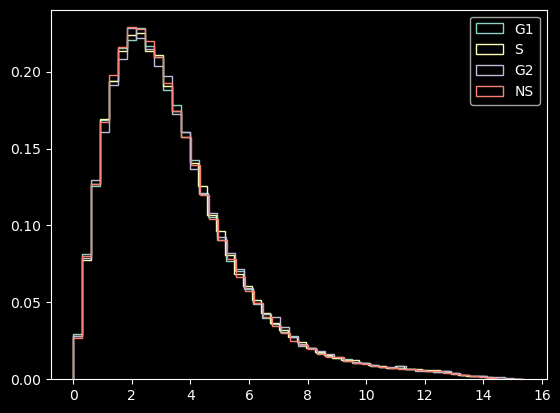

In [85]:
cc_labels=['G1','S','G2','NS']
for cell_cycle, cc_velocities in all_velocities.groupby('cell_cycle'):
    plt.hist(cc_velocities['v'], bins=50, label=cc_labels[cell_cycle], histtype='step', density=True)

#plt.yscale('log')
plt.legend()

## apical areas

In [ ]:
G1_areas=[]
S_areas=[]
G2_areas=[]
for stack in tqdm(FUCCI_dataset):
    for frame in stack.frames:
        for cell in frame.cells:
            area=cell.get_area()*frame.scale**2
            if cell.orange:
                G2_areas.append(area)
            elif cell.green:
                G1_areas.append(area)
            elif cell.red:
                S_areas.append(area)

In [10]:
FUCCI_dataset=[denoised_stack]

In [11]:
cell_areas=[[],[],[]]
n_cells=[]

n_frames=len(FUCCI_dataset[0].frames)

for frame_number in tqdm(range(n_frames)):
    frame_n=0
    for stack in FUCCI_dataset:
        try:
            frame=stack.frames[frame_number]
        except IndexError:
            continue
        frame_areas=[[],[],[]]
        for cell in frame.cells:
            area=cell.get_area()*frame.scale**2
            if cell.cycle_stage>0:
                frame_areas[cell.cycle_stage-1].append(area)
        frame_n+=frame.n

    n_cells.append(frame_n)
    for i in range(3):
        cell_areas[i].append(frame_areas[i])

G1_areas, S_areas, G2_areas=cell_areas

  0%|          | 0/116 [00:00<?, ?it/s]

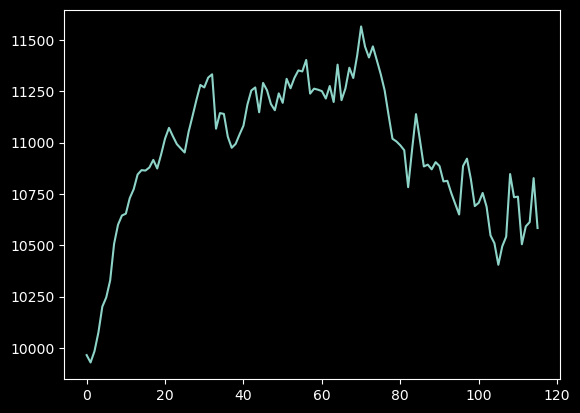

In [12]:
plt.plot(n_cells)

In [45]:
for n in np.arange(n_frames):
    G1_areas[n]=list(np.array(G1_areas[n])/n_cells[n])
    G2_areas[n]=list(np.array(G2_areas[n])/n_cells[n])
    S_areas[n]=list(np.array(S_areas[n])/n_cells[n])

In [52]:
chunksize=13
G1_binned=[G1_areas[i:i+chunksize] for i in range(0,len(G1_areas),chunksize)]
S_binned=[S_areas[i:i+chunksize] for i in range(0,len(G1_areas),chunksize)]
G2_binned=[G2_areas[i:i+chunksize] for i in range(0,len(G1_areas),chunksize)]

n_binned=[sum(n_cells[i:i+chunksize]) for i in range(0,len(G1_areas),chunksize)]

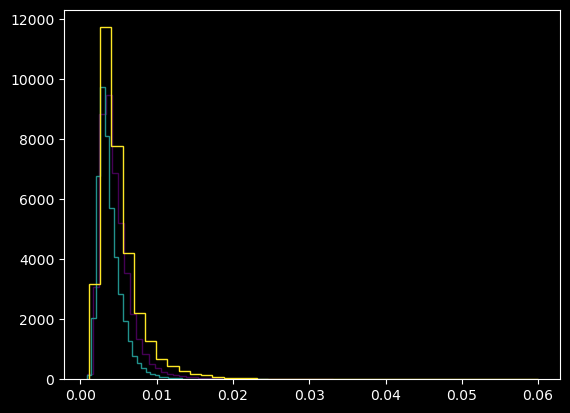

In [54]:
colors=plt.cm.viridis(np.linspace(0,1,3))
for color, area in zip(colors, G1_binned):
    area=[x for row in area for x in row]
    plt.hist(area, bins=40, color=color, histtype='step')

In [77]:
densities_binned=np.array([np.array(densities).T[i:i+chunksize] for i in range(0,len(G1_areas),chunksize)])

In [80]:
densities_binned[2].mean()

5833.730048784593

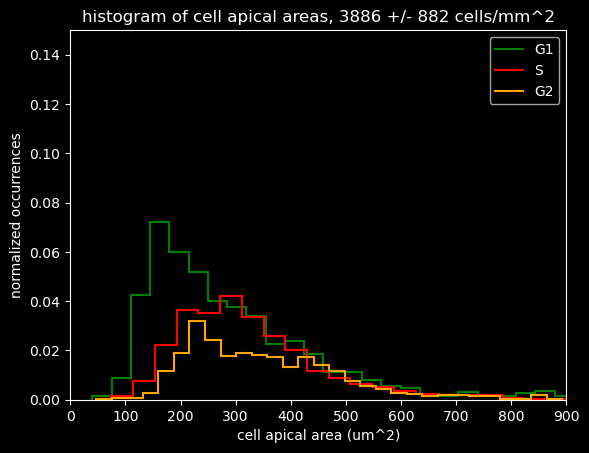

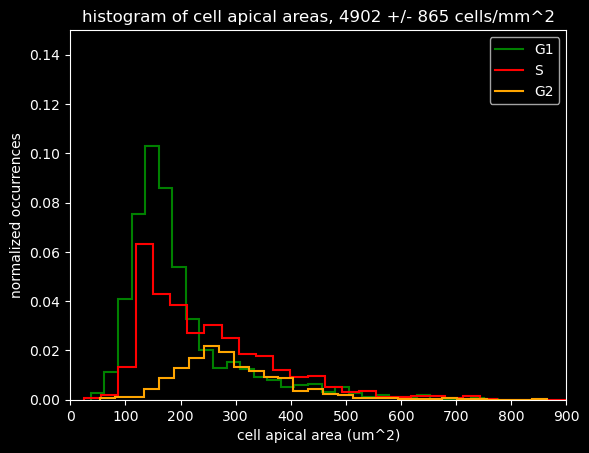

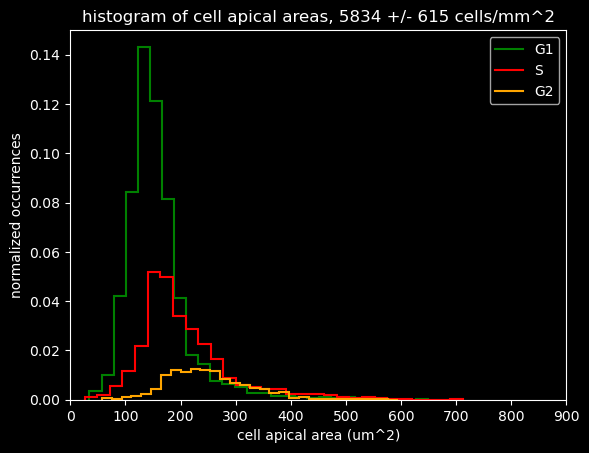

In [100]:
for G1, S, G2, densities in zip(G1_binned, S_binned, G2_binned, densities_binned):
    G1=np.concatenate(G1)
    S=np.concatenate(S)
    G2=np.concatenate(G2)
    n=np.sum([G1.size, S.size, G2.size])
    for stage, color, label in zip([G1, S, G2], ['green', 'red', 'orange'], ['G1', 'S', 'G2']):
        stage_n, stage_bins = np.histogram(stage, bins=30)
        plt.stairs(stage_n/n, stage_bins, color=color, label=label, linewidth=1.5)
    plt.ylim(0,0.15)
    plt.xlim(0,900)
    plt.legend()
    plt.ylabel('normalized occurrences')
    plt.xlabel('cell apical area (um^2)')
    plt.title(f'histogram of cell apical areas, {round(np.mean(densities))} +/- {round(np.std(densities))} cells/mm^2')
    plt.savefig(f'plots/24-3-8 Kirschner-Basan Meeting/20240221-cell_cycle_vs_volume-{round(np.mean(densities))}.jpg', dpi=300)
    plt.show()

In [13]:
densities=[[frame.mean_density() for frame in stack.frames] for stack in tqdm(FUCCI_dataset)]

  0%|          | 0/1 [00:00<?, ?it/s]

In [45]:
np.mean(densities)
np.std(densities)

1125.9174980733494

Text(0.5, 1.0, 'histogram of cell apical areas, 23167 +/- 374 cells/mm^2')

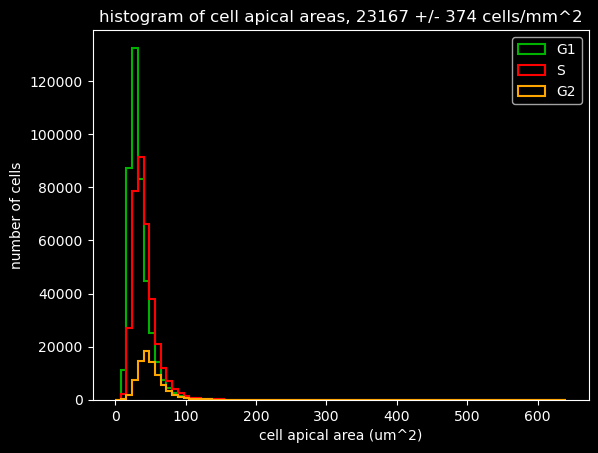

In [14]:
plt.hist(np.concatenate(G1_areas), bins=np.linspace(0,640,80), histtype='step', linewidth=1.5, label='G1', color='lime', alpha=0.7)
plt.hist(np.concatenate(S_areas), bins=np.linspace(0,640,80), histtype='step', linewidth=1.5, label='S', color='red')
plt.hist(np.concatenate(G2_areas), bins=np.linspace(0,640,80), histtype='step', linewidth=1.5, label='G2', color='orange')

plt.xlabel('cell apical area (um^2)')
plt.ylabel('number of cells')
plt.legend()

plt.title(f'histogram of cell apical areas, {round(np.mean(densities))} +/- {round(np.std(densities))} cells/mm^2')
#plt.savefig('plots/24-3-8 Kirschner-Basan Meeting/20240215-cell_cycle_vs_volume.jpg', dpi=300)

## cell cycle occupancy

In [15]:
cc_dists=[]
n_cells=[]

n_frames=len(FUCCI_dataset[0].frames)
for frame_number in tqdm(np.arange(n_frames)):
    frame_cc_dist=np.array([0,0,0,0])
    frame_cells=0
    for stack in FUCCI_dataset:
        frame=stack.frames[frame_number]
        cell_cycle=frame.fetch_cell_cycle()

        cell_cycle_onehot=np.array(pd.get_dummies(cell_cycle))
        frame_cc_dist+=cell_cycle_onehot.sum(axis=0)
        frame_cells+=len(cell_cycle)

    cc_dists.append(frame_cc_dist)
    n_cells.append(frame_cells)
    
cc_dists=np.array(cc_dists).T
n_cells=np.array(n_cells).T

  0%|          | 0/116 [00:00<?, ?it/s]

In [16]:
n_fluorescent_cells=cc_dists[1:].sum(axis=0)

In [18]:
denoised_stack.name

'F:\\my_data\\Segmentation\\20240322 FUCCI halo sort1 col_glass colonies\\segmented-denoised//'

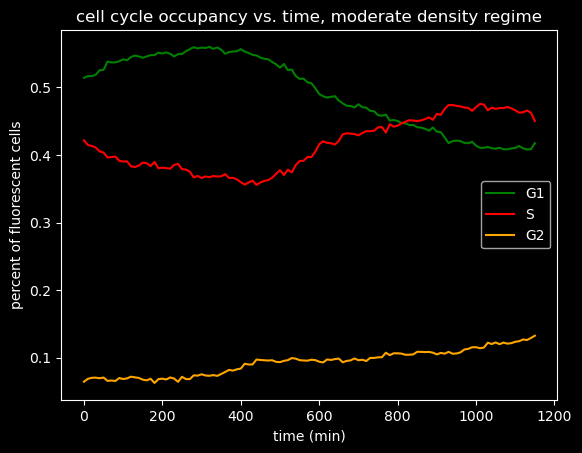

In [17]:
plt.plot(np.arange(n_frames)*10, cc_dists[1]/n_fluorescent_cells, color='green', label='G1')
plt.plot(np.arange(n_frames)*10, cc_dists[2]/n_fluorescent_cells, color='red', label='S')
plt.plot(np.arange(n_frames)*10, cc_dists[3]/n_fluorescent_cells, color='orange', label='G2')
#plt.plot(np.arange(n_frames)*10, cc_dists.T[3], color='gray', label='no signal')

plt.xlabel('time (min)')
plt.ylabel('percent of fluorescent cells')

plt.title('cell cycle occupancy vs. time, moderate density regime')
plt.legend()

#plt.ylim(0.01744368789050261, 0.7166819818895998)

#plt.savefig('plots/24-3-8 Kirschner-Basan Meeting/20240221-cell_cycle_occupancy.jpg', dpi=300)

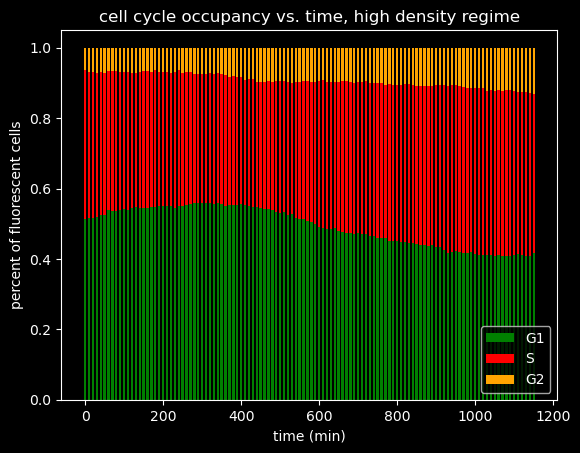

In [19]:
plt.bar(np.arange(n_frames)*10, cc_dists[1]/n_fluorescent_cells, width=6, color='green', label='G1')
plt.bar(np.arange(n_frames)*10, cc_dists[2]/n_fluorescent_cells, width=6, bottom=cc_dists[1]/n_fluorescent_cells, color='red', label='S')
plt.bar(np.arange(n_frames)*10, cc_dists[3]/n_fluorescent_cells, width=6, bottom=(cc_dists[1]+cc_dists[2])/n_fluorescent_cells, color='orange', label='G2')
#plt.plot(np.arange(n_frames)*10, cc_dists.T[3], color='gray', label='no signal')

plt.xlabel('time (min)')
plt.ylabel('percent of fluorescent cells')

plt.title('cell cycle occupancy vs. time, high density regime')
plt.legend(loc='lower right')

#plt.savefig('plots/24-3-8 Kirschner-Basan Meeting/20240215-cell_cycle_occupancy.jpg', dpi=300)

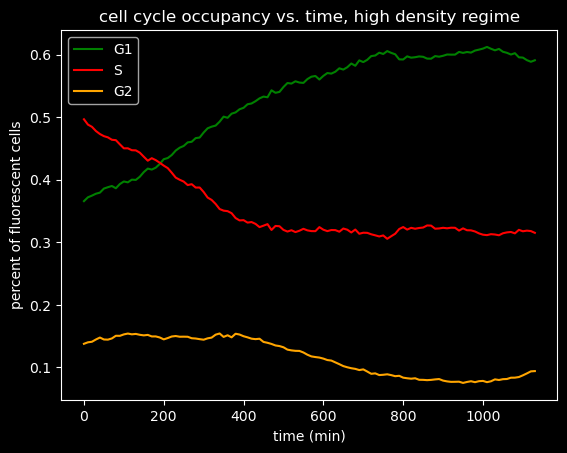

In [103]:
plt.plot(np.arange(n_frames)*10, cc_dists.T[0]/n_fluorescent_cells, color='green', label='G1')
plt.plot(np.arange(n_frames)*10, cc_dists.T[1]/n_fluorescent_cells, color='red', label='S')
plt.plot(np.arange(n_frames)*10, cc_dists.T[2]/n_fluorescent_cells, color='orange', label='G2')
#plt.plot(np.arange(n_frames)*10, cc_dists.T[3], color='gray', label='no signal')

plt.xlabel('time (min)')
plt.ylabel('percent of fluorescent cells')

plt.title('cell cycle occupancy vs. time, high density regime')
plt.legend()

plt.savefig('plots/24-3-8 Kirschner-Basan Meeting/20240215-cell_cycle_occupancy.jpg', dpi=300)

## shape PCA

In [2]:
from glob import glob
from natsort import natsorted
import pickle

In [12]:
stack_paths=natsorted(glob('F:/my_data/Segmentation/20240221 FUCCI halo col_glass/segmented/FUCCI-stage_*/'))
FUCCI_dataset=[Stack(stack_path) for stack_path in tqdm(stack_paths[:23]+stack_paths[24:])]

  0%|          | 0/27 [00:00<?, ?it/s]

In [16]:
contour_dirs=natsorted(glob(r'F:\my_data\Segmentation\20240221 FUCCI halo col_glass\contours\*\aligned_contours.pkl'))

In [18]:
for contour_dir, stack in zip(tqdm(contour_dirs), FUCCI_dataset):
    with open(contour_dir, 'rb') as file:
        aligned_contours=pickle.load(file)
    stack.tracked_centroids['contour']=aligned_contours

  0%|          | 0/27 [00:00<?, ?it/s]

In [20]:
aligned_contours=np.concatenate([stack.tracked_centroids['contour'] for stack in FUCCI_dataset])

In [21]:
from celltool import simple_interface as ct

variance_explained=0.95
pca_contour, header, rows, norm_header, norm_rows = ct.make_shape_model(aligned_contours, required_variance_explained=variance_explained)

In [63]:
# export PCA model and positions
pca_contour.to_file('F:/my_data/Segmentation/20240221 FUCCI halo col_glass/contours/PCA model.contour')
fit_export='F:/my_data/Segmentation/20240221 FUCCI halo col_glass/contours/PCA-positions.csv'
fit_normalized_export='F:/my_data/Segmentation/20240221 FUCCI halo col_glass/contours/PCA-normalized-positions.csv'

#pd.DataFrame(rows, columns=header).to_csv(fit_export, index=False)
pd.DataFrame(norm_rows, columns=norm_header).to_csv(fit_normalized_export, index=False)

In [69]:
t=pd.concat([stack.tracked_centroids.sort_values(['frame','cell_number']) for stack in FUCCI_dataset]).reset_index(drop=True)

In [70]:
t=pd.concat([t, pd.DataFrame(norm_rows, columns=norm_header).iloc[:,1:]], axis=1)

In [58]:
from celltool.contour import contour_class
import celltool.simple_interface as ct

# get pca contour
shape_model_file='F:/my_data/Segmentation/20240215 FUCCI halo col_glass test/contours/PCA model.contour'
pca_contour=contour_class.from_file(shape_model_file, contour_class.PCAContour)

# measure with pca contour
measure=ct.ShapeModeMeasurement(shape_model_file, modes=None, normalized=True)
norm_header, norm_rows=ct.measure_contours(aligned_contours, False, measure)

In [72]:
import umap
umap_reducer=umap.UMAP()

test_positions=t.sample(100000)
PCA_umap=umap_reducer.fit_transform(test_positions.iloc[:,-7:])

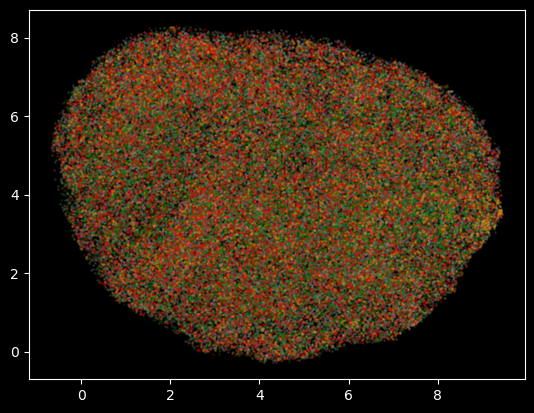

In [73]:
for cc_stage, color in zip(range(4), ['gray', 'green','red','orange']):
    plt.scatter(*PCA_umap[test_positions['cell_cycle']==cc_stage].T, s=1, alpha=0.2, color=color)

In [74]:
area=[]
for frame, cell_number in tqdm(np.array(t.iloc[:10000][['frame','cell_number']])):
    area.append(FUCCI_dataset[0].frames[frame].cells[cell_number].get_area())

  0%|          | 0/10000 [00:00<?, ?it/s]

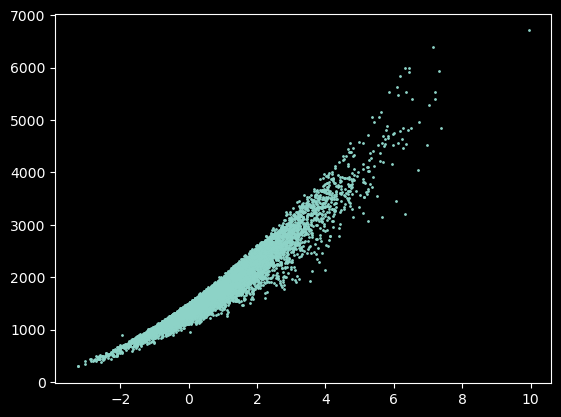

In [77]:
plt.scatter(t.iloc[:10000]['PCA model (normalized mode 1)'], area, s=1)

In [138]:
shape_export=t[['contour','cell_cycle']]

In [143]:
import pickle

with open('F:/my_data/Segmentation/20240221 FUCCI halo col_glass/contours/shape-cell_cycle.pkl', 'wb') as file:
    pickle.dump(shape_export, file)

In [137]:
PCA_export=pd.DataFrame(norm_rows, columns=norm_header).iloc[:,1:]
PCA_export['cell_cycle']=t['cell_cycle']
PCA_export.to_csv('F:/my_data/Segmentation/20240221 FUCCI halo col_glass/contours/PCA-normalized-positions.csv', index=False)

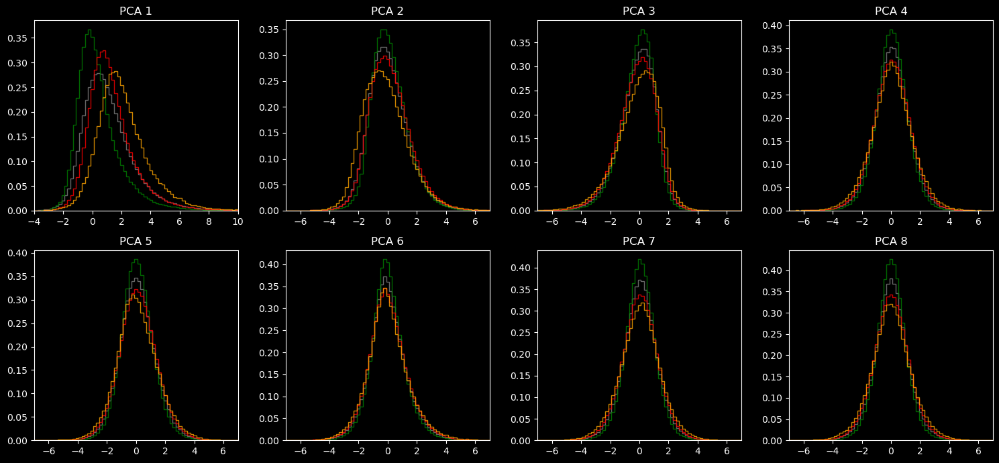

In [129]:
colors=['gray', 'green','red','orange']
fig, axes=plt.subplots(2,4, figsize=(15,7))
for cc_stage, PCA_coords in t.groupby('cell_cycle'):
    for n, ax in zip(range(len(pca_contour.modes)), axes.flatten()):
        ax.hist(PCA_coords[f'PCA model (normalized mode {n+1})'], histtype='step', alpha=0.8, linewidth=1, color=colors[cc_stage], bins=np.linspace(-10,10,100), density=True)

for n, ax in enumerate(axes.flatten()):
    ax.set_title(f'PCA {n+1}')
    ax.set_xlim(-7,7)

axes[0,0].set_xlim(-4,10)

fig.tight_layout()
plt.savefig('plots/cell_cycle_shape_PCA-moderate.jpg', dpi=300)

In [84]:
cc_mean_shape=t.groupby('cell_cycle')[[f'PCA model (normalized mode {n+1})' for n in range(8)]].mean()

In [117]:
mean_outlines=[]
for cc_stage, cells in t.groupby('cell_cycle'):
    points=[]
    print(cc_stage)
    for cell in cells['contour']:
        points.append(cell.points.T)
    mean_outlines.append(np.mean(np.array(points), axis=0))

0
1
2
3


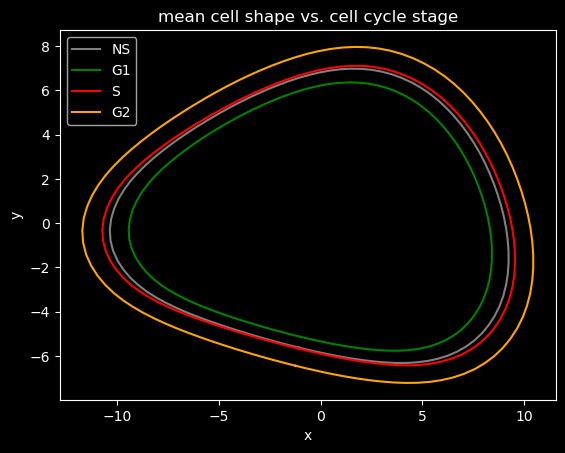

In [121]:
for pos, color, label in zip(np.array(cc_mean_shape), ['gray', 'green','red','orange'], ['NS','G1','S','G2']):
    points=pca_contour.as_position(pos, normalized=True).points
    points=np.append(points, [points[0]], axis=0)
    plt.plot(*points.T, color=color, label=label)

plt.xlabel('x')
plt.ylabel('y')
plt.legend()

plt.title('mean')

plt.title('mean cell shape vs. cell cycle stage')
plt.savefig('plots/cell_cycle_shape_mean-moderate.jpg', dpi=300)

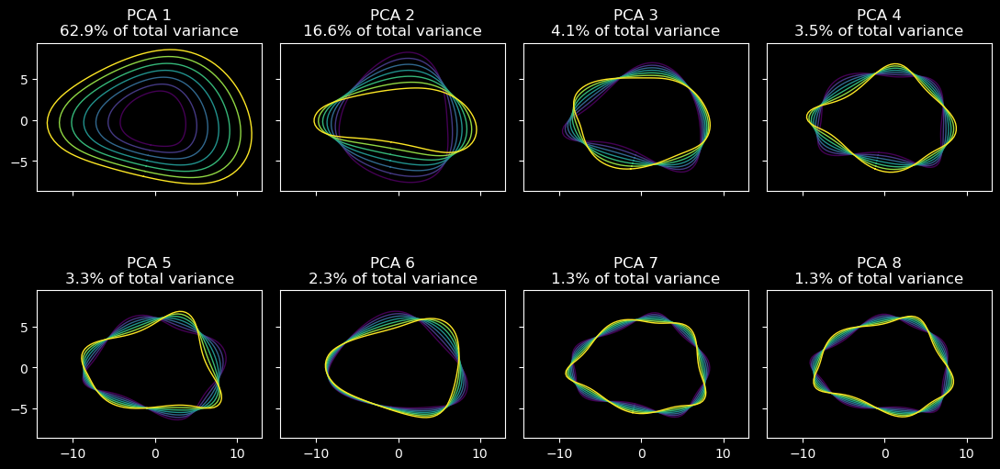

In [123]:
# compute mode stdevs
num_total_modes=len(pca_contour.modes)
modes=np.arange(num_total_modes) # or some subset of the modes which we want to plot

positions = np.array([-3, -2, -1, 0, 1, 2, 3])

mode_contours = []
EVRs = []
for mode in modes:
    inner_contours = []
    for position in positions:
        pos = np.zeros(num_total_modes)
        pos[mode] = position
        inner_contours.append(pca_contour.as_position(pos, normalized = True))
        
    mode_contours.append(inner_contours)
    EVRs.append(pca_contour.standard_deviations[mode]**2/pca_contour.total_variance)
    
colors = plt.cm.viridis(np.linspace(0, 1, len(positions)))

fig, axes = plt.subplots(2,4, figsize=(11,6), subplot_kw={'aspect':1}, sharex=True, sharey=True)

for n, EVR, mode_contour, ax in zip(modes, EVRs, mode_contours, axes.flatten()):
    for c, color in zip(mode_contour, colors):
        x, y=np.append(c.points, [c.points[0]], axis=0).T
        ax.plot(x, y, color=color, linewidth=1)
    ax.set_title(f'PCA {n+1}\n{EVR*100:.1f}% of total variance')

fig.tight_layout()
plt.savefig('plots/FUCCI_PCA_modes.jpg', dpi=300)
plt.show()

## daughter cell cycle progression

In [13]:
help(stack.get_mitoses)

Help on method get_mitoses in module monolayer_tracking.segmented_comprehension:

get_mitoses(persistence_threshold=0, distance_threshold=None, retrack=False, weights=None, biases=None, score_cutoff=1, **kwargs) method of monolayer_tracking.segmented_comprehension.Stack instance
    Detect potential mitotic events in the cell tracking data.
    
    Args:
        persistence_threshold (int, optional): Minimum duration daughter cells must be present after division. Defaults to 0.
        distance_threshold (float, optional): Maximum distance threshold for considering a cell division. If not provided, it is automatically set based on cell area statistics.
        retrack (bool, optional): If True, forces the function to retrack the data. Defaults to False.
        biases (array-like, optional): Biases used in mitosis scoring. Defaults set using manually labeled MDCK data.
        weights (array-like, optional): Weights used in mitosis scoring. Defaults set using manually labeled MDCK dat

In [73]:
stack.get_mitoses(retrack=True, filter_stubs=False)

[                cell_number           y            x
 particle frame                                      
 1335     0             1334  909.936126  2335.149738
 8065     1             1383  902.162237  2330.776183
 8070     1             1418  917.040912  2339.621829,
                 cell_number            y            x
 particle frame                                       
 1834     0             1833  1054.197203  1207.227972
 8133     1             1873  1044.784575  1216.992031
 8146     1             1961  1062.431328  1200.970631,
                 cell_number            y            x
 particle frame                                       
 4039     0             4038  1618.126904  2850.420051
 8440     1             4227  1606.852032  2848.070448
 8442     1             4305  1626.747855  2850.676552,
                 cell_number            y           x
 particle frame                                      
 4066     0             4066  1623.774019  536.224628
 8446     1    

In [74]:
cell_cycles=[]
density=[]
cells=[]
for stack in tqdm(FUCCI_dataset):
    if not hasattr(stack, 'mitoses'):
        stack.get_mitoses(filter_stubs=False)
    mitoses=pd.concat(stack.mitoses).reset_index()
    daughters=mitoses.drop(np.arange(len(mitoses),step=3))

    t=stack.tracked_centroids.sort_values(['frame', 'cell_number'])
    t['cell_cycle']=np.concatenate([frame.fetch_cell_cycle() for frame in stack.frames])

    for daughter_ID in np.unique(daughters['particle']):
        daughter_cycle=t.loc[t.particle==daughter_ID]
        if daughter_cycle['cell_cycle'].iloc[0]==1:
            cell_cycles.append(daughter_cycle[['frame', 'cell_cycle']])
            density.append(stack.frames[daughter_cycle['frame'].iloc[0]].mean_density())
            cells.append(stack.frames[daughter_cycle['frame'].iloc[0]].cells[daughter_cycle['cell_number'].iloc[0]])

  0%|          | 0/1 [00:00<?, ?it/s]

In [20]:
daughter_cycles=[]
daughter_densities=[]
daughter_particles=[]

mother_cycles=[]
mother_densities=[]
mother_particles=[]

for stack in tqdm(FUCCI_dataset):
    if not hasattr(stack, 'mitoses'):
        stack.get_mitoses(filter_stubs=False)
    mitoses=pd.concat(stack.mitoses).reset_index()
    daughters=mitoses.drop(np.arange(len(mitoses),step=3))
    mothers=mitoses[::3]

    t=stack.tracked_centroids.sort_values(['frame', 'cell_number'])
    t['cell_cycle']=np.concatenate([frame.fetch_cell_cycle() for frame in stack.frames])

    for daughter_ID in np.unique(daughters['particle']):
        daughter_cycle=t.loc[t.particle==daughter_ID]
        if daughter_cycle['cell_cycle'].iloc[0]==1:
            daughter_cycles.append(daughter_cycle[['frame', 'cell_cycle']])
            daughter_densities.append(stack.frames[daughter_cycle['frame'].iloc[0]].mean_density())
            daughter_particles.append(stack.get_particle(daughter_ID))
    
    for mother_ID in np.unique(mothers['particle']):
        mother_cycle=t.loc[t.particle==mother_ID]
        if mother_cycle['cell_cycle'].iloc[-1]==3:
            mother_cycles.append(mother_cycle[['frame', 'cell_cycle']])
            mother_densities.append(stack.frames[mother_cycle.loc[mother_cycle['cell_cycle']==3,'frame'].iloc[0]].mean_density())
            mother_particles.append(stack.get_particle(mother_ID))

  0%|          | 0/1 [00:00<?, ?it/s]

In [26]:
len(daughter_particles)

497

In [21]:
daughter_areas=[]
for particle in tqdm(daughter_particles):
    area=[cell.get_area()*0.3225**2 for cell in particle]
    daughter_areas.append(area)

  0%|          | 0/497 [00:00<?, ?it/s]

In [28]:
G1_length=[]
G1_transition_time=[]
G1_transition_density=[]
G1_transition_area=[]
for cycle, density, particle in zip(tqdm(daughter_cycles), daughter_densities, daughter_particles):
    G1_time=np.where(np.diff(cycle['cell_cycle'])==1)[0]
    if len(G1_time)>0:
        G1_length.append(10*G1_time[0])
        G1_transition_time.append(10*cycle['frame'].iloc[0])
        G1_transition_density.append(density)
        G1_transition_area.append(np.mean([cell.get_area() for cell in particle[:5]]))

G1_length=np.array(G1_length)
G1_transition_time=np.array(G1_transition_time)
G1_transition_density=np.array(G1_transition_density)
G1_transition_area=np.array(G1_transition_area)

  0%|          | 0/497 [00:00<?, ?it/s]

In [34]:
G1_length=[]
G1_transition_time=[]
G1_transition_density=[]
G1_transition_area=[]
S_transition_area=[]

for cycle, density, particle in zip(tqdm(daughter_cycles), daughter_densities, daughter_particles):
    G1_time=np.where(np.diff(cycle['cell_cycle'])==1)[0]
    if len(G1_time)>0:
        G1_length.append(10*G1_time[0])
        G1_transition_time.append(10*cycle['frame'].iloc[0])
        G1_transition_density.append(density)
        G1_transition_area.append(np.mean([cell.get_area() for cell in particle[:5]]))
        S_transition_area.append(particle[G1_time[0]].get_area())

G1_length=np.array(G1_length)
G1_transition_time=np.array(G1_transition_time)
G1_transition_density=np.array(G1_transition_density)
G1_transition_area=np.array(G1_transition_area)

  0%|          | 0/497 [00:00<?, ?it/s]

In [23]:
G2_length=[]
G2_transition_time=[]
G2_transition_density=[]
G2_transition_area=[]
for cycle, density, particle in zip(tqdm(mother_cycles), mother_densities, mother_particles):
    G2_time=np.where(np.diff(cycle['cell_cycle']))[-1]
    if len(G2_time)>0:
        G2_length.append(10*(len(cycle)-G2_time[0]))
        G2_transition_time.append(10*cycle[cycle.cell_cycle==3]['frame'].iloc[0])
        G2_transition_density.append(density)
        G2_transition_area.append(np.array(particle)[cycle.cell_cycle==3][0].get_area())

G2_length=np.array(G2_length)
G2_transition_time=np.array(G2_transition_time)
G2_transition_density=np.array(G2_transition_density)
G2_transition_area=np.array(G2_transition_area)

  0%|          | 0/240 [00:00<?, ?it/s]

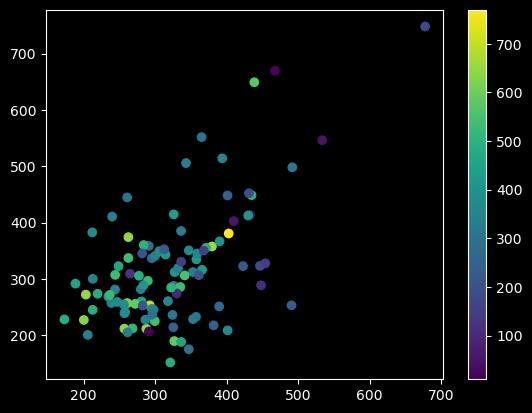

In [37]:
plt.scatter(G1_transition_area, S_transition_area, c=G1_length, cmap='viridis')
plt.colorbar()

In [292]:
from scipy.stats import binned_statistic
time_cutoff=400

G1_length_mean, _, _=binned_statistic(G1_transition_time[G1_transition_time<time_cutoff], G1_length[G1_transition_time<time_cutoff], statistic='mean', bins=15)
G1_length_std, bin_edges, _=binned_statistic(G1_transition_time[G1_transition_time<time_cutoff], G1_length[G1_transition_time<time_cutoff], statistic='std', bins=15)
bins=bin_edges[:-1]+np.diff(bin_edges)

<ErrorbarContainer object of 3 artists>

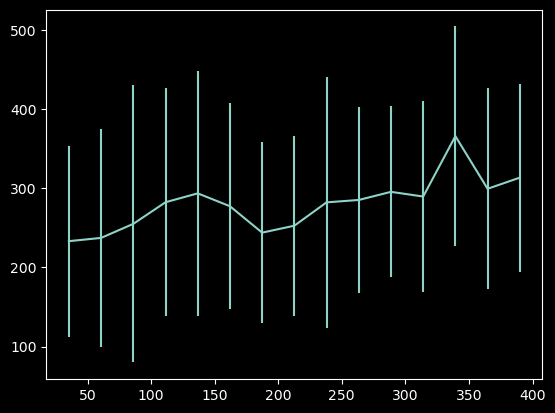

In [293]:
plt.errorbar(bins, G1_length_mean, yerr=G1_length_std)

In [270]:
indices=np.digitize(G1_transition_density[G1_transition_time<400], bins=np.linspace(2500,6500,21))
#plt.scatter(G1_transition_density[G1_transition_time<400], G1_length[G1_transition_time<400], color='lime', alpha=0.7)

array([13, 13, 14, 14, 14, 14, 15, 15, 15, 15, 16, 16, 16, 16, 16, 16, 16,
       16, 16, 17, 17, 17, 17, 18, 18, 18, 18, 19, 19, 19, 19, 19, 10, 10,
       10, 11, 11, 11, 12, 12, 13, 13, 13, 13, 13, 13, 14, 13, 13, 13, 13,
       13, 14, 14, 14, 14, 15, 15, 15, 15, 16, 16, 16, 16, 16, 16, 17, 13,
       14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 15, 15, 15, 15, 15, 15, 16,
       17, 17, 17, 18, 19, 20,  9,  9,  9,  9, 10, 10, 10, 10, 10, 10, 10,
       10, 10, 11, 11, 11, 11, 12, 12, 12, 12, 12, 12, 12, 12, 12, 13, 13,
       13, 13, 13, 13, 14, 14, 14, 14, 15, 16, 16, 16, 16,  5,  5,  5,  5,
        6,  6,  6,  6,  6,  6,  6,  7,  7,  7,  7,  7,  7,  7,  7,  7,  8,
        8,  8,  8,  8,  8,  8,  8,  8,  8,  8,  9,  9,  9,  9, 10, 10, 10,
        2,  2,  2,  3,  3,  3,  3,  3,  3,  3,  3,  4,  4,  4,  4,  4,  4,
        4,  4,  4,  4,  4,  4,  4,  4,  4,  4,  4,  4,  4,  4,  4,  4,  4,
        4,  4,  5,  5,  5,  5,  5,  5,  5,  5,  5,  2,  2,  2,  2,  3,  3,
        3,  3,  3,  3,  3

([<matplotlib.axis.YTick at 0x211c6691790>,
 [Text(0, 1, 'G1'), Text(0, 2, 'S'), Text(0, 3, 'G2')])

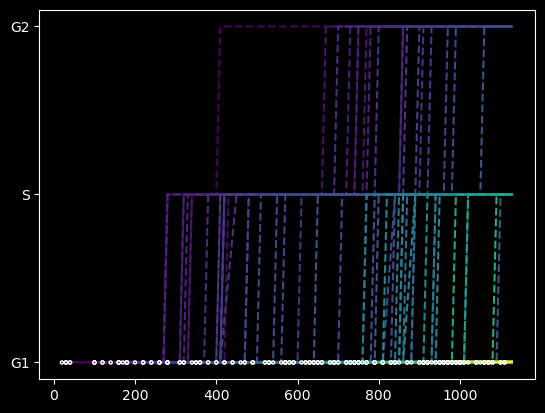

In [177]:
colors=plt.cm.viridis(np.linspace(0,1,len(cell_cycles)))
for cycle, color in zip(cell_cycles, colors):
    plt.plot(cycle['frame']*10, cycle['cell_cycle'], '--', color=color)

starting_points=np.array([cycle.iloc[0] for cycle in cell_cycles]).T
plt.scatter(starting_points[0]*10, starting_points[1], s=5, zorder=3, cmap='viridis', c=np.linspace(0,1,len(cell_cycles)), ec='white')
plt.yticks([1,2,3],['G1', 'S', 'G2'])

plt.ylabel('cell cycle stage')
plt.xlabel('time (min)')

# Deprecated: traditional approach to thresholding FUCCI levels

In [ ]:
import preprocessing

def denoise_FUCCI(img_channel, gaussian_sigma=250, denoise_h=4, norm_range=None):
    if norm_range is None:
        norm_range=np.quantile(img_channel, (0.001, 0.999))
    img_8bit=((img_channel-norm_range[0])*255/(norm_range[1]-norm_range[0]))
    img_8bit=np.clip(img_8bit, a_min=0, a_max=255).astype('uint8')

    denoised=cv2.fastNlMeansDenoising(img_8bit, h=denoise_h)
    blur_bg=ndimage.gaussian_filter(denoised.astype('float'), sigma=gaussian_sigma, truncate=3) # finding the background via large gaussian blur is the time bottleneck
    img_subtracted=denoised-blur_bg
    img_subtracted=np.clip(img_subtracted-img_subtracted.min(), a_min=None, a_max=255).astype('uint8')
    return img_subtracted

def normalize_FUCCI_fluorescence(img, masks=None):
    # NB: this should eventually be done at a stack level rather than image by image? maintain relative fluorescences as best we can.
    if masks is not None:
        img_data=img[masks!=0]
    else:
        img_data=img.flatten()

    lower_bound=np.exp(np.log(img_data.astype(np.uint16)+1).mean())
    std=img_data.std()

    return np.clip((img-lower_bound)/std, a_min=0, a_max=None)

def color_threshold(self, FUCCI_channel, threshold):
    fluor_threshold=lambda x: np.sum(x>threshold)/x.size
    percent_fluorescent=ndimage.labeled_comprehension(FUCCI_channel, self.masks, index=np.arange(1, self.masks.max()+1), func=fluor_threshold, out_dtype=np.float32, default=None)
    return percent_fluorescent

def get_FUCCI(self):
    red=self.img[...,0]
    green=self.img[...,1]

    red_denoised=preprocessing.denoise_FUCCI(red)
    green_denoised=preprocessing.denoise_FUCCI(green)
    self.FUCCI=np.array([red_denoised, green_denoised])
    
def measure_FUCCI(self, use_masks=False, percent_threshold=0.15, red_fluor_threshold=0.2, green_fluor_threshold=0.2):
    if not hasattr(self, 'FUCCI'):
        get_FUCCI(self)

    if use_masks:
        masks=self.masks
    else:
        masks=None

    red=normalize_FUCCI_fluorescence(self.FUCCI[0], masks)
    green=normalize_FUCCI_fluorescence(self.FUCCI[1], masks)

    red_percentages=color_threshold(self, red, red_fluor_threshold)
    green_percentages=color_threshold(self, green, green_fluor_threshold)

    for cell, red_percentage, green_percentage in zip(self.cells, red_percentages, green_percentages):
        cell.red=red_percentage>percent_threshold
        cell.green=green_percentage>percent_threshold
        if cell.red and cell.green:
            mask=self.masks==cell.n+1
            red_mask=red[mask]>red_fluor_threshold
            green_mask=green[mask]>green_fluor_threshold
            colocalized_percentage=np.sum(red_mask&green_mask)/red_mask.size
            if colocalized_percentage>percent_threshold:
                cell.orange=True
                cell.red=False
                cell.green=False
            else: # decided it's not G2, so pick red or green depending on which occupies more space
                cell.orange=False
                if red_percentage<green_percentage:
                    cell.red=False
                else:
                    cell.green=False
        else:
            cell.orange=False
                
    return(red_percentages, green_percentages)

In [ ]:
image=Image('F:/my_data/Segmentation/20240215 FUCCI halo col_glass test/segmented/FUCCI-stage_1/FUCCI-stage_1-000_seg.npy', load_img=True)#Image('C:/Users/Andy/Desktop/FUCCI-stage_1-000_seg.npy')

In [ ]:
measure_FUCCI(image, use_masks=True, red_fluor_threshold=0.1, green_fluor_threshold=0.3, percent_threshold=0.3)

(array([0.42423645, 0.634159  , 0.7464584 , 0.35260984, 0.2464986 ,
        0.5434496 , 0.23855908, 0.5425645 , 0.3405562 , 0.3199895 ,
        0.3457792 , 0.3997488 , 0.39927208, 0.31955242, 0.3124711 ,
        0.51735383, 0.59711164, 0.35040635, 0.61413693, 0.48101684,
        0.24476609, 0.23473522, 0.5650253 , 0.22658114, 0.6062083 ,
        0.5411108 , 0.6296197 , 0.6774784 , 0.22024019, 0.26545268],
       dtype=float32),
 array([0.22463053, 0.28494716, 0.5405359 , 0.4030542 , 0.2184874 ,
        0.417327  , 0.2903878 , 0.16695113, 0.67381227, 0.16563854,
        0.31238404, 0.10447591, 0.34280938, 0.18987043, 0.64553446,
        0.18926159, 0.41510832, 0.12492912, 0.16910884, 0.5735666 ,
        0.1497803 , 0.4099483 , 0.3831633 , 0.42571598, 0.21828674,
        0.90906614, 0.11930905, 0.33228266, 0.3338043 , 0.39215183],
       dtype=float32))

In [ ]:
image.get_centroids()

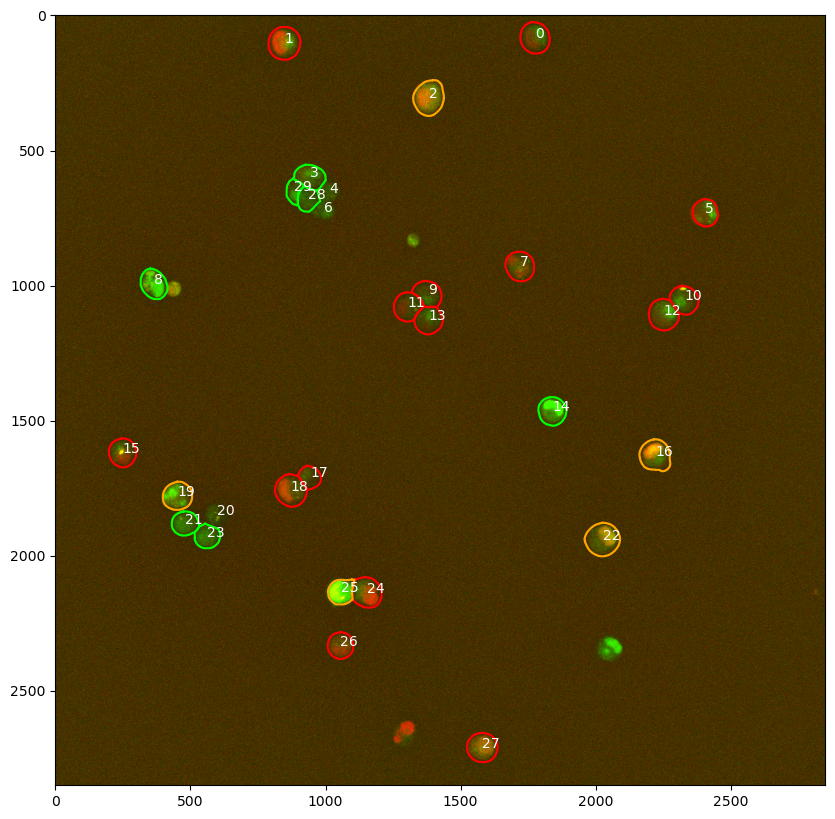

In [ ]:
color_FUCCI=np.stack([image.FUCCI[0],image.FUCCI[1], np.zeros(image.FUCCI[0].shape, dtype='uint8')], axis=-1)
plt.figure(figsize=(10,10))
plt.imshow(color_FUCCI)
for cell in image.cells:
    plt.text(x=cell.centroid[1],y=cell.centroid[0],s=cell.n, color='white')
    if cell.orange:
        plt.plot(*cell.outline.T, color='orange')
    elif cell.red:
        plt.plot(*cell.outline.T, color='red')
    elif cell.green:
        plt.plot(*cell.outline.T, color='lime')

In [ ]:
image=Image('C:/Users/Andy/Desktop/C2-MAX_fucci sc wt-08-1_seg.npy', load_img=True)

In [ ]:
%%timeit
FUCCI_normalized=normalize_FUCCI_fluorescence(image.FUCCI[0])
FUCCI_threshold=FUCCI_normalized>threshold
for cell in image.cells:
    threshold_pixels=FUCCI_threshold[image.masks==cell.n+1]
    cell.red=np.sum(threshold_pixels)/threshold_pixels.size>threshold

3.04 s ± 383 ms per loop (mean ± std. dev. of 7 runs, 1 loop each)


In [ ]:
orange_candidates=[]
for cell in image.cells:
    if cell.red and cell.green:
        orange_candidates.append(cell)

In [ ]:
CoVs=[]
for orange_candidate in orange_candidates:
    mask=image.masks==orange_candidate.n+1
    red_mask=normalize_FUCCI_fluorescence(image.FUCCI[0][mask])>threshold
    green_mask=normalize_FUCCI_fluorescence(image.FUCCI[1][mask])>threshold
    orange_size=np.sum(red_mask&green_mask)/red_mask.size
    CoVs.append(orange_size)
    continue
    CoV=(red_mask/green_mask).std()/(red_mask/green_mask).mean()
    CoVs.append(np.sum(np.abs(red_mask-green_mask))/red_mask.size)

(array([4., 3., 1., 0., 0., 0., 0., 0., 1., 1.]),
 array([0.        , 0.03889491, 0.07778982, 0.11668472, 0.15557963,
        0.19447454, 0.23336945, 0.27226436, 0.31115926, 0.35005417,
        0.38894908]),
 [<matplotlib.patches.Polygon at 0x17b5193d510>])

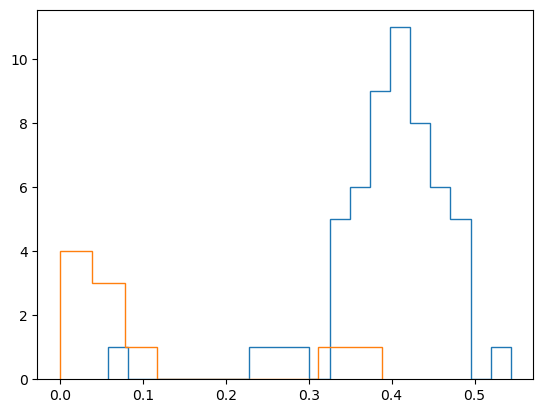

In [ ]:
plt.hist(np.delete(CoVs, [4, 5, 22, 23, 42, 44, 48, 53, 56, 62]), bins=20, histtype='step')
plt.hist(np.array(CoVs)[[4, 5, 22, 23, 42, 44, 48, 53, 56, 62]], bins=10, histtype='step')

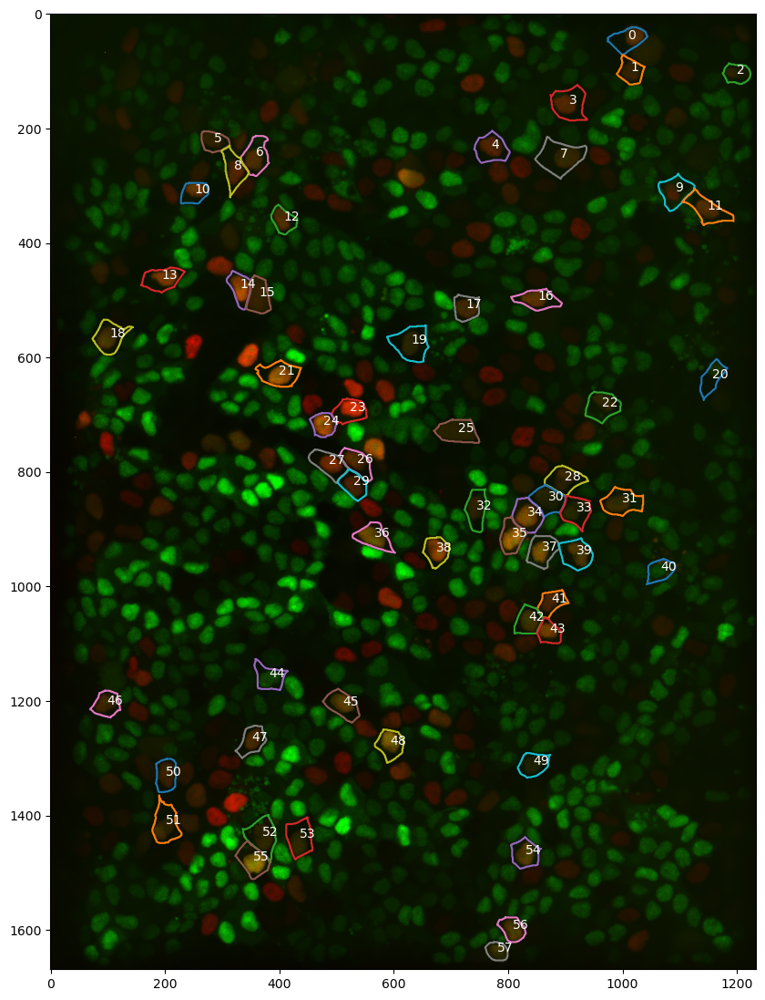

In [ ]:
color_FUCCI=np.stack([image.FUCCI[0], image.FUCCI[1], np.zeros(image.FUCCI[0].shape, dtype='uint8')], axis=-1)
plt.figure(figsize=(10,14))
plt.imshow(color_FUCCI)
#plt.imshow(normalize_FUCCI_fluorescence(image.FUCCI[1])>0.15, cmap='gray_r')
for n, orange_candidate in enumerate(orange_cells):
    plt.plot(*orange_candidate.outline.T)
    plt.text(s=n, x=orange_candidate.centroid[1], y=orange_candidate.centroid[0], color='white')

In [ ]:
from glob import glob
from natsort import natsorted

# preprocess FUCCI
for stack_path in natsorted(glob('F:/my_data/Segmentation/20240215 FUCCI halo col_glass test/segmented/*/')):
    print(stack_path)
    stack=Stack(stack_path, load_img=True)
    fluor=np.array([frame.img[:,:,:2].flatten() for frame in stack.frames])
    norm_range=np.quantile(fluor, [0.001,0.999])
    
    for frame in tqdm(stack.frames):
        frame.get_FUCCI(denoise_kwargs={'norm_range':norm_range})
        frame.to_seg_npy(frame.name)

F:/my_data/Segmentation/20240215 FUCCI halo col_glass test/segmented\FUCCI-stage_1\


100%|██████████| 134/134 [11:16<00:00,  5.05s/it]


F:/my_data/Segmentation/20240215 FUCCI halo col_glass test/segmented\FUCCI-stage_2\


100%|██████████| 134/134 [11:11<00:00,  5.01s/it]


F:/my_data/Segmentation/20240215 FUCCI halo col_glass test/segmented\FUCCI-stage_3\


100%|██████████| 134/134 [11:11<00:00,  5.01s/it]


F:/my_data/Segmentation/20240215 FUCCI halo col_glass test/segmented\FUCCI-stage_4\


100%|██████████| 134/134 [11:11<00:00,  5.01s/it]


F:/my_data/Segmentation/20240215 FUCCI halo col_glass test/segmented\FUCCI-stage_5\


100%|██████████| 134/134 [11:11<00:00,  5.01s/it]


F:/my_data/Segmentation/20240215 FUCCI halo col_glass test/segmented\FUCCI-stage_6\


100%|██████████| 134/134 [11:11<00:00,  5.01s/it]


F:/my_data/Segmentation/20240215 FUCCI halo col_glass test/segmented\FUCCI-stage_7\


100%|██████████| 134/134 [11:11<00:00,  5.01s/it]


F:/my_data/Segmentation/20240215 FUCCI halo col_glass test/segmented\FUCCI-stage_8\


100%|██████████| 134/134 [11:11<00:00,  5.01s/it]


F:/my_data/Segmentation/20240215 FUCCI halo col_glass test/segmented\FUCCI-stage_9\


100%|██████████| 134/134 [11:10<00:00,  5.01s/it]


F:/my_data/Segmentation/20240215 FUCCI halo col_glass test/segmented\FUCCI-stage_10\


100%|██████████| 134/134 [11:10<00:00,  5.00s/it]


In [ ]:
red=image.img[...,0]
green=image.img[...,1]

red_denoised=denoise_FUCCI(red)
green_denoised=denoise_FUCCI(green)

red_FUCCI=normalize_FUCCI_fluorescence(red_denoised)
green_FUCCI=normalize_FUCCI_fluorescence(green_denoised)

In [ ]:
green=image.img[...,1]
green_denoised=denoise_FUCCI(green, denoise_h=4, norm_range=np.quantile(green, (0.01, 0.999)))
green_FUCCI=normalize_FUCCI_fluorescence(green_denoised)

In [ ]:
green_FUCCI_maskednorm=normalize_FUCCI_fluorescence(green_denoised, image.masks)

In [ ]:
red=image.img[...,0]
red_denoised=denoise_FUCCI(red, denoise_h=4, norm_range=np.quantile(red, (0.01, 0.999)))
red_FUCCI=normalize_FUCCI_fluorescence(red_denoised)


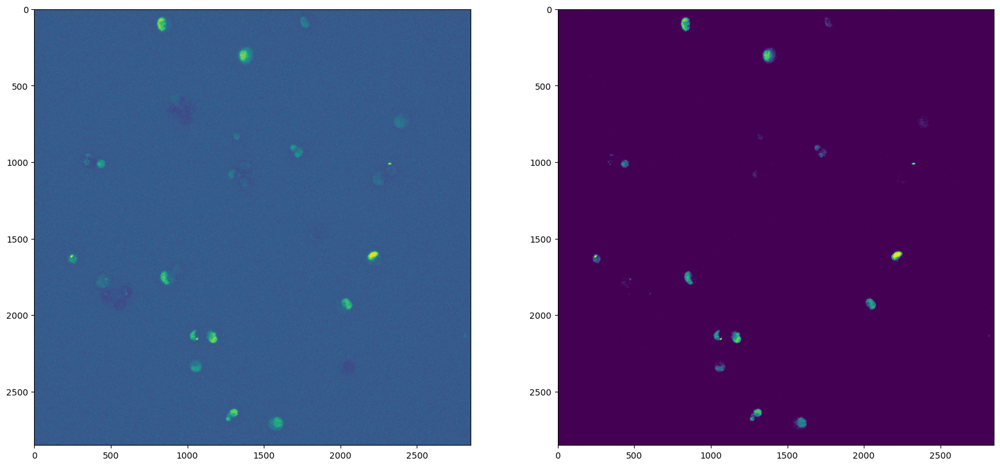

In [ ]:
red_FUCCI_maskednorm=normalize_FUCCI_fluorescence(red_denoised, image.masks)
fig, axes=plt.subplots(1,2, figsize=(20,10))
axes[0].imshow(red)
axes[1].imshow(red_FUCCI_maskednorm, vmin=0.5)

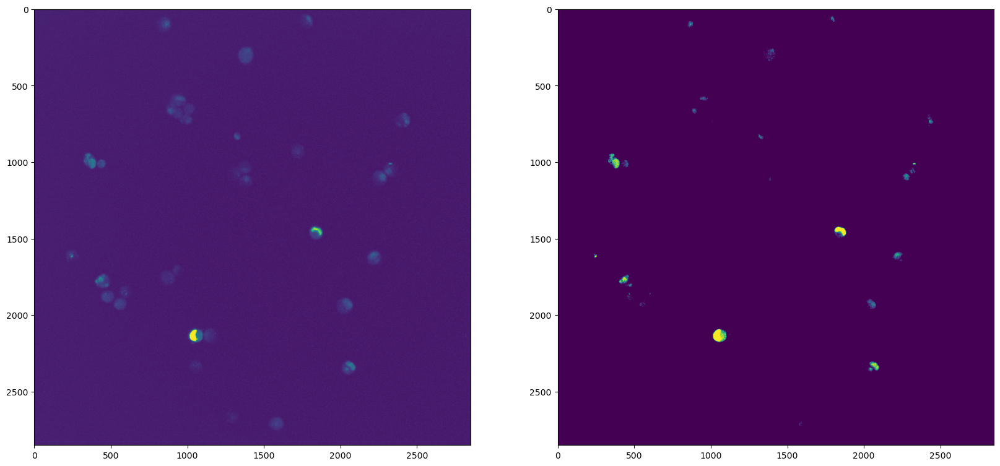

In [ ]:
fig, axes=plt.subplots(1,2, figsize=(20,10))
axes[0].imshow(green)
axes[1].imshow(green_FUCCI_maskednorm, vmin=0.8)

(array([168953.,  25804.,  18040.,  11638.,   7153.,   5000.,   3465.,
          2394.,   1788.,   9124.]),
 array([0.        , 0.34841526, 0.69683051, 1.04524577, 1.39366102,
        1.74207628, 2.09049153, 2.43890667, 2.78732204, 3.13573742,
        3.48415256]),
 <BarContainer object of 10 artists>)

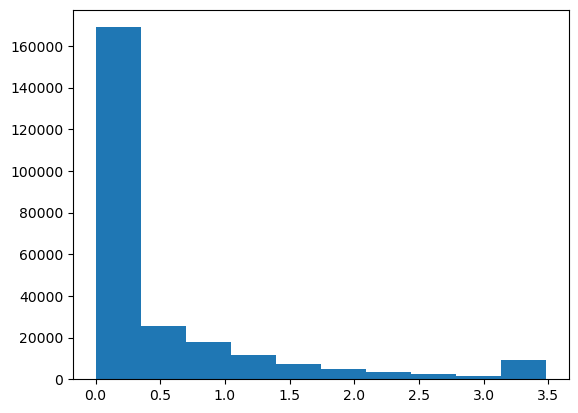

In [ ]:
plt.hist(green_FUCCI_maskednorm[image.masks!=0])

(array([8.85002323e-04, 4.60698013e-03, 7.75719829e-03, 1.25627554e-02,
        1.55192246e-02, 1.94167738e-02, 2.01087997e-02, 2.14218553e-02,
        1.85720131e-02, 1.60451904e-02, 1.54269851e-02, 1.05225258e-02,
        7.96359664e-03, 5.86497203e-03, 4.86747657e-03, 3.38635719e-03,
        2.61809667e-03, 1.97246815e-03, 1.51370859e-03, 1.03529895e-03,
        9.65123507e-04, 5.62369115e-04, 4.64456635e-04, 3.40690046e-04,
        2.49898913e-04, 2.10115933e-04, 1.65070399e-04, 1.18962697e-04,
        1.03706118e-04, 8.59389616e-05, 7.88176151e-05, 5.75018558e-05,
        4.69526068e-05, 4.58421596e-05, 3.88173737e-05, 3.20581295e-05,
        2.72059578e-05, 2.83164050e-05, 2.49367830e-05, 1.90707246e-05,
        2.36090743e-05, 1.61256254e-05, 1.83706601e-05, 1.62463262e-05,
        1.38323104e-05, 1.11044726e-05, 1.22149198e-05, 1.01147261e-05,
        1.15631356e-05, 2.12119566e-04]),
 array([  0. ,   5.1,  10.2,  15.3,  20.4,  25.5,  30.6,  35.7,  40.8,
         45.9,  51. ,  

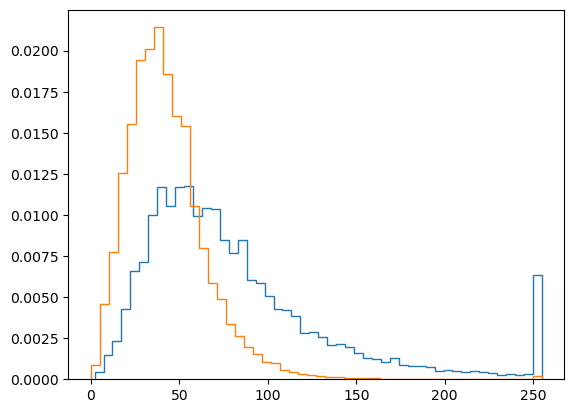

In [ ]:
plt.hist(green_denoised[image.masks!=0], density=True, bins=50, histtype='step')
plt.hist(green_denoised.flatten(), density=True, bins=50, histtype='step')

(array([4.843609e+06, 6.914480e+05, 5.609190e+05, 5.678430e+05,
        3.564170e+05, 2.984350e+05, 2.016340e+05, 1.402790e+05,
        1.268550e+05, 7.460900e+04, 6.921900e+04, 4.093300e+04,
        2.888000e+04, 2.743100e+04, 1.589900e+04, 1.493500e+04,
        9.034000e+03, 7.832000e+03, 6.880000e+03, 4.131000e+03,
        4.424000e+03, 2.660000e+03, 2.987000e+03, 1.945000e+03,
        1.899000e+03, 1.868000e+03, 1.252000e+03, 1.450000e+03,
        1.040000e+03, 9.590000e+02, 9.450000e+02, 8.130000e+02,
        9.110000e+02, 5.810000e+02, 6.610000e+02, 5.920000e+02,
        5.390000e+02, 4.860000e+02, 4.790000e+02, 8.787000e+03]),
 array([0.        , 0.22754224, 0.45508447, 0.68262672, 0.91016895,
        1.13771117, 1.36525345, 1.59279561, 1.82033789, 2.04788017,
        2.27542233, 2.5029645 , 2.7305069 , 2.95804906, 3.18559122,
        3.41313362, 3.64067578, 3.86821795, 4.09576035, 4.32330227,
        4.55084467, 4.77838707, 5.00592899, 5.23347139, 5.46101379,
        5.68855572

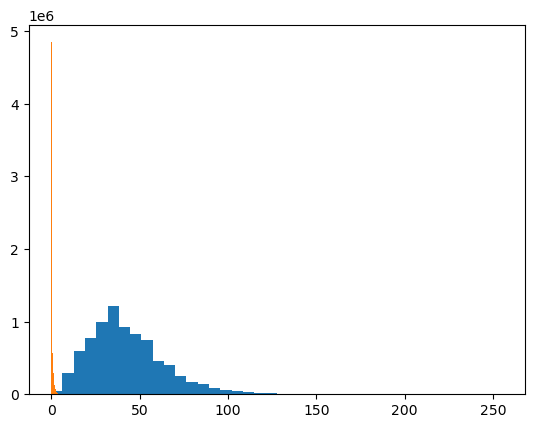

In [ ]:
plt.hist(green_denoised.flatten(), bins=40)
plt.hist(green_FUCCI.flatten(), bins=40)

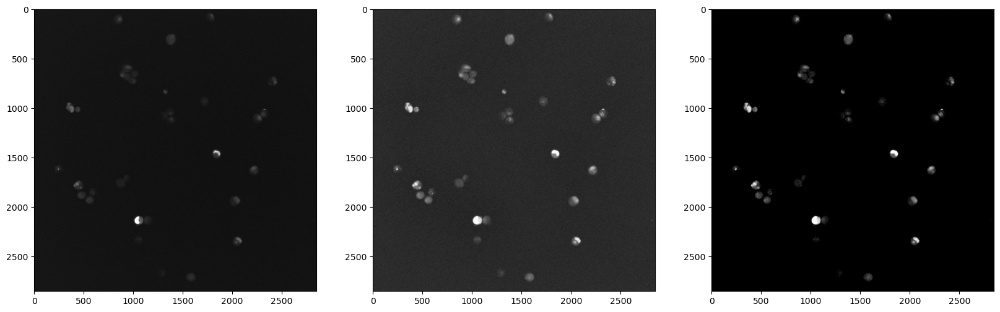

In [ ]:
fig, axes=plt.subplots(1,3, figsize=(20,14))
axes[0].imshow(green, cmap='gray')
axes[1].imshow(green_denoised, cmap='gray')
axes[2].imshow(green_FUCCI, cmap='gray', vmin=0.6)

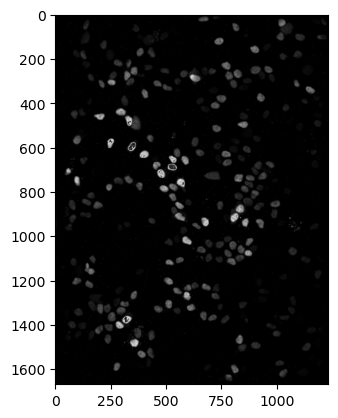

In [ ]:
plt.imshow(red_FUCCI, cmap='gray')

In [ ]:
%%timeit
for cell in image.cells:
    cell_mask=np.where(image.masks==cell.n+1) # optimize? can I get cell masks this way all at once? scipy.ndimage again I think.s
    percent_red=np.sum(red_FUCCI[cell_mask]>0.2)/cell_mask[0].size # TODO: hard thresholds here. Maybe integrated density? Find a way to normalize by (avg?) nucleus size??
    percent_green=np.sum(green_FUCCI[cell_mask]>0.2)/cell_mask[0].size
    cell.red=percent_red>0.15
    cell.green=percent_green>0.15

6 s ± 1.37 s per loop (mean ± std. dev. of 7 runs, 1 loop each)


In [ ]:
%%timeit
red_fluor=[]
for cell in image.cells:
    cell_mask=np.where(image.masks==cell.n+1) # optimize? can I get cell masks this way all at once? scipy.ndimage again I think.
    percent_red=np.sum(red_FUCCI[cell_mask]>0.2)/cell_mask[0].size # TODO: hard thresholds here. Maybe integrated density? Find a way to normalize by (avg?) nucleus size??
    red_fluor.append(percent_red)

np.array(red_fluor)

6.05 s ± 1.43 s per loop (mean ± std. dev. of 7 runs, 1 loop each)


In [ ]:
%%timeit
red_percentage=ndimage.labeled_comprehension(red_FUCCI, image.masks, index=np.arange(1, image.masks.max()+1), func=fluorescent_threshold, out_dtype=np.float32, default=None)

39.8 ms ± 1.17 ms per loop (mean ± std. dev. of 7 runs, 10 loops each)


In [ ]:
%%timeit
for cell, percentage in zip(image.cells, red_percentage):
    cell.red=percentage>0.15

2.27 ms ± 199 µs per loop (mean ± std. dev. of 7 runs, 100 loops each)


In [ ]:
%%timeit
red_FUCCI=normalize_FUCCI_fluorescence(red_denoised)
green_FUCCI=normalize_FUCCI_fluorescence(green_denoised)

71.1 ms ± 14.9 ms per loop (mean ± std. dev. of 7 runs, 10 loops each)


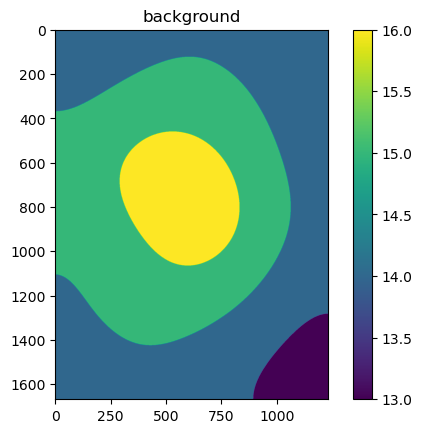

In [ ]:
red_8bit=cv2.normalize(red, None, 0, 255, cv2.NORM_MINMAX, dtype=cv2.CV_8U)
red_denoised=cv2.fastNlMeansDenoising(red_8bit, h=4)
blur_bg=cv2.GaussianBlur(red_denoised.astype('float'),(1801,1801),0)
red_subtracted=cv2.normalize(red_denoised-blur_bg, None, 0, 255, cv2.NORM_MINMAX, dtype=cv2.CV_8U)
plt.imshow(blur_bg.astype('uint8'))
plt.title('background')
plt.colorbar()

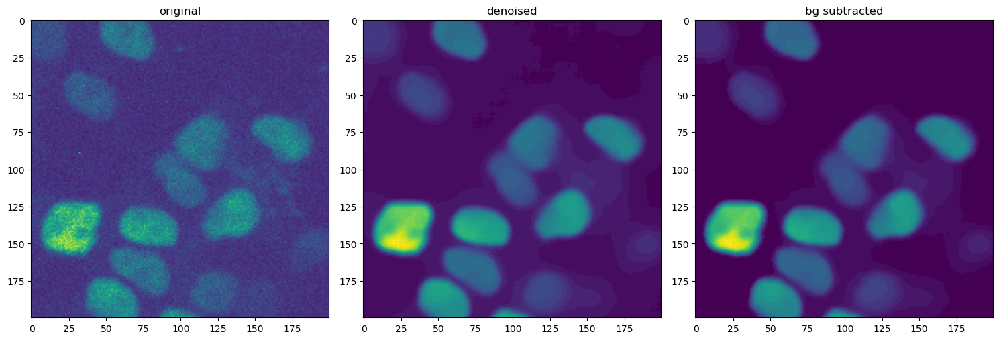

In [ ]:
fig, axes=plt.subplots(1,3,figsize=(15,5))
axes[0].imshow(red_8bit[600:800,800:1000])
axes[0].set_title('original')
axes[1].imshow(red_denoised[600:800,800:1000])
axes[1].set_title('denoised')
axes[2].imshow(red_subtracted[600:800,800:1000], vmin=2)
axes[2].set_title('bg subtracted')

fig.tight_layout()

(-0.5, 1233.5, 1668.5, -0.5)

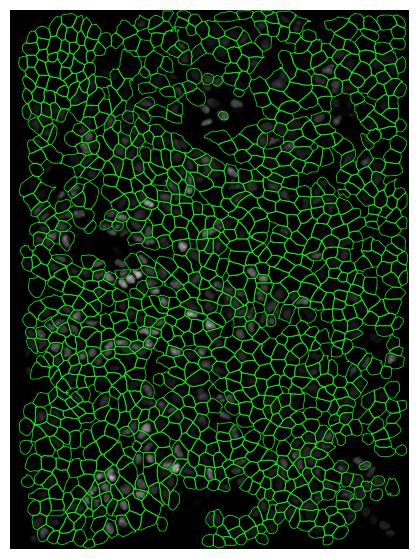

In [ ]:
plt.figure(figsize=(10,7))
plt.imshow(green_FUCCI, vmin=0, vmax=15, cmap='gray')

for cell in image.cells:
    plt.plot(*cell.outline.T, linewidth=0.5, color='lime')

plt.axis('off')

(-0.5, 1233.5, 1668.5, -0.5)

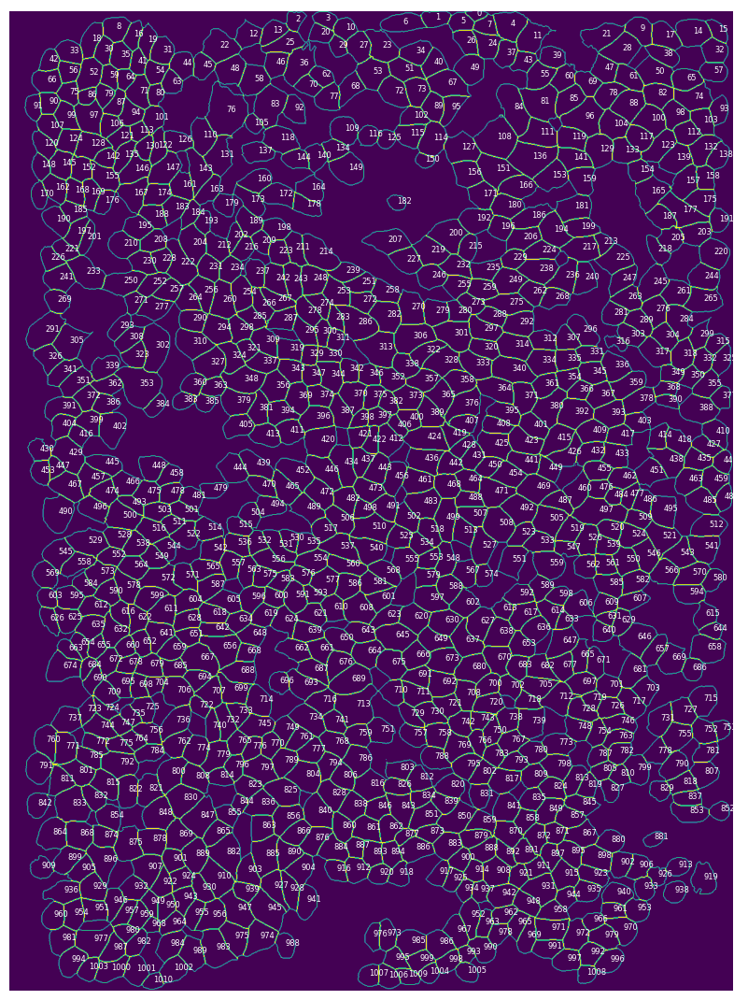

In [ ]:
plt.figure(figsize=(10,14))
plt.imshow(image.outlines.todense()!=0)

for cell in image.cells:
    plt.text(s=cell.n, x=cell.centroid[1], y=cell.centroid[0], color='white', fontsize=6)

plt.axis('off')

In [ ]:
red_denoised=denoise_FUCCI(red)
green_denoised=denoise_FUCCI(green)

red_FUCCI=normalize_FUCCI_fluorescence(red_denoised)
green_FUCCI=normalize_FUCCI_fluorescence(green_denoised)

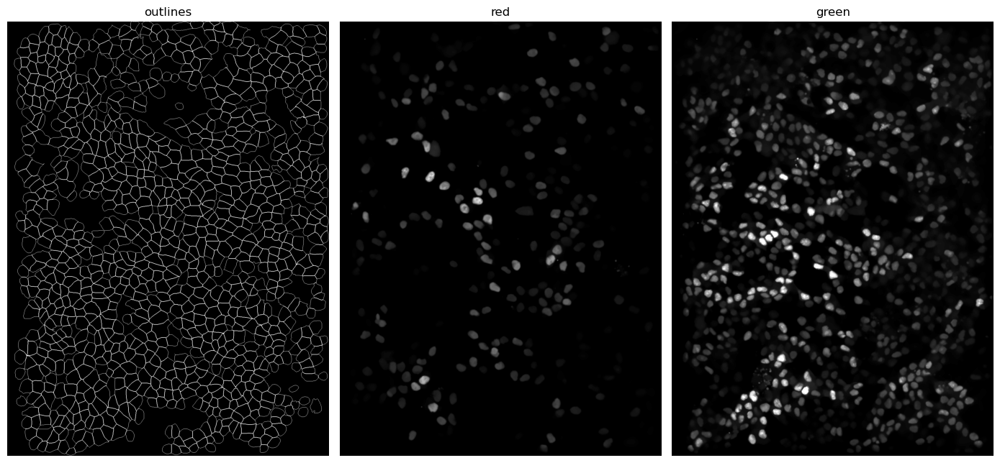

In [ ]:
fig, axes=plt.subplots(1,3,figsize=(14,7))
axes[0].imshow(image.outlines.todense()!=0, cmap='gray')
axes[0].set_title('outlines')
axes[1].imshow(red_denoised, cmap='gray', vmin=3, vmax=100)
axes[1].set_title('red')
axes[2].imshow(green_denoised, cmap='gray', vmin=7, vmax=100)
axes[2].set_title('green')

for ax in axes:
    ax.axis('off')
fig.tight_layout()

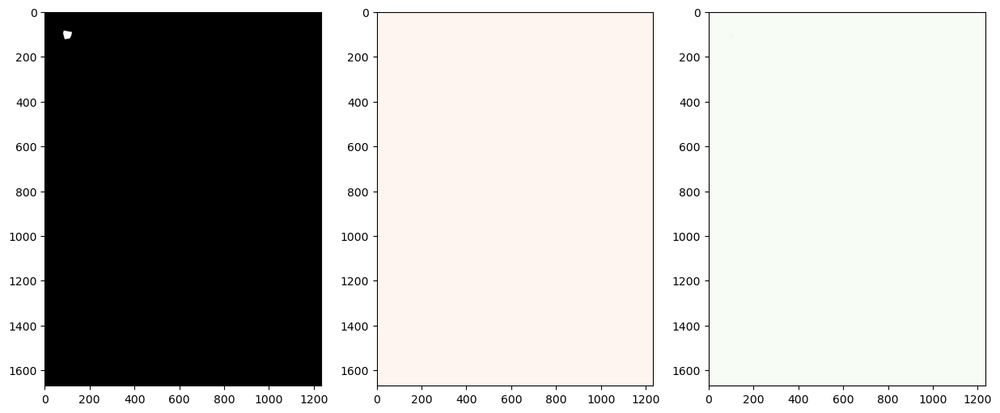

In [ ]:
cell_n=57
cell_mask=np.where(image.masks==cell_n)

demo_mask_r=np.zeros(red.shape)
demo_mask_r[cell_mask]=red_FUCCI[cell_mask]#-np.quantile(red[cell_177_mask], 0.25)

demo_mask_g=np.zeros(red.shape)
demo_mask_g[cell_mask]=green_FUCCI[cell_mask]#-np.quantile(green[cell_177_mask], 0.25)

fig, axes=plt.subplots(1,3, figsize=(15,7))
axes[0].imshow(image.masks==cell_n, cmap='gray')
axes[1].imshow(demo_mask_r, cmap='Reds', vmin=0, vmax=15)
axes[2].imshow(demo_mask_g, cmap='Greens', vmin=0, vmax=15)

percent red fluorescence: 0.0
percent green fluorescence: 31.882770870337477


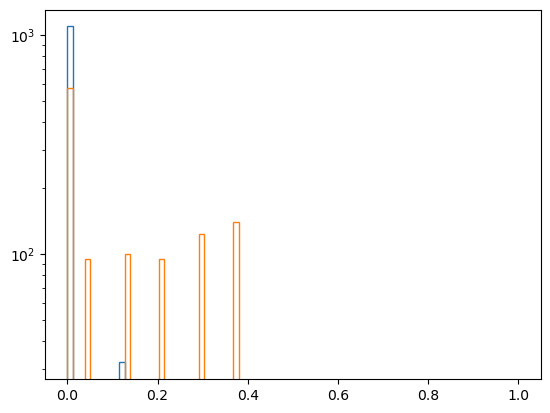

In [ ]:
plt.hist(red_FUCCI[cell_mask], bins=np.linspace(0,1,80), histtype='step')
plt.hist(green_FUCCI[cell_mask], bins=np.linspace(0,1,80), histtype='step')

plt.yscale('log')
print('percent red fluorescence:', np.sum(red_FUCCI[cell_mask]>1)*100/cell_mask[0].size)
print('percent green fluorescence:', np.sum(green_FUCCI[cell_mask]>0.2)*100/cell_mask[0].size)

In [ ]:
for cell in tqdm(image.cells):
    cell_mask=np.where(image.masks==cell.n+1)
    percent_red=np.sum(red_FUCCI[cell_mask]>0.2)*100/cell_mask[0].size
    percent_green=np.sum(green_FUCCI[cell_mask]>0.2)*100/cell_mask[0].size
    cell.red=percent_red>15
    cell.green=percent_green>15

100%|██████████| 1011/1011 [00:04<00:00, 228.58it/s]


In [ ]:
color_raw=np.stack([red/red.max(), green/green.max(), np.zeros(red_FUCCI.shape, dtype=red_FUCCI.dtype)], axis=-1)
color_FUCCI=np.stack([red_FUCCI/red_FUCCI.max(), green_FUCCI/green_FUCCI.max(), np.zeros(red_FUCCI.shape, dtype=red_FUCCI.dtype)], axis=-1)

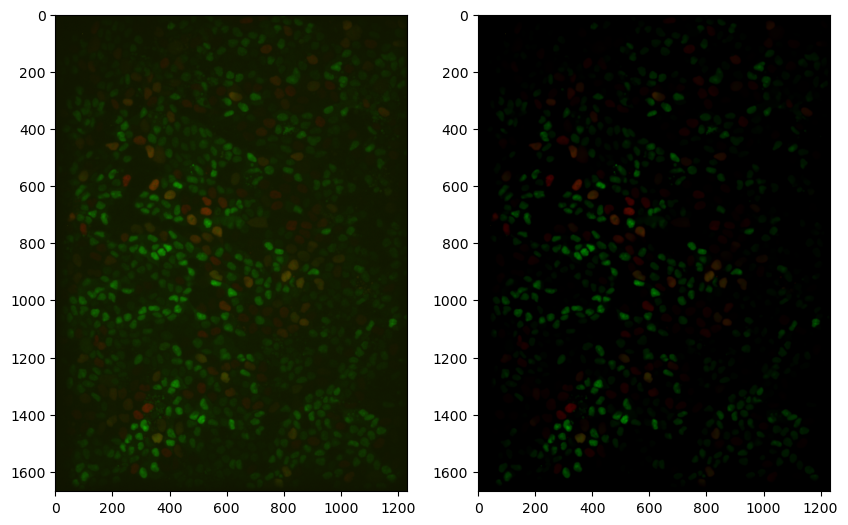

In [ ]:
fig, axes=plt.subplots(1,2, figsize=(10,7))
axes[0].imshow(color_raw)
axes[1].imshow(color_FUCCI)

In [ ]:
image.measure_FUCCI()
color_FUCCI=np.stack([image.FUCCI[0], image.FUCCI[1], np.zeros(image.FUCCI[0].shape, dtype='uint8')], axis=-1)

(-0.5, 1233.5, 1668.5, -0.5)

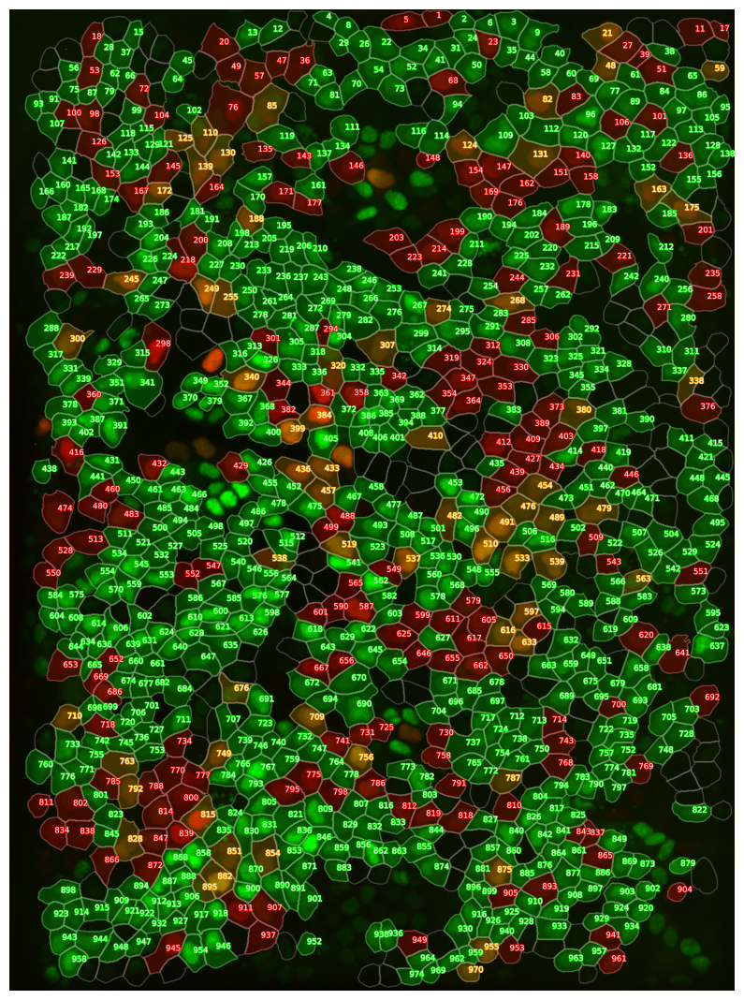

In [ ]:
import matplotlib.patheffects as patheffects

plt.figure(figsize=(10,14))
plt.imshow(color_FUCCI, cmap='gray')
for cell in image.cells:
    plt.plot(*cell.outline.T, color='white', alpha=0.2, linewidth=1)
    if not (cell.red or cell.green or cell.orange):
        continue
    else:
        if cell.red:
            color='r'
        elif cell.green:
            color='lime'
        elif cell.orange:
            color='orange'
        
        plt.fill(*cell.outline.T, color=color, alpha=0.2)
        particle_label=plt.text(cell.centroid[1],cell.centroid[0],s=cell.n, color='white', fontsize=6)
        particle_label.set_path_effects([patheffects.Stroke(linewidth=1, foreground=color),patheffects.Normal()])
    
plt.axis('off')

## deprecated: auto denoise

In [ ]:
frame=stack.frames[0]

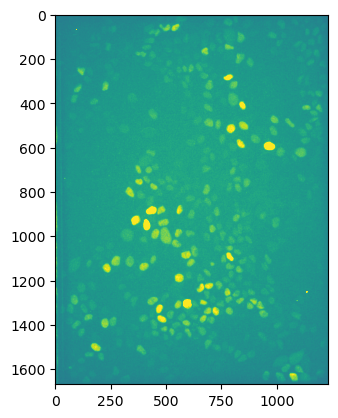

In [ ]:
red=frame.img[...,0]
plt.imshow(red, vmax=200)

In [ ]:
stack.load_img(normalize=False)

In [ ]:
fluor=np.array([frame.img[:,:,:2].flatten() for frame in stack.frames])
norm_range=np.quantile(fluor, [0.001,0.999])

In [ ]:
red_denoised=preprocessing.denoise_FUCCI(red, norm_range=norm_range)

In [ ]:
img_8bit=((red-norm_range[0])*255/(norm_range[1]-norm_range[0]))
img_8bit=np.clip(img_8bit, a_min=0, a_max=255).astype('uint8')

In [ ]:
denoised=cv2.fastNlMeansDenoising(img_8bit, h=11)
blurred=cv2.medianBlur(img_8bit, ksize=3)

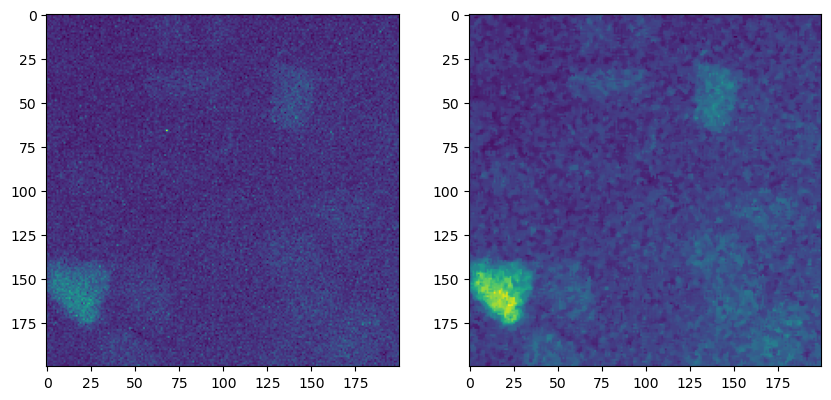

In [ ]:
fig, axes = plt.subplots(1,2, figsize=(10,5))
axes[0].imshow(img_8bit[100:300,100:300])
axes[1].imshow(blurred[100:300,100:300])

In [ ]:
dense_stack=Stack('F:/my_data/Segmentation/20240215 FUCCI halo col_glass test/segmented/FUCCI-stage_1/', load_img=True)

In [ ]:
fluor=np.array([frame.img[:,:,:2].flatten() for frame in dense_stack.frames])
norm_range=np.quantile(fluor, [0.001,0.999])

dense_red=dense_stack.frames[0].img[...,0]
dense_green=dense_stack.frames[0].img[...,1]

dense_img_8bit=((dense_red-norm_range[0])*255/(norm_range[1]-norm_range[0]))
dense_img_8bit=np.clip(dense_img_8bit, a_min=0, a_max=255).astype('uint8')

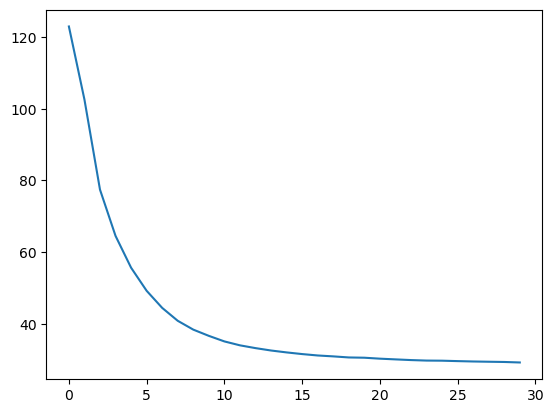

In [ ]:
plt.plot(noise_metric)

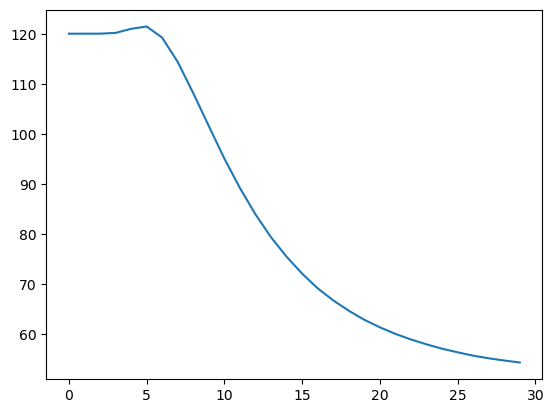

In [ ]:
plt.plot(sparse_noise_metric)

In [ ]:
dense_red_normalized=preprocessing.normalize_FUCCI_fluorescence(cv2.fastNlMeansDenoising(dense_img_8bit, h=4))

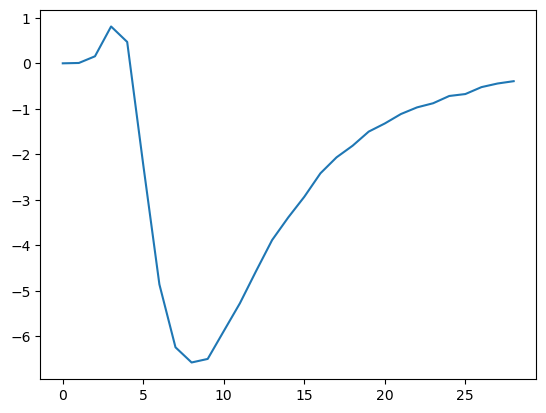

In [ ]:
plt.plot(np.diff(sparse_noise_metric))

In [ ]:
denoise_cutoff=31

noise_metric=[]
for h in np.arange(1,denoise_cutoff):
    denoised=cv2.fastNlMeansDenoising(img_8bit, h=int(h))
    noise_metric.append(np.abs(denoised-cv2.medianBlur(denoised, ksize=3)).std())

    if len(noise_metric)<4:
        continue
    else:
        cutoff_point=np.where(np.diff((np.diff(np.diff(noise_metric))>0).astype(int))==1)[0]
        if len(cutoff_point>0):
            break
denoise_h=cutoff_point[0]+4

In [ ]:
cutoff_point

array([7], dtype=int64)

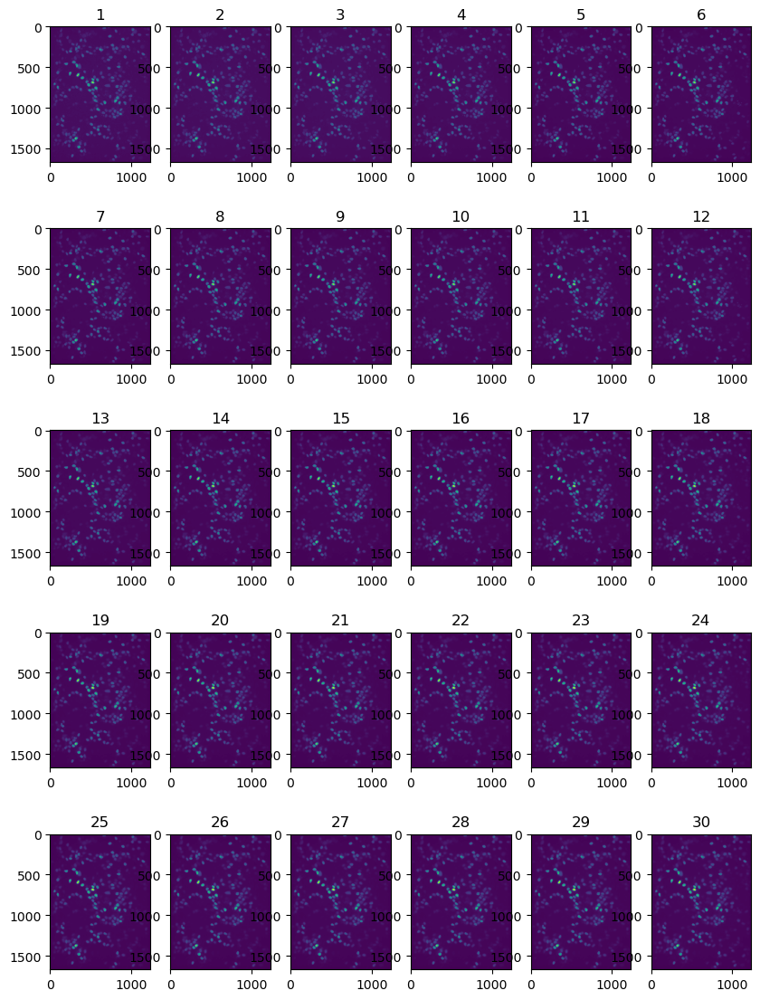

In [ ]:
noise_metric=[]
fig, axes = plt.subplots(5, 6, figsize=(10,14))
for h, ax in zip(np.arange(1,31), axes.flatten()):
    denoised=cv2.fastNlMeansDenoising(dense_img_8bit, h=int(h))
    noise_metric.append(np.abs(denoised-cv2.medianBlur(denoised, ksize=5)).std())
    ax.imshow(denoised)
    ax.set_title(h)

1
8


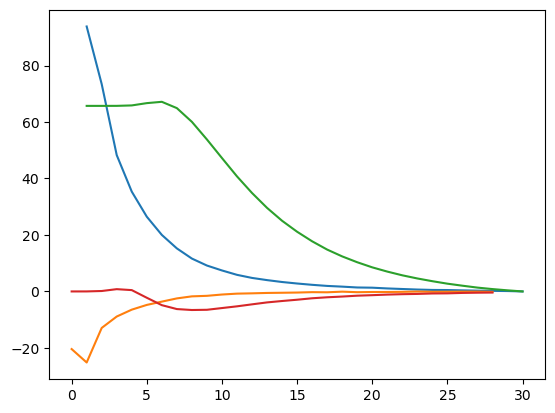

In [ ]:
plt.plot(np.arange(1,31), noise_metric-np.min(noise_metric))
plt.plot(np.diff(noise_metric))
print(np.argmin(np.diff(noise_metric)))
plt.plot(np.arange(1,31), sparse_noise_metric-np.min(sparse_noise_metric))
plt.plot(np.diff(sparse_noise_metric))
print(np.argmin(np.diff(sparse_noise_metric)))

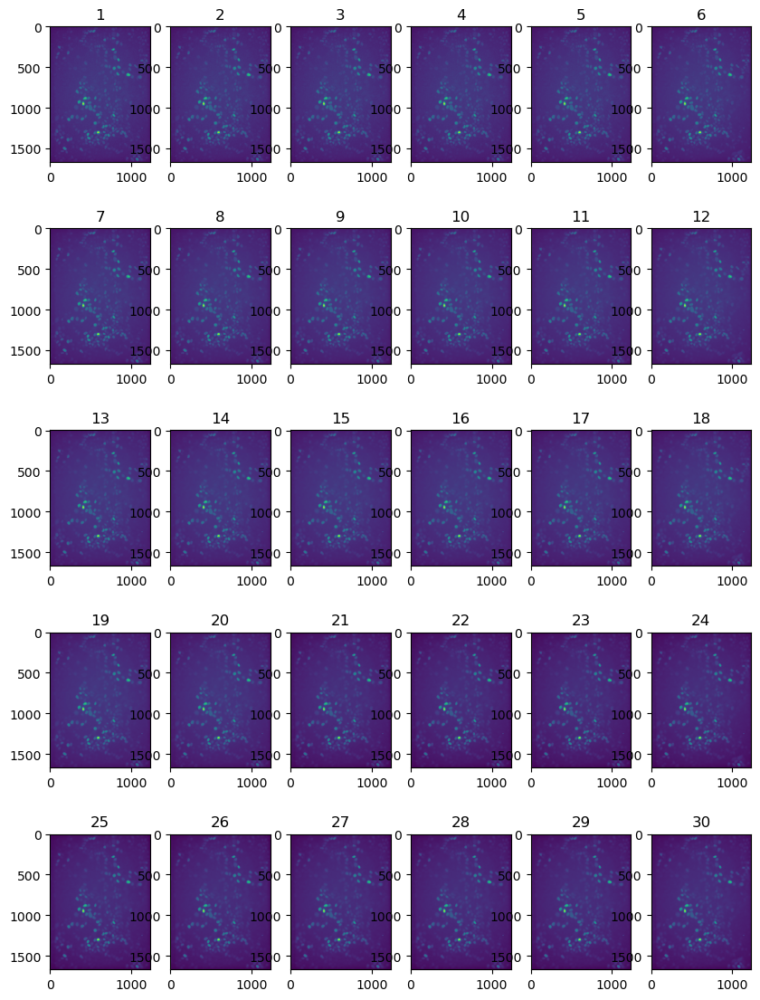

In [ ]:
sparse_noise_metric=[]
fig, axes = plt.subplots(5, 6, figsize=(10,14))
for h, ax in zip(np.arange(1,31), axes.flatten()):
    denoised=cv2.fastNlMeansDenoising(img_8bit, h=int(h))
    sparse_noise_metric.append(np.abs(denoised-cv2.medianBlur(denoised, ksize=5)).std())
    ax.imshow(denoised)
    ax.set_title(h)

## deprecated: background subtraction

In [ ]:
frame=FUCCI_dataset[15].frames[0]

In [ ]:
import importlib

preprocessing=importlib.reload(preprocessing)

In [ ]:
denoised_red, h=preprocessing.denoise_FUCCI(frame.img[...,0], auto_denoise=True)
subtracted_red, blur_bg=preprocessing.subtract_background(denoised_red)
normalized_red=preprocessing.normalize_FUCCI_fluorescence(subtracted_red)
print(h)

17


In [ ]:
denoised_green, h=preprocessing.denoise_FUCCI(frame.img[...,1], auto_denoise=True)
subtracted_green, blur_bg=preprocessing.subtract_background(denoised_green)
normalized_green=preprocessing.normalize_FUCCI_fluorescence(subtracted_green)
print(h)

11


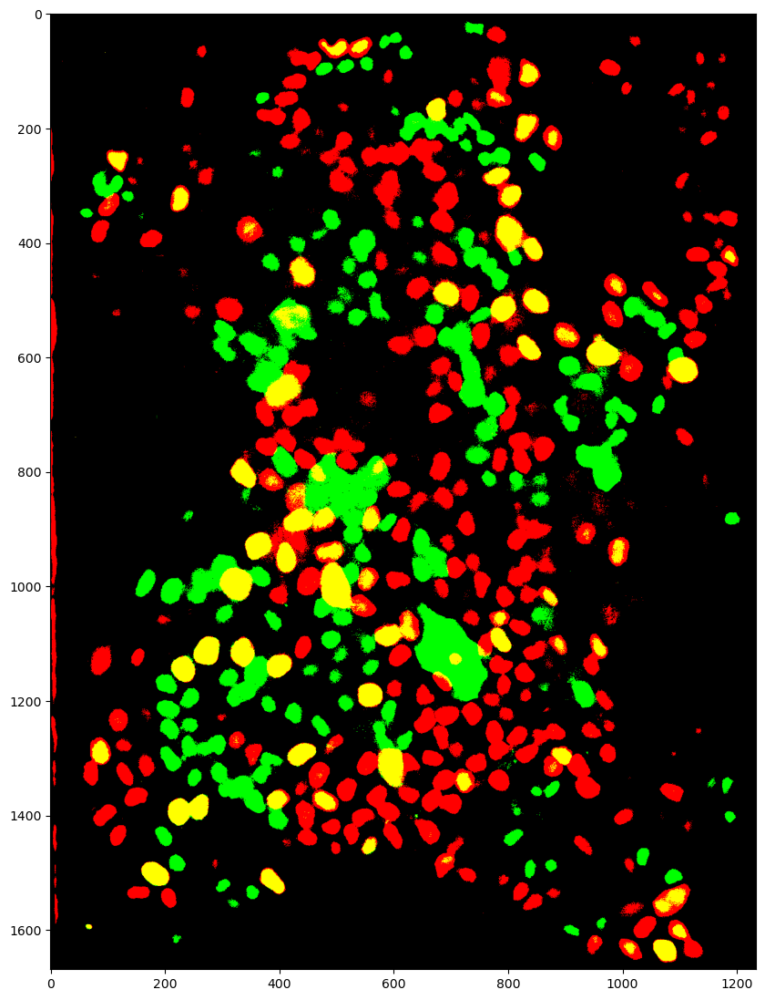

In [ ]:
import preprocessing
#=preprocessing.normalize_FUCCI_fluorescence(frame.FUCCI[0])
threshold=0
color_FUCCI=np.stack([normalized_red>0.4, normalized_green>0.6, np.zeros(frame.masks.shape)], axis=-1)

plt.figure(figsize=(10,14))
plt.imshow(color_FUCCI)

In [ ]:
green_dense=np.load(r'F:\my_data\Segmentation\20240215 FUCCI halo col_glass test\segmented\FUCCI-stage_1\FUCCI-stage_1-000_seg.npy', allow_pickle=True).item()['img'][...,1]

In [ ]:
frame=FUCCI_dataset[15].frames[0]
frame.load_img()
green_sparse=frame.img[...,1]

FileNotFoundError: [Errno 2] No such file or directory: 'F:/my_data/Segmentation/20240221 FUCCI halo col_glass/segmented\\FUCCI-stage_16\\FUCCI-stage_16-000_seg.npy'

In [ ]:
stack=FUCCI_dataset[0]
stack.load_img()
fluor=np.array([frame.img[:,:,:2].flatten() for frame in stack.frames])
norm_range=np.quantile(fluor, [0.001,0.999])

In [ ]:
img_8bit=((green_sparse-norm_range[0])*255/(norm_range[1]-norm_range[0]))
img_8bit=np.clip(img_8bit, a_min=0, a_max=255).astype('uint8')

In [ ]:
norm_range=np.quantile(green_dense, [0.001,0.999])
img_8bit=((green_dense-norm_range[0])*255/(norm_range[1]-norm_range[0]))
img_8bit=np.clip(img_8bit, a_min=0, a_max=255).astype('uint8')

Text(0.5, 1.0, 'sparse, low signal')

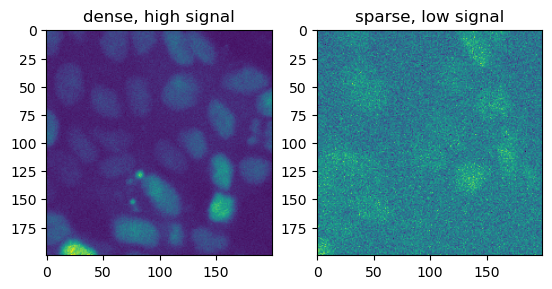

In [ ]:
fig, axes = plt.subplots(1,2)
axes[0].imshow(green_dense[400:600,400:600])
axes[0].set_title('dense, high signal')
axes[1].imshow(green_sparse[400:600,400:600])
axes[1].set_title('sparse, low signal')

Text(0.5, 1.0, 'sparse, denoised h=11')

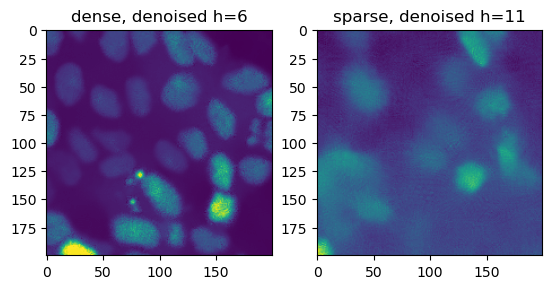

In [ ]:
denoised_dense, h_dense=preprocessing.denoise_FUCCI(green_dense)
denoised_sparse, h_sparse=preprocessing.denoise_FUCCI(green_sparse)

fig, axes = plt.subplots(1,2)
axes[0].imshow(denoised_dense[400:600,400:600])
axes[0].set_title(f'dense, denoised h={h_dense}')
axes[1].imshow(denoised_sparse[400:600,400:600])
axes[1].set_title(f'sparse, denoised h={h_sparse}')

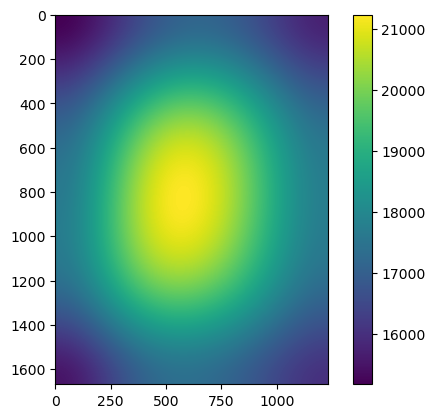

In [ ]:
blur=ndimage.gaussian_filter(frame.FUCCI[1], sigma=250, truncate=4)
plt.imshow(blur)
plt.colorbar()

In [ ]:
blur=ndimage.gaussian_filter(FUCCI_dataset[0].frames[0].FUCCI[1].astype('float'), sigma=250, truncate=4)
blur.std()

829.058344202284

In [ ]:
blur2=ndimage.gaussian_filter(FUCCI_dataset[0].frames[0].FUCCI[1].astype('float')-blur, sigma=250, truncate=4)
blur2.std()

405.5827234447969

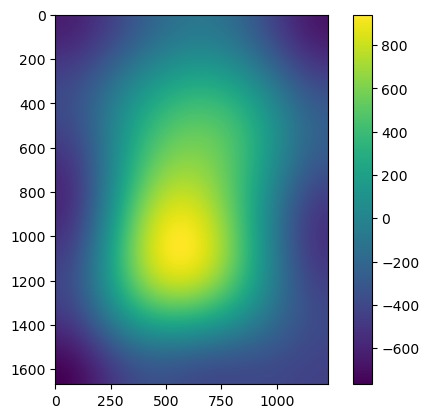

In [ ]:
plt.imshow(blur2)
plt.colorbar()

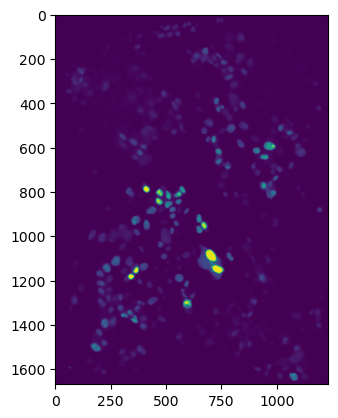

In [ ]:
plt.imshow(np.clip(FUCCI_dataset[0].frames[0].FUCCI[1].astype('float')-blur, a_min=0, a_max=None))

In [ ]:
blur=ndimage.gaussian_filter(frame.FUCCI[1].astype('float'), sigma=250, truncate=4)
blur.std()

1449.2423633643991

In [ ]:
blur2=ndimage.gaussian_filter(frame.FUCCI[1]-blur, sigma=250, truncate=4)
blur2.std()

682.9955570058771

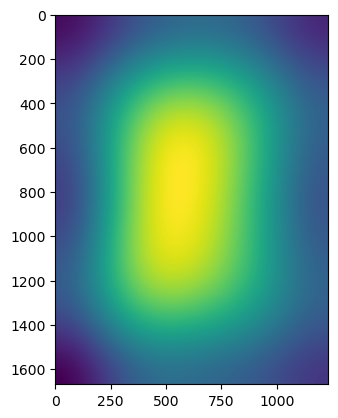

In [ ]:
plt.imshow(blur2)

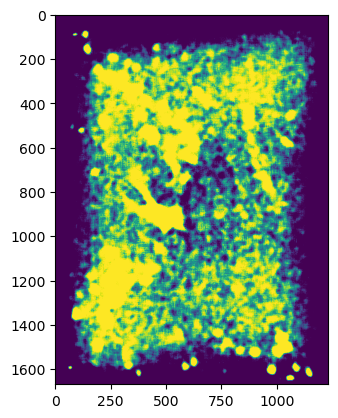

In [ ]:
plt.imshow(np.clip(frame.FUCCI[1]-blur, a_min=0, a_max=1500))

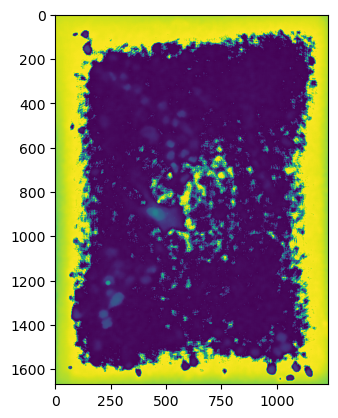

In [ ]:
plt.imshow(frame.FUCCI[1]-blur)

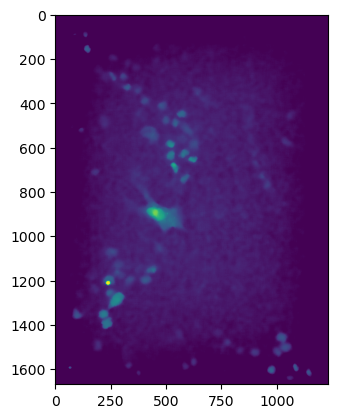

In [ ]:
plt.imshow(preprocessing.normalize_FUCCI_fluorescence(frame.FUCCI[1]))

In [ ]:
blur.std()

0.2040496191876226

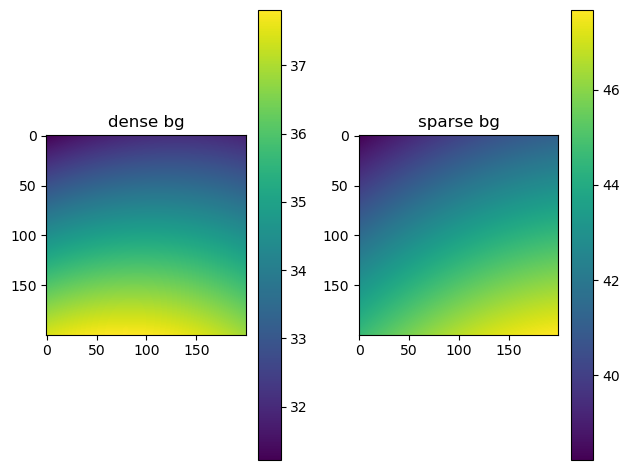

In [ ]:
bg_dense=ndimage.gaussian_filter(denoised_dense.astype('float'), sigma=250, truncate=4)
bg_sparse=ndimage.gaussian_filter(denoised_sparse.astype('float'), sigma=250, truncate=4)

fig, axes = plt.subplots(1,2)
dense_cbar=axes[0].imshow(bg_dense[400:600,400:600])
plt.colorbar(dense_cbar)
axes[0].set_title(f'dense bg')
sparse_cbar=axes[1].imshow(bg_sparse[400:600,400:600])
plt.colorbar(sparse_cbar)
axes[1].set_title(f'sparse bg')

fig.tight_layout()
plt.show()

Text(0.5, 1.0, 'sparse bg subtracted')

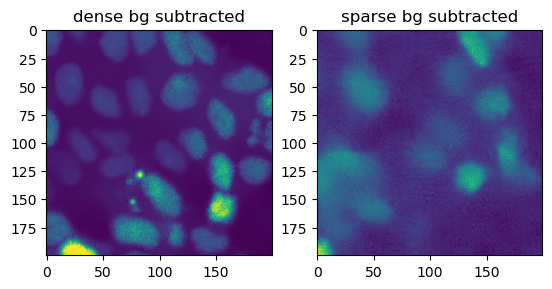

In [ ]:
subtracted_dense=denoised_dense-bg_dense
subtracted_dense-=subtracted_dense.min()

subtracted_sparse=denoised_sparse-bg_sparse
subtracted_sparse-=subtracted_sparse.min()

fig, axes = plt.subplots(1,2)
axes[0].imshow(subtracted_dense[400:600,400:600])
axes[0].set_title(f'dense bg subtracted')
axes[1].imshow(subtracted_sparse[400:600,400:600])
axes[1].set_title(f'sparse bg subtracted')

In [ ]:
import importlib
preprocessing=importlib.reload(preprocessing)

In [ ]:
#ndimage.gaussian_filter(subtracted_dense, sigma=250, truncate=4).std()
ndimage.gaussian_filter(subtracted_sparse, sigma=250, truncate=4).std()

2.824988439588729

In [ ]:
normalized_dense=preprocessing.normalize_FUCCI_fluorescence(subtracted_dense)
normalized_sparse=preprocessing.normalize_FUCCI_fluorescence(subtracted_sparse)

print(ndimage.gaussian_filter(normalized_dense.astype('float'), sigma=250, truncate=4).std())
print(ndimage.gaussian_filter(normalized_sparse.astype('float'), sigma=250, truncate=4).std())

0.09672240636801309
0.12199927830509955


In [ ]:
normalized_dense.dtype

dtype('float64')

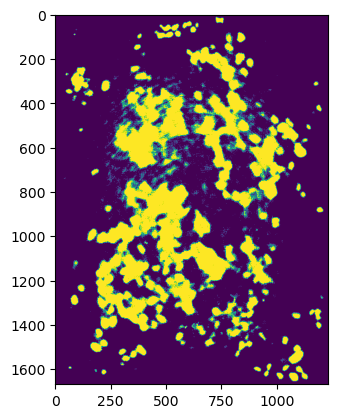

In [ ]:
plt.imshow(normalized_sparse>0.2)

In [ ]:
FUCCI_dataset[1].load_img(normalize=False)
fluor=np.array([frame.img[:,:,:2].flatten() for frame in FUCCI_dataset[1].frames])
norm_range=np.quantile(fluor, [0.001,0.999])

In [ ]:
green_denoised, denoise_h=preprocessing.denoise_FUCCI(green, norm_range=norm_range)

10.235134075519973


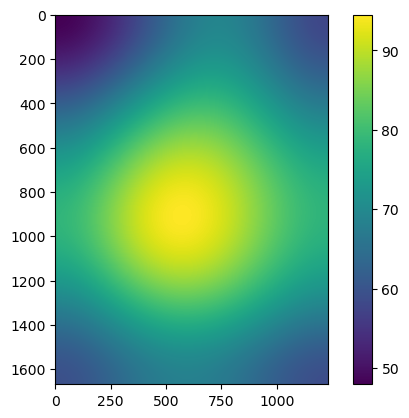

In [ ]:
blur_bg=ndimage.gaussian_filter(green_denoised.astype('float'), sigma=250, truncate=4)
print(blur_bg.flatten().std())
plt.imshow(blur_bg)
plt.colorbar()

4.220863201814176


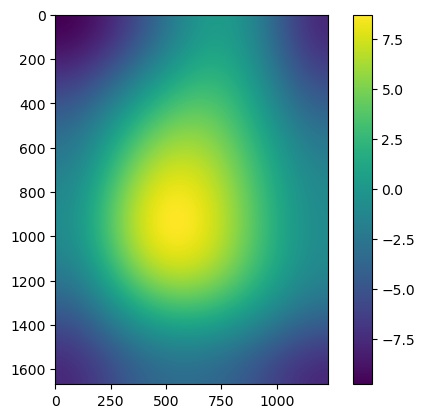

In [ ]:
blur_bg2=ndimage.gaussian_filter((green_denoised-blur_bg).astype('float'), sigma=250, truncate=4)
print(blur_bg2.flatten().std())
plt.imshow(blur_bg2)
plt.colorbar()

1.9938360351682802


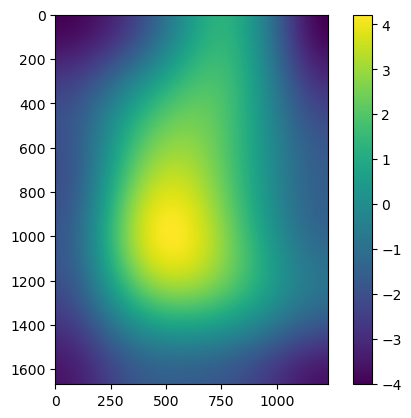

In [ ]:
blur_bg3=ndimage.gaussian_filter((green_denoised-blur_bg-blur_bg2).astype('float'), sigma=250, truncate=4)
print(blur_bg3.flatten().std())
plt.imshow(blur_bg3)
plt.colorbar()

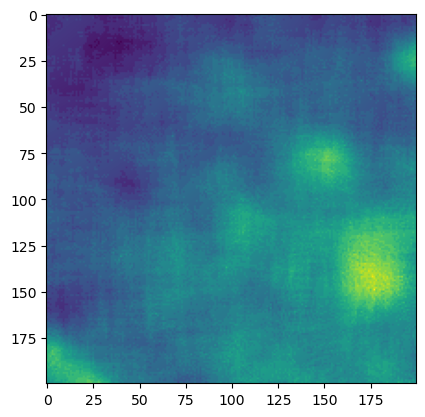

In [ ]:
img=green_denoised-blur_bg-blur_bg2
img-=img.min()

plt.imshow(img[100:300,100:300])

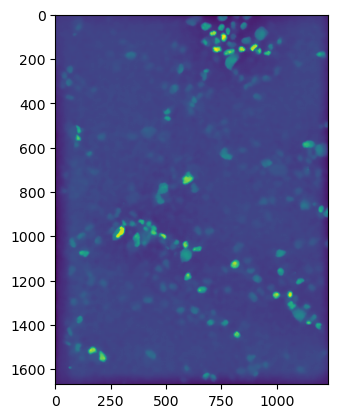

In [ ]:
img=green_denoised-blur_bg
img-=img.min()

plt.imshow(img)

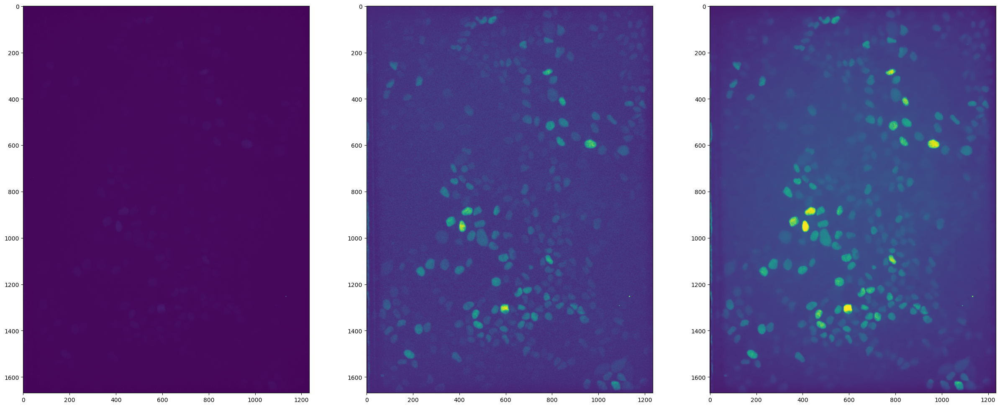

In [ ]:
import cv2
fig, axes=plt.subplots(1,3, figsize=(30,14))

img_channel=frame.img[...,0]
norm_range=np.quantile(img_channel, (0.001, 0.999))

img_8bit=((img_channel-norm_range[0])*255/(norm_range[1]-norm_range[0]))
img_8bit=np.clip(img_8bit, a_min=0, a_max=255).astype('uint8')

denoised=cv2.fastNlMeansDenoising(img_8bit, h=14)

axes[0].imshow(frame.img[...,0])
axes[1].imshow(frame.FUCCI[0])
axes[2].imshow(denoised)

In [ ]:
blur_bg=ndimage.gaussian_filter(denoised.astype('float'), sigma=250, truncate=4) # finding the background via large gaussian blur is the time bottleneck
img_subtracted=denoised-blur_bg
img_subtracted=np.clip(img_subtracted-img_subtracted.min(), a_min=None, a_max=255).astype('uint8')

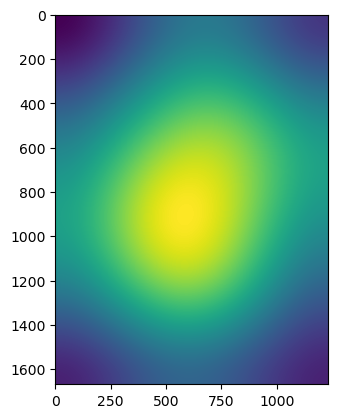

In [ ]:
plt.imshow(blur_bg)

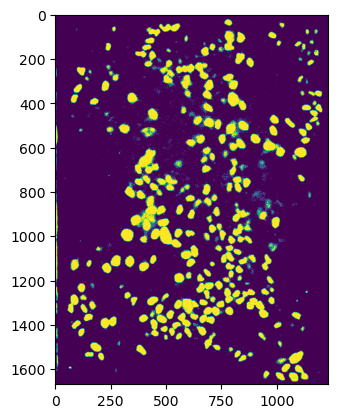

In [ ]:
plt.imshow(preprocessing.normalize_FUCCI_fluorescence(img_subtracted)>0.3)

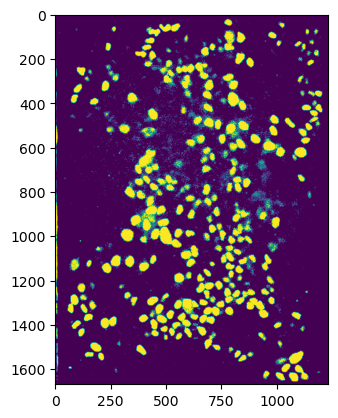

In [ ]:
plt.imshow(preprocessing.normalize_FUCCI_fluorescence(img_subtracted)>0.3) 

In [ ]:
preprocessing.normalize(frame.FUCCI).shape

(2, 1669, 1234)

In [ ]:
img, bg = preprocessing.subtract_background(frame.FUCCI[1], gaussian_sigma=100)

In [ ]:
img=preprocessing.normalize_FUCCI_fluorescence(frame.FUCCI[1]-bg)

c:\Users\Andy\OneDrive - The University of Chicago\UChicago\Gardel Lab\jupyter\preprocessing.py:104: RuntimeWarning: divide by zero encountered in log
  return percent_fluorescent


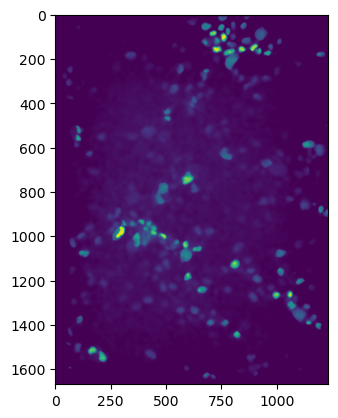

In [ ]:
plt.imshow(preprocessing.normalize_FUCCI_fluorescence(frame.FUCCI[1]))

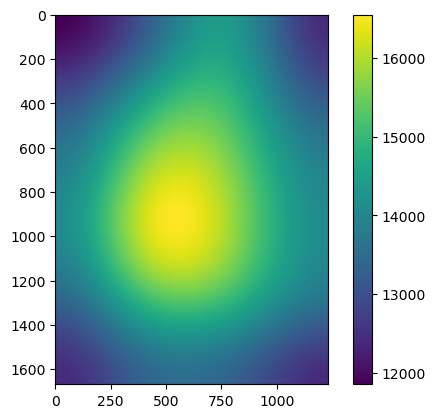

In [ ]:
plt.imshow(preprocessing.subtract_background(frame.FUCCI[1])[1])
plt.colorbar()

In [ ]:
img=frame.FUCCI[1]-bg
img-=img.min()

0.0

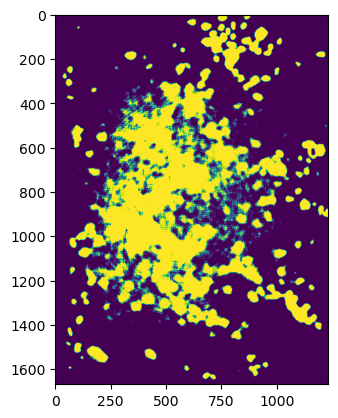

In [ ]:
plt.imshow(preprocessing.normalize_FUCCI_fluorescence(frame.FUCCI[1])>0.4)

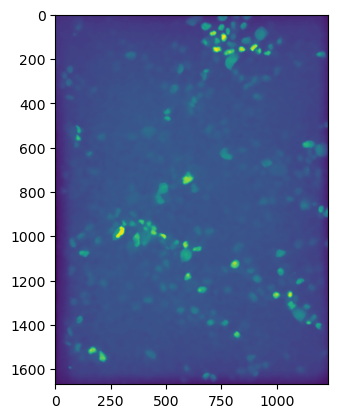

In [ ]:
plt.imshow(frame.FUCCI[1])

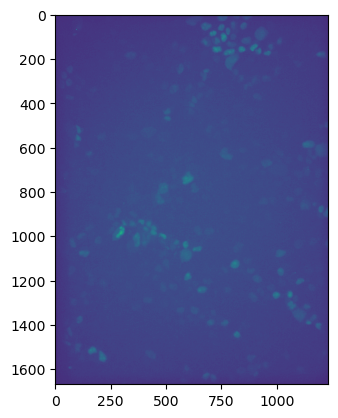

In [ ]:
frame.load_img(normalize=False)
plt.imshow(frame.img[...,1], vmax=500)

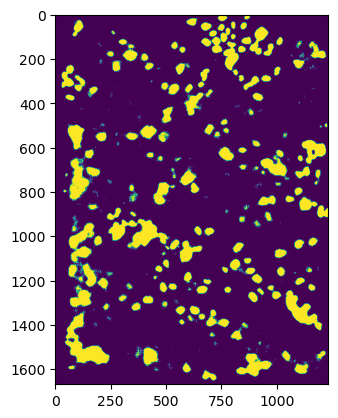

In [ ]:
plt.imshow(preprocessing.normalize_FUCCI_fluorescence(img)>0.4)

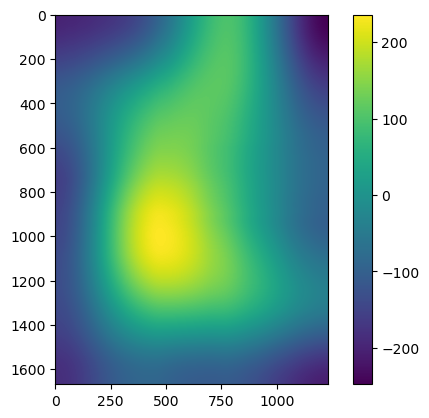

In [ ]:
plt.imshow(preprocessing.subtract_background(frame.FUCCI[1]-bg)[1])
plt.colorbar()